# Regression Analysis

In [241]:
import pandas as pd
import numpy as np
import altair as alt
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

## Customer data

In [242]:
customer_df = pd.read_csv('final/customers.csv', sep='|')

In [243]:
customer_df.head()

,ssn,cc_num,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,acct_num
0,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787
1,715-55-5575,4351161559407816183,Elaine,Fuller,F,310 Kendra Common Apt. 164,Leland,NC,28451,34.2680,-78.0578,27112,Professor Emeritus,1963-06-07,917558277935
2,167-48-5821,4192832764832,Michael,Cameron,M,05641 Robin Port,Cordova,SC,29039,33.4275,-80.8857,4215,International aid/development worker,1973-05-30,718172762479
3,406-83-7518,4238849696532874,Brandon,Williams,M,26916 Carlson Mountain,Birmingham,AL,35242,33.3813,-86.7046,493806,Seismic interpreter,1942-12-26,947268892251
4,697-93-1877,4514627048281480,Lisa,Hernandez,F,809 Burns Creek,Fargo,GA,31631,30.7166,-82.5801,559,Medical laboratory scientific officer,1939-05-22,888335239225


In [244]:
customer_df['acct_num'].nunique()

1000

In [245]:
customer_df.shape

(1000, 15)

In [246]:
customer_df.columns

Index(['ssn', 'cc_num', 'first', 'last', 'gender', 'street', 'city', 'state',
       'zip', 'lat', 'long', 'city_pop', 'job', 'dob', 'acct_num'],
      dtype='object')

## Transaction data

In [247]:
import os

directory = './final'
dfs = []

for filename in os.listdir(directory):
    if filename.startswith('transactions'):
        print(f'Reading {filename}...')
        filepath = os.path.join(directory, filename)
        df = pd.read_csv(filepath, sep='|')
        dfs.append(df)
    else:
        print(f'{filename} is not a CSV file. Skipping...')

if len(dfs) > 0:
    transaction_df = pd.concat(dfs, ignore_index=True)
    print(f'Successfully merged {len(dfs)} dataframes into one.')
else:
    print('No CSV files found in directory.')


Reading transactions_12.csv...
Reading transactions_126.csv...
Reading transactions_127.csv...
Reading transactions_13.csv...
customers.csv is not a CSV file. Skipping...
Reading transactions_39.csv...
Reading transactions_11.csv...
Reading transactions_119.csv...
Reading transactions_131.csv...
Reading transactions_125.csv...
Reading transactions_124.csv...
Reading transactions_130.csv...
Reading transactions_118.csv...
Reading transactions_10.csv...
Reading transactions_38.csv...
Reading transactions_14.csv...
Reading transactions_28.csv...
Reading transactions_120.csv...
Reading transactions_108.csv...
Reading transactions_109.csv...
Reading transactions_121.csv...
Reading transactions_29.csv...
Reading transactions_15.csv...
Reading transactions_17.csv...
Reading transactions_123.csv...
Reading transactions_122.csv...
Reading transactions_16.csv...
Reading transactions_59.csv...
Reading transactions_65.csv...
Reading transactions_71.csv...
Reading transactions_7.csv...
Reading tran

In [248]:
transaction_df.head()

,cc_num,acct_num,trans_num,unix_time,category,amt,is_fraud,merchant,merch_lat,merch_long
0,4896331812335761701,149852234418,f3ec0819590302134f03ffdc2f44697f,1646060228,gas_transport,65.17,0,"Larson, Ryan and Huang",38.143430,-90.327335
1,4896331812335761701,149852234418,c1607c993e41f2c3b42d72d1506bef7b,1644848624,gas_transport,47.58,0,Myers-Reed,39.119498,-90.760379
2,4896331812335761701,149852234418,6f530db25d20fe351249a54491fd3fde,1645632153,gas_transport,64.43,0,Baker-Bullock,39.384368,-90.361517
3,4896331812335761701,149852234418,6d11805f2acd938fec99376001afafe8,1645311286,gas_transport,82.47,0,Spencer-Hall,39.443567,-89.752400
4,4896331812335761701,149852234418,605342f297c575cb1ccf2c08cad082ee,1641571926,gas_transport,50.28,0,"King, Rodriguez and Hancock",38.857278,-89.609525


In [249]:
transaction_df.shape

(4260904, 10)

In [250]:
transaction_df.columns

Index(['cc_num', 'acct_num', 'trans_num', 'unix_time', 'category', 'amt',
       'is_fraud', 'merchant', 'merch_lat', 'merch_long'],
      dtype='object')

In [251]:
transaction_df['acct_num'].nunique()

983

There were 1,000 unique cusomters in customer_df, while there were 983 unique customers in transaction_df

In [252]:
df = customer_df.merge(transaction_df, on=['cc_num', 'acct_num'])

In [253]:
df.head()

,ssn,cc_num,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,acct_num,trans_num,unix_time,category,amt,is_fraud,merchant,merch_lat,merch_long
0,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,91ab12e73ef38206e1121e9648d2408d,1558719550,gas_transport,69.12,0,Phillips Group,39.491416,-75.588522
1,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,071553d533a6822a4431c354c434ddcb,1569425519,grocery_pos,68.11,0,Tucker Ltd,40.890319,-75.573359
2,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,0cfad38ef15e4749eff68dc83f62c151,1577205601,misc_net,40.35,0,Dixon PLC,39.244958,-74.475327
3,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,5782693d7c70f062f258cb30bfa8900f,1571428238,grocery_pos,96.22,0,Lambert-Cooper,39.656925,-75.802342
4,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,35fd7db657d7e30dd608c37f7798186e,1549840400,gas_transport,71.89,0,Griffith LLC,40.313342,-74.220434


In [254]:
df['acct_num'].nunique()

983

In [255]:
df.shape

(4260904, 23)

In [256]:
df.columns

Index(['ssn', 'cc_num', 'first', 'last', 'gender', 'street', 'city', 'state',
       'zip', 'lat', 'long', 'city_pop', 'job', 'dob', 'acct_num', 'trans_num',
       'unix_time', 'category', 'amt', 'is_fraud', 'merchant', 'merch_lat',
       'merch_long'],
      dtype='object')

In [257]:
df.isna().sum()

ssn           0
cc_num        0
first         0
last          0
gender        0
street        0
city          0
state         0
zip           0
lat           0
long          0
city_pop      0
job           0
dob           0
acct_num      0
trans_num     0
unix_time     0
category      0
amt           0
is_fraud      0
merchant      0
merch_lat     0
merch_long    0
dtype: int64

In [258]:
df.duplicated().sum()

0

In [259]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4260904 entries, 0 to 4260903
Data columns (total 23 columns):
 #   Column      Dtype  
---  ------      -----  
 0   ssn         object 
 1   cc_num      object 
 2   first       object 
 3   last        object 
 4   gender      object 
 5   street      object 
 6   city        object 
 7   state       object 
 8   zip         int64  
 9   lat         float64
 10  long        float64
 11  city_pop    int64  
 12  job         object 
 13  dob         object 
 14  acct_num    object 
 15  trans_num   object 
 16  unix_time   object 
 17  category    object 
 18  amt         float64
 19  is_fraud    object 
 20  merchant    object 
 21  merch_lat   float64
 22  merch_long  float64
dtypes: float64(5), int64(2), object(16)
memory usage: 780.2+ MB


## Data Dictionary
- cc_num: The credit card number used in the transaction
- first: The first name of credit card holder
- last: The last name of credit card holder
- gender: The gender of the credit card holder
- street: The street address of the credit card holder
- city: The city of the credit card holder
- state: The state of the credit card holder
- zip: The zip code of the credit card holder
- lat: The latitude of the credit card holder
- long: The longitude of the credit card holder
- city_pop: The population of the city where the customer live
- job: The occupation of the credit card holder
- dob: The date of birth of the credit card holder
- acct_num: The account number of the credit card holder
- trans_num: The transaction number of the credit card holder
- unix_time: The transaction time in Unix time
- amt: The transaction amount
- is_fraud: Whether the transaction is fraudulent (1) or not (0)
- merchant: The merchant where the transaction took place
- merch_lat: The latitude of merchant
- merch_long: The longitude of merchant

In [260]:
df['unix_time'].nunique()

4114752

In [261]:
df_cleaned = df.copy()

In the data preparation stage for regression analysis, we will undertake specific steps to ensure the dataset is appropriately prepared for the business case of predicting the next month’s spending. The following actions will be performed:

Conversion of Unix Time: The Unix Time values will be transformed into a more interpretable format called ‘trasn_month_year’. This conversion will provide the transaction month and year information, allowing us to analyze trends over time and establishes a chronological framework for predicting future spending.

Age Calculations: By utilizing the date of birth information (‘dob’), we will be able to calculate the age of each customer. Age can be a relevant factor affecting spending behaviour, and we will categorize the age variables into seven bins: <18, 18-24, 25-34, 35-44, 45-54, 55-64, and 65+, which will enable us to evaluate the impact of age on future transactions predictions.

Filtering out Fraudulent Transactions: To ensure the accuracy and reliability of our regression analysis, we will filter out fraudulent transactions from the dataset. By excluding the fraudulent transactions, we focus solely on the legitimate customers' spending patterns, which are crucial for predicting the next month’s spending.

Grouping and Aggregating Data: The dataset will be grouped by the 'trans_month_year' variable to examine monthly spending patterns. Transaction data will be aggregated by calculating the sum, mean, maximum, minimum, and count of transactions for each month. Additionally, the transaction data will be flattened to include separate columns for the total and number of transactions in each month. These aggregated statistics will provide valuable insights into customer spending behaviour over time and facilitate accurate predictions for the next month's spending.

Inclusion of Customer Demographics: To enrich the dataset, we will incorporate customer demographics such as gender, age, job, city, and age_grouped. These variables will provide additional insight into the factor that influence spending behaviour and enhance the accuracy of our regression model.

In [262]:
df_cleaned['dob'] = pd.to_datetime(df_cleaned['dob'])

### Convert unix_time to trans_month_year, and quarter

In [263]:
df_cleaned['trans_date_time'] = pd.to_datetime(df_cleaned['unix_time'], unit='s')

In [264]:
df_cleaned['trans_month_year'] = pd.to_datetime(df_cleaned['trans_date_time']).dt.to_period('M')
df_cleaned['quarter'] = pd.to_datetime(df_cleaned['trans_date_time']).dt.to_period('Q')

In [265]:
df_cleaned['first_trans_month_year'] = df_cleaned.groupby('acct_num')['trans_month_year'].transform('min')
df_cleaned['first_trans_month_year'] = df_cleaned['first_trans_month_year'].dt.to_timestamp()
age = ((df_cleaned['first_trans_month_year'] - df_cleaned['dob']).dt.days / 365.25).apply(round)
df_cleaned['age'] = age

In [266]:
df_cleaned.head()

,ssn,cc_num,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,acct_num,trans_num,unix_time,category,amt,is_fraud,merchant,merch_lat,merch_long,trans_date_time,trans_month_year,quarter,first_trans_month_year,age
0,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,91ab12e73ef38206e1121e9648d2408d,1558719550,gas_transport,69.12,0,Phillips Group,39.491416,-75.588522,2019-05-24 17:39:10,2019-05,2019Q2,2018-12-01,59
1,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,071553d533a6822a4431c354c434ddcb,1569425519,grocery_pos,68.11,0,Tucker Ltd,40.890319,-75.573359,2019-09-25 15:31:59,2019-09,2019Q3,2018-12-01,59
2,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,0cfad38ef15e4749eff68dc83f62c151,1577205601,misc_net,40.35,0,Dixon PLC,39.244958,-74.475327,2019-12-24 16:40:01,2019-12,2019Q4,2018-12-01,59
3,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,5782693d7c70f062f258cb30bfa8900f,1571428238,grocery_pos,96.22,0,Lambert-Cooper,39.656925,-75.802342,2019-10-18 19:50:38,2019-10,2019Q4,2018-12-01,59
4,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,35fd7db657d7e30dd608c37f7798186e,1549840400,gas_transport,71.89,0,Griffith LLC,40.313342,-74.220434,2019-02-10 23:13:20,2019-02,2019Q1,2018-12-01,59


In [267]:
import seaborn as sns
import matplotlib.pyplot as plt
palette='ch:.25'

In [268]:
pred_trans_df = df_cleaned.copy()

There are 14 unique category

In [269]:
pred_trans_df['category'].nunique()

14

There are 939 unique zip code

In [270]:
pred_trans_df['zip'].nunique()

939

There are 726 unique city

In [271]:
pred_trans_df['city'].nunique()

726

There are 51 unique state

In [272]:
pred_trans_df['state'].nunique()

51

There are 505 unique job

In [273]:
pred_trans_df['job'].nunique()

505

### We will filter only is_fraud = 0, since we don't want to have any frualent transaction

In [274]:
pred_trans_df = pred_trans_df[pred_trans_df['is_fraud'] == 0]

In [275]:
pred_trans_df.shape

(4255870, 28)

In [276]:
pred_trans_df.columns

Index(['ssn', 'cc_num', 'first', 'last', 'gender', 'street', 'city', 'state',
       'zip', 'lat', 'long', 'city_pop', 'job', 'dob', 'acct_num', 'trans_num',
       'unix_time', 'category', 'amt', 'is_fraud', 'merchant', 'merch_lat',
       'merch_long', 'trans_date_time', 'trans_month_year', 'quarter',
       'first_trans_month_year', 'age'],
      dtype='object')

In [277]:
pred_trans_df.head()

,ssn,cc_num,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,acct_num,trans_num,unix_time,category,amt,is_fraud,merchant,merch_lat,merch_long,trans_date_time,trans_month_year,quarter,first_trans_month_year,age
0,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,91ab12e73ef38206e1121e9648d2408d,1558719550,gas_transport,69.12,0,Phillips Group,39.491416,-75.588522,2019-05-24 17:39:10,2019-05,2019Q2,2018-12-01,59
1,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,071553d533a6822a4431c354c434ddcb,1569425519,grocery_pos,68.11,0,Tucker Ltd,40.890319,-75.573359,2019-09-25 15:31:59,2019-09,2019Q3,2018-12-01,59
2,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,0cfad38ef15e4749eff68dc83f62c151,1577205601,misc_net,40.35,0,Dixon PLC,39.244958,-74.475327,2019-12-24 16:40:01,2019-12,2019Q4,2018-12-01,59
3,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,5782693d7c70f062f258cb30bfa8900f,1571428238,grocery_pos,96.22,0,Lambert-Cooper,39.656925,-75.802342,2019-10-18 19:50:38,2019-10,2019Q4,2018-12-01,59
4,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,35fd7db657d7e30dd608c37f7798186e,1549840400,gas_transport,71.89,0,Griffith LLC,40.313342,-74.220434,2019-02-10 23:13:20,2019-02,2019Q1,2018-12-01,59


In [278]:
pred_trans_df['month'] = pred_trans_df['trans_month_year'].dt.month
pred_trans_df['year'] = pred_trans_df['trans_month_year'].dt.year

## Monthly Spending

In [279]:
monthly_spending = pred_trans_df.groupby(['year', 'month']).agg({'amt': ['sum', 'mean', 'max', 'min'],
                                                                 'trans_num': 'count'}).reset_index()
monthly_spending.columns = ['year', 'month', 'total_amt', 'mean_amt', 'max_amt', 'min_amt', 'trans_count']

In [280]:
monthly_spending.tail()

,year,month,total_amt,mean_amt,max_amt,min_amt,trans_count
44,2022,8,9810985.07,63.096803,24583.86,1.0,155491
45,2022,9,7837465.56,62.719293,16460.30,1.0,124961
46,2022,10,8217907.95,62.749845,25159.92,1.0,130963
47,2022,11,8046118.86,64.152884,23235.32,1.0,125421
48,2022,12,16418548.14,63.093177,23949.46,1.0,260227


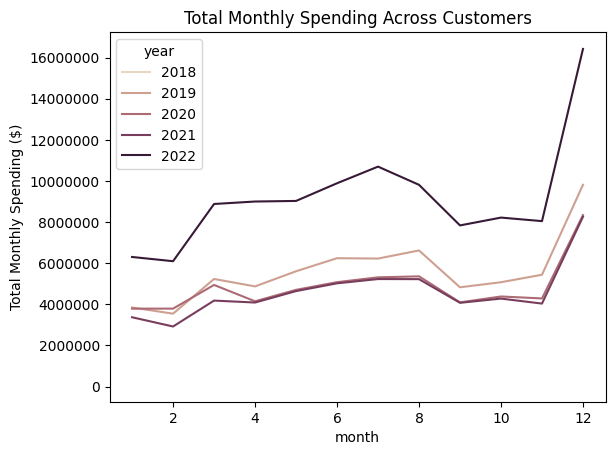

In [281]:
sns.lineplot(data=monthly_spending, x='month', y='total_amt', hue='year', palette=palette)
plt.ylabel('Total Monthly Spending ($)')
plt.ticklabel_format(style='plain', axis='y')
plt.yticks(np.arange(0, 1.8e7, 0.2e7))
plt.title('Total Monthly Spending Across Customers')

plt.show()

It seems to be a seasonal trend of spending. The data shows a yearly cylce of higher spending during the months of November, December, and March. It's also evident that the spending in December is much higher than the other months. There could be many reasons behind, such as holidays, sales, or promotions.

In [282]:
monthly_spending['year_month'] = monthly_spending['year'].astype(str) + '-' + monthly_spending['month'].astype(str)

Text(0.5, 1.0, 'Total Monthly Spending')

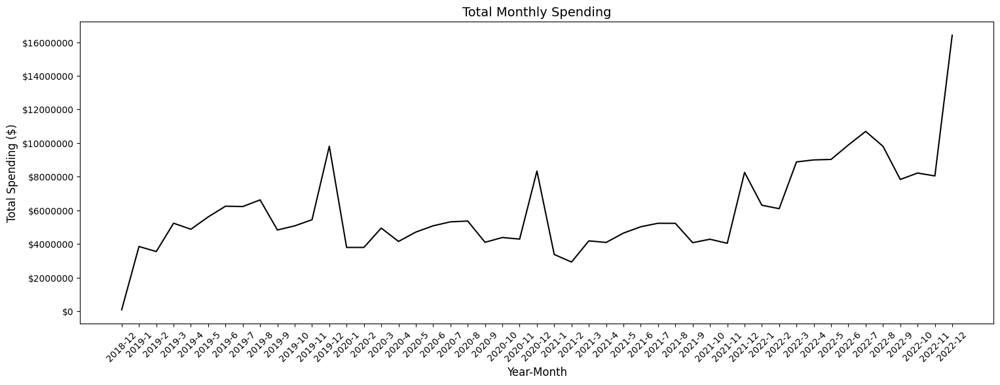

In [283]:
fig, ax = plt.subplots(figsize=(18, 6))

ax.plot(monthly_spending['year_month'], monthly_spending['total_amt'], color='black')
ax.set_xlabel('Year-Month')

ax.set_xlabel('Year-Month', fontsize=12)
ax.tick_params(axis='x', rotation=45)
ax.set_ylabel('Total Spending ($)', fontsize=12)
ax.yaxis.set_major_formatter('${:.0f}'.format)

ax.set_title('Total Monthly Spending', fontsize=14)

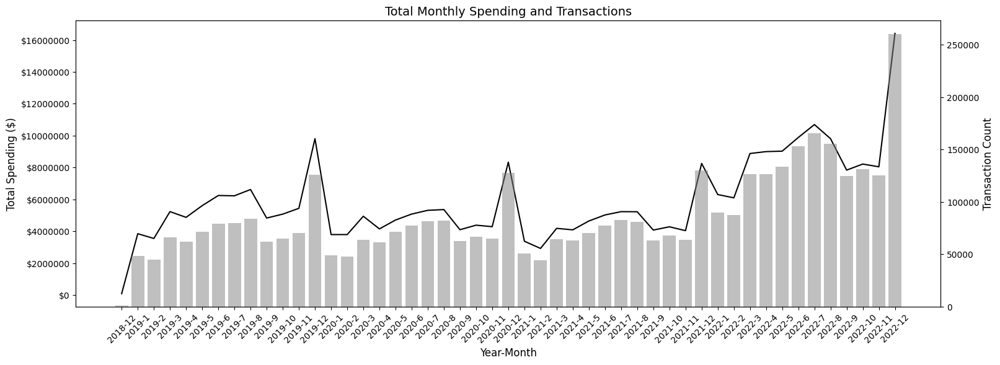

In [284]:
fig, ax = plt.subplots(figsize=(18, 6))
ax2 = ax.twinx()

ax.plot(monthly_spending['year_month'], monthly_spending['total_amt'], color='black')
ax.set_xlabel('Year-Month', fontsize=12)
ax.tick_params(axis='x', rotation=45)
ax.set_ylabel('Total Spending ($)', fontsize=12)
ax.yaxis.set_major_formatter('${:.0f}'.format)
ax.set_title('Total Monthly Spending and Transactions', fontsize=14)

ax2.bar(monthly_spending['year_month'], monthly_spending['trans_count'], color='grey', alpha=0.5)
ax2.set_ylabel('Transaction Count', fontsize=12)

plt.show()

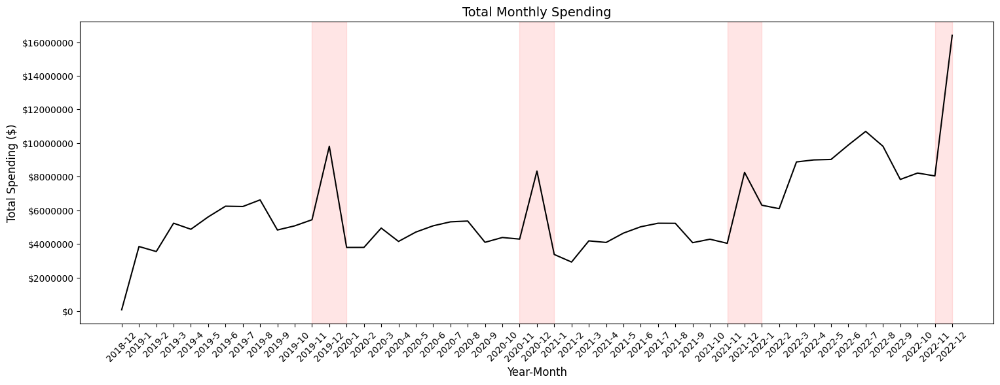

In [285]:
fig, ax = plt.subplots(figsize=(18, 6))

ax.plot(monthly_spending['year_month'], monthly_spending['total_amt'], color='black')

ax.axvspan('2019-11', '2020-1', color='red', alpha=0.1)
ax.axvspan('2020-11', '2021-1', color='red', alpha=0.1)
ax.axvspan('2021-11', '2022-1', color='red', alpha=0.1)
ax.axvspan('2022-11', '2022-12', color='red', alpha=0.1)

ax.set_xlabel('Year-Month', fontsize=12)
ax.tick_params(axis='x', rotation=45)
ax.set_ylabel('Total Spending ($)', fontsize=12)
ax.yaxis.set_major_formatter('${:.0f}'.format)

ax.set_title('Total Monthly Spending', fontsize=14)

plt.show()

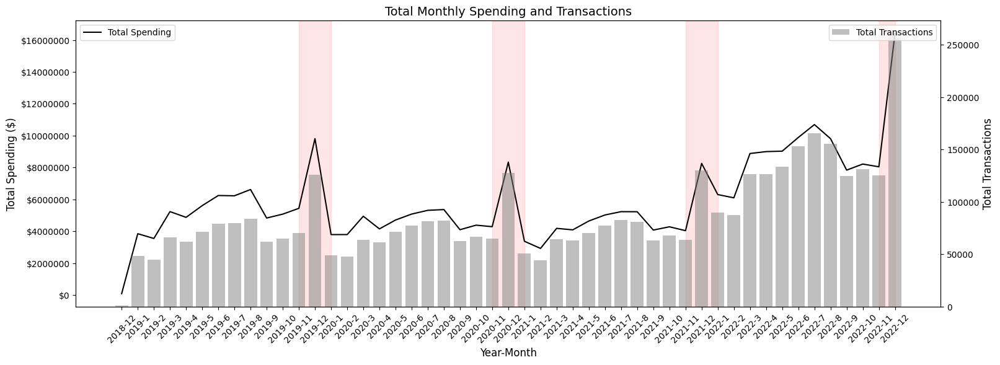

In [286]:
fig, ax = plt.subplots(figsize=(18, 6))

ax.plot(monthly_spending['year_month'], monthly_spending['total_amt'], color='black')

ax2 = ax.twinx()
ax2.bar(monthly_spending['year_month'], monthly_spending['trans_count'], color='grey', alpha=0.5)
ax2.set_ylabel('Total Transactions', fontsize=12)
ax2.yaxis.set_major_formatter('{:.0f}'.format)

ax.axvspan('2019-11', '2020-1', color='red', alpha=0.1)
ax.axvspan('2020-11', '2021-1', color='red', alpha=0.1)
ax.axvspan('2021-11', '2022-1', color='red', alpha=0.1)
ax.axvspan('2022-11', '2022-12', color='red', alpha=0.1)

ax.set_xlabel('Year-Month', fontsize=12)
ax.tick_params(axis='x', rotation=45)
ax.set_ylabel('Total Spending ($)', fontsize=12)
ax.yaxis.set_major_formatter('${:.0f}'.format)

ax.legend(['Total Spending'], loc='upper left')
ax2.legend(['Total Transactions'], loc='upper right')
plt.title('Total Monthly Spending and Transactions', fontsize=14)

plt.show()


### We will group the data by **acct_num**, and **trans_month_year** and find the total amount of spending per month, total number of transaction, and the most frequent category.

In [287]:
total_spent_per_month = pred_trans_df.groupby(['acct_num', 'trans_month_year']).agg({
    'category': lambda x: x.value_counts().idxmax(),
    'age': 'min',
    'gender': 'first',
    'job': 'first',
    'city': 'first',
    'state': 'first',
    'zip': 'first',
    'trans_num': 'count',
    'amt': ['mean', 'max', 'min', 'sum']
}).reset_index()


In [288]:
total_spent_per_month.columns = ['acct_num', 'trans_month_year', 'category', 'age', 'gender', 'job', 'city', 'state', 'zip', 'trans_count', 'mean_amt', 'max_amt', 'min_amt', 'total_amt']

In [289]:
total_spent_per_month.head()

,acct_num,trans_month_year,category,age,gender,job,city,state,zip,trans_count,mean_amt,max_amt,min_amt,total_amt
0,2348758451,2018-12,gas_transport,42,M,"Surveyor, minerals",Rochester,NY,14621,1,96.050000,96.05,96.05,96.05
1,2348758451,2019-01,gas_transport,42,M,"Surveyor, minerals",Rochester,NY,14621,40,78.377750,359.87,5.67,3135.11
2,2348758451,2019-02,gas_transport,42,M,"Surveyor, minerals",Rochester,NY,14621,49,62.837143,245.29,4.41,3079.02
3,2348758451,2019-03,gas_transport,42,M,"Surveyor, minerals",Rochester,NY,14621,57,54.632456,131.91,1.73,3114.05
4,2348758451,2019-04,gas_transport,42,M,"Surveyor, minerals",Rochester,NY,14621,60,69.893500,1183.46,1.27,4193.61


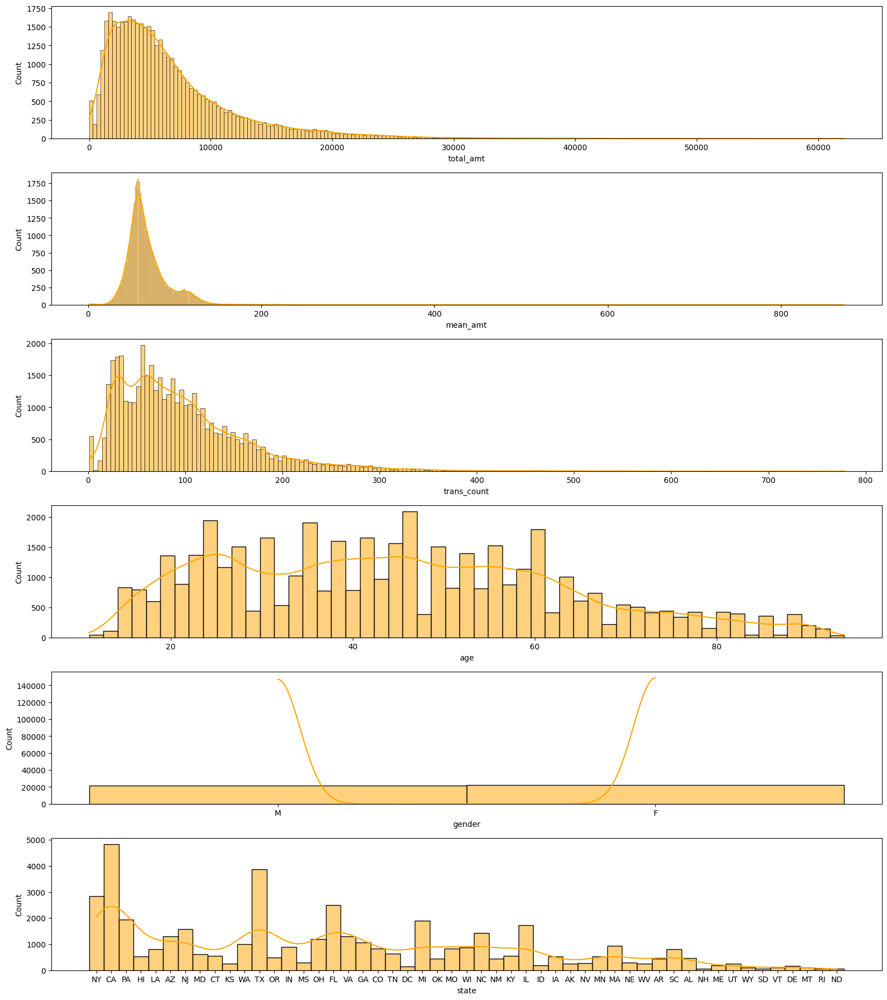

In [290]:
fig, axes = plt.subplots(6, 1, figsize=(16, 18))

for i, c in enumerate(['total_amt', 'mean_amt', 'trans_count', 'age', 'gender', 'state']):
    sns.histplot(data=total_spent_per_month[c], ax=axes[i], kde=True, color='orange')

plt.tight_layout()
plt.show()

In [291]:
customer_summary = pd.pivot_table(total_spent_per_month, 
                                  index=['acct_num'], 
                                  columns=['trans_month_year'], 
                                  values=['trans_count', 'total_amt'],
                                  fill_value=0)

In [292]:
customer_summary_flat = pd.DataFrame(customer_summary.to_records())

customer_summary_flat.columns = [col.replace("('", "").replace("', '", "_").replace("'))", "") 
                                 for col in customer_summary_flat.columns]

In [293]:
customer_summary_flat.head()

,acct_num,"total_amt', Period2018-12_M","total_amt', Period2019-01_M","total_amt', Period2019-02_M","total_amt', Period2019-03_M","total_amt', Period2019-04_M","total_amt', Period2019-05_M","total_amt', Period2019-06_M","total_amt', Period2019-07_M","total_amt', Period2019-08_M","total_amt', Period2019-09_M","total_amt', Period2019-10_M","total_amt', Period2019-11_M","total_amt', Period2019-12_M","total_amt', Period2020-01_M","total_amt', Period2020-02_M","total_amt', Period2020-03_M","total_amt', Period2020-04_M","total_amt', Period2020-05_M","total_amt', Period2020-06_M","total_amt', Period2020-07_M","total_amt', Period2020-08_M","total_amt', Period2020-09_M","total_amt', Period2020-10_M","total_amt', Period2020-11_M","total_amt', Period2020-12_M","total_amt', Period2021-01_M","total_amt', Period2021-02_M","total_amt', Period2021-03_M","total_amt', Period2021-04_M","total_amt', Period2021-05_M","total_amt', Period2021-06_M","total_amt', Period2021-07_M","total_amt', Period2021-08_M","total_amt', Period2021-09_M","total_amt', Period2021-10_M","total_amt', Period2021-11_M","total_amt', Period2021-12_M","total_amt', Period2022-01_M","total_amt', Period2022-02_M","total_amt', Period2022-03_M","total_amt', Period2022-04_M","total_amt', Period2022-05_M","total_amt', Period2022-06_M","total_amt', Period2022-07_M","total_amt', Period2022-08_M","total_amt', Period2022-09_M","total_amt', Period2022-10_M","total_amt', Period2022-11_M","total_amt', Period2022-12_M","trans_count', Period2018-12_M","trans_count', Period2019-01_M","trans_count', Period2019-02_M","trans_count', Period2019-03_M","trans_count', Period2019-04_M","trans_count', Period2019-05_M","trans_count', Period2019-06_M","trans_count', Period2019-07_M","trans_count', Period2019-08_M","trans_count', Period2019-09_M","trans_count', Period2019-10_M","trans_count', Period2019-11_M","trans_count', Period2019-12_M","trans_count', Period2020-01_M","trans_count', Period2020-02_M","trans_count', Period2020-03_M","trans_count', Period2020-04_M","trans_count', Period2020-05_M","trans_count', Period2020-06_M","trans_count', Period2020-07_M","trans_count', Period2020-08_M","trans_count', Period2020-09_M","trans_count', Period2020-10_M","trans_count', Period2020-11_M","trans_count', Period2020-12_M","trans_count', Period2021-01_M","trans_count', Period2021-02_M","trans_count', Period2021-03_M","trans_count', Period2021-04_M","trans_count', Period2021-05_M","trans_count', Period2021-06_M","trans_count', Period2021-07_M","trans_count', Period2021-08_M","trans_count', Period2021-09_M","trans_count', Period2021-10_M","trans_count', Period2021-11_M","trans_count', Period2021-12_M","trans_count', Period2022-01_M","trans_count', Period2022-02_M","trans_count', Period2022-03_M","trans_count', Period2022-04_M","trans_count', Period2022-05_M","trans_count', Period2022-06_M","trans_count', Period2022-07_M","trans_count', Period2022-08_M","trans_count', Period2022-09_M","trans_count', Period2022-10_M","trans_count', Period2022-11_M","trans_count', Period2022-12_M"
0,2348758451,96.05,3135.11,3079.02,3114.05,4193.61,4290.73,3657.02,3765.51,4004.26,2416.59,3962.87,3124.60,6008.22,3077.01,2998.80,3586.09,2436.95,3604.75,4707.65,2372.02,3111.07,6454.39,1679.22,2026.95,6503.73,1753.81,1483.12,4791.39,1432.27,2754.88,2991.87,3684.23,2806.12,2531.25,1559.79,2112.00,5953.41,5345.96,10263.91,14583.42,7094.84,7880.77,7649.20,9317.50,6850.65,6256.74,6588.37,8882.73,13408.74,1,40,49,57,60,75,67,70,68,51,57,45,102,44,53,56,44,54,71,56,66,45,51,50,118,46,34,50,47,50,71,76,62,54,42,51,119,97,104,150,136,144,160,190,159,135,152,127,285
1,2468061102,5.75,4793.59,2950.34,5128.18,5516.67,5324.35,7142.46,6812.52,6650.47,4145.92,5302.92,6493.92,11419.12,4553.61,3378.39,3979.67,5257.87,6132.76,6587.81,5275.80,5193.65,6320.92,4682.45,4766.77,9564.12,3048.51,2648.57,5633.02,7646.09,5595.21,4295.62,6773.62,4391.10,3689.29,4440.16,4611.52,10070.20,7917.40,5189.47,11352.79,9277.44,9837.36,13240.34,12826.66,11121.19,10107.50,1

In [294]:
customer_summary_flat = customer_summary_flat.rename(columns={"total_amt', Period2022-12_M": "Target"})

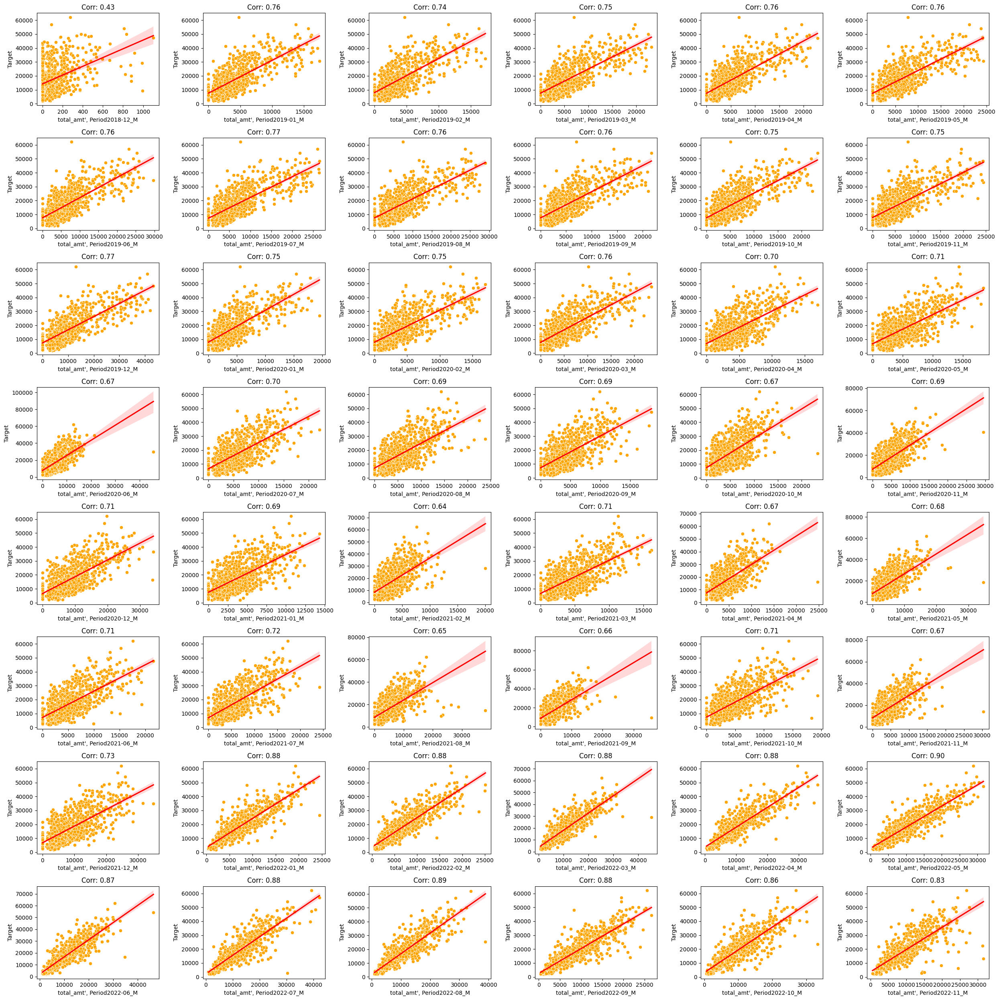

In [295]:
fig, axes = plt.subplots(8, 6, figsize=(25, 25))
axes = [ax for axes_row in axes for ax in axes_row]

for i, c in enumerate(customer_summary_flat.loc[:, "total_amt', Period2018-12_M":"total_amt', Period2022-11_M"]):
    sns.scatterplot(y="Target", x=c, data=customer_summary_flat, ax=axes[i], color='orange')
    sns.regplot(y="Target", x=c, data=customer_summary_flat, ax=axes[i], scatter=False, color='red')
    corr = customer_summary_flat['Target'].corr(customer_summary_flat[c])
    axes[i].set_title('Corr: {:.2f}'.format(corr), fontsize=12)

plt.tight_layout()
plt.show()

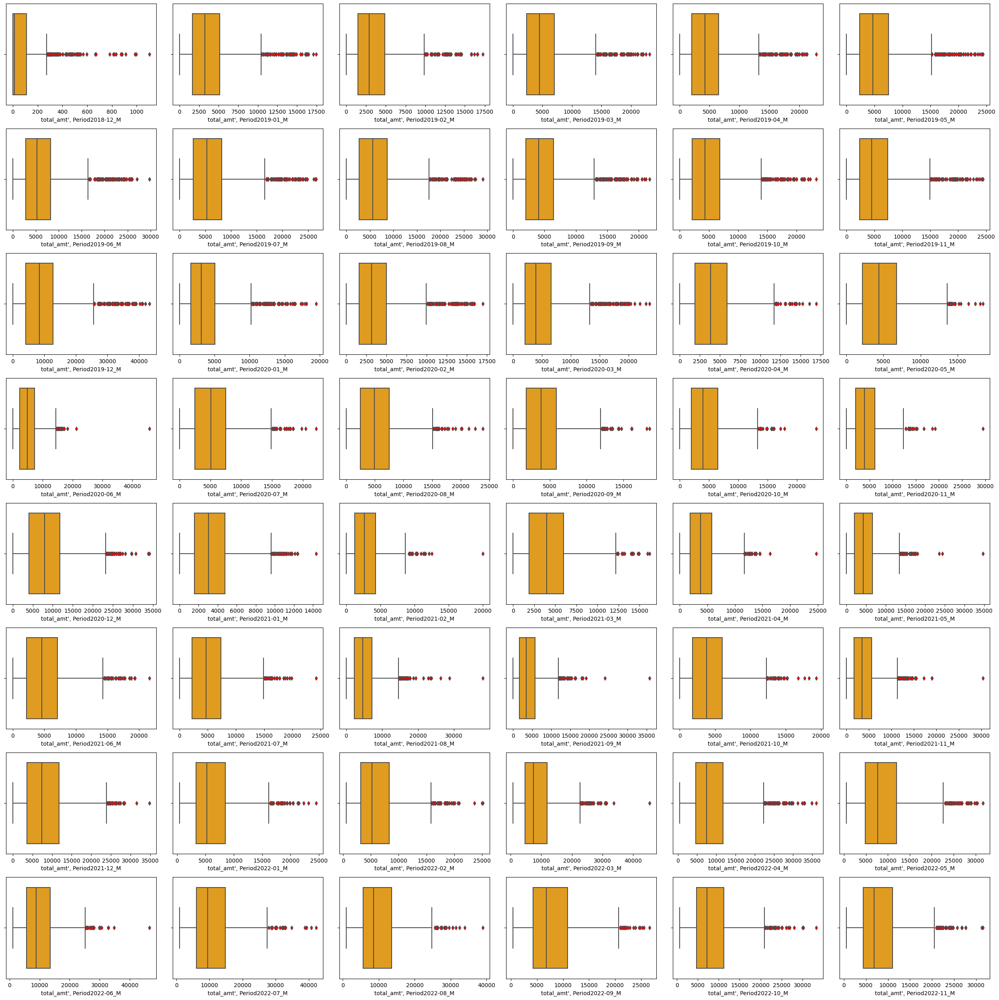

In [296]:
fig, axes = plt.subplots(8, 6, figsize=(25, 25))
axes = [ax for axes_row in axes for ax in axes_row]

for i, c in enumerate(customer_summary_flat.loc[:, "total_amt', Period2018-12_M":"total_amt', Period2022-11_M"]):
    sns.boxplot(x=c, data=customer_summary_flat, ax=axes[i], color='orange', flierprops=dict(markerfacecolor='red'))
    
plt.tight_layout()
plt.show()

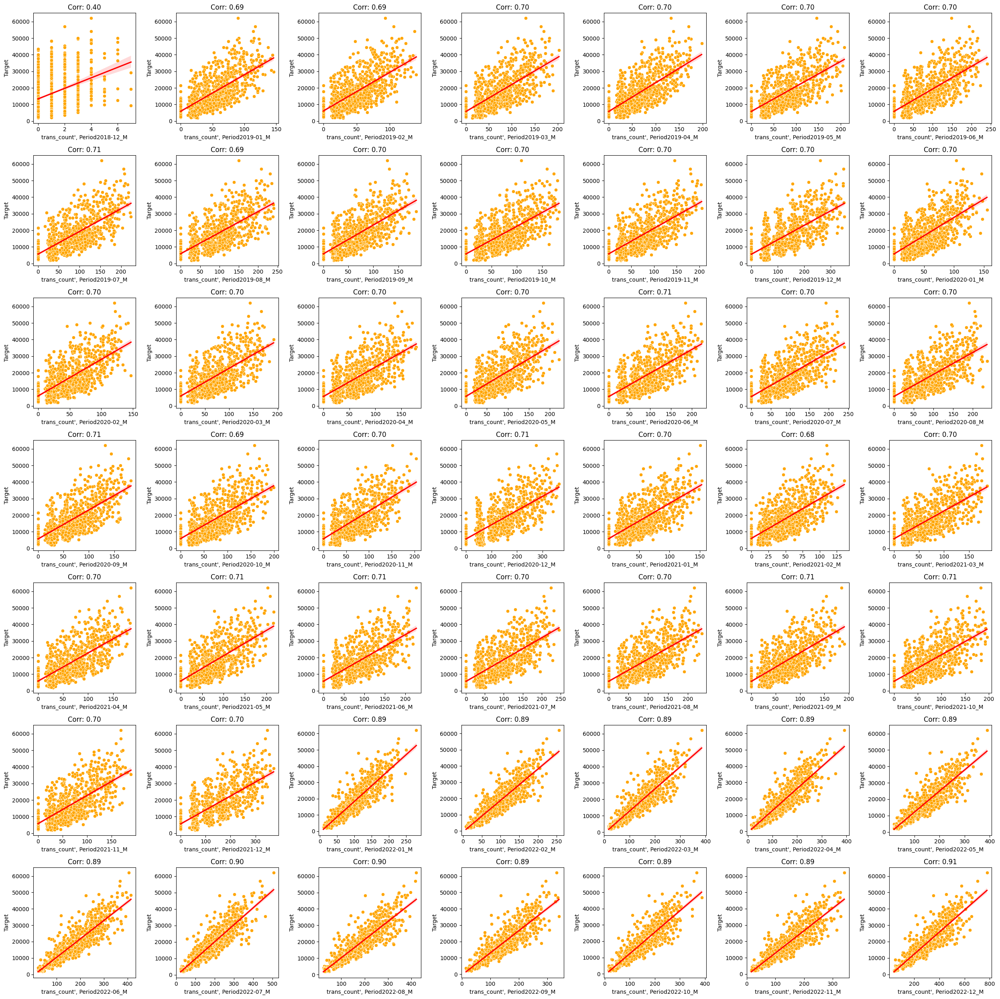

In [297]:
fig, axes = plt.subplots(7, 7, figsize=(25, 25))
axes = [ax for axes_row in axes for ax in axes_row]

for i, c in enumerate(customer_summary_flat.loc[:, "trans_count', Period2018-12_M":"trans_count', Period2022-12_M"]):
    sns.scatterplot(y="Target", x=c, data=customer_summary_flat, ax=axes[i], color='orange')
    sns.regplot(y="Target", x=c, data=customer_summary_flat, ax=axes[i], scatter=False, color='red')
    corr = customer_summary_flat['Target'].corr(customer_summary_flat[c])
    axes[i].set_title('Corr: {:.2f}'.format(corr), fontsize=12)

plt.tight_layout()
plt.show()

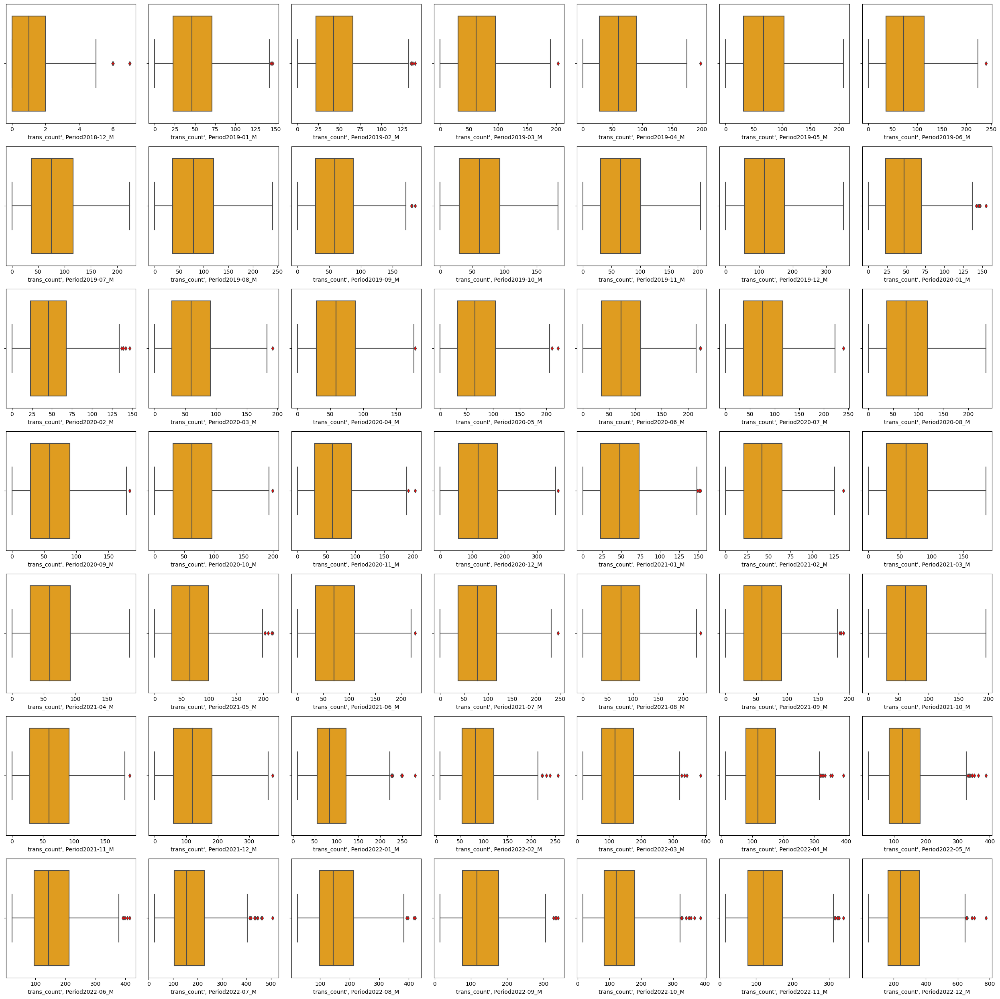

In [298]:
fig, axes = plt.subplots(7, 7, figsize=(25, 25))
axes = [ax for axes_row in axes for ax in axes_row]

for i, c in enumerate(customer_summary_flat.loc[:, "trans_count', Period2018-12_M":"trans_count', Period2022-12_M"]):
    sns.boxplot(x=c, data=customer_summary_flat, ax=axes[i], color='orange', flierprops=dict(markerfacecolor='red'))

plt.tight_layout()
plt.show()

In [299]:
customer_demographics = pred_trans_df[['acct_num', 'gender', 'age', 'job', 'city']]

In [300]:
trans_df = pd.merge(customer_summary_flat, customer_demographics, on='acct_num')

In [301]:
trans_df.drop_duplicates(inplace=True)

In [302]:
trans_df.reset_index(drop=True, inplace=True)

In [303]:
bins = [0, 18, 24, 34, 44, 54, 64, 200]
labels = ['<18', '18-24', '25-34', '35-44', '45-54', '55-64', '65+']

In [304]:
trans_df['age_group'] = pd.cut(trans_df['age'], bins=bins, labels=labels)

In [305]:
target_index = trans_df.columns.get_loc("Target")

cols = list(trans_df.columns)
cols.append(cols.pop(target_index))
trans_df = trans_df[cols]

In [306]:
trans_df.head()

,acct_num,"total_amt', Period2018-12_M","total_amt', Period2019-01_M","total_amt', Period2019-02_M","total_amt', Period2019-03_M","total_amt', Period2019-04_M","total_amt', Period2019-05_M","total_amt', Period2019-06_M","total_amt', Period2019-07_M","total_amt', Period2019-08_M","total_amt', Period2019-09_M","total_amt', Period2019-10_M","total_amt', Period2019-11_M","total_amt', Period2019-12_M","total_amt', Period2020-01_M","total_amt', Period2020-02_M","total_amt', Period2020-03_M","total_amt', Period2020-04_M","total_amt', Period2020-05_M","total_amt', Period2020-06_M","total_amt', Period2020-07_M","total_amt', Period2020-08_M","total_amt', Period2020-09_M","total_amt', Period2020-10_M","total_amt', Period2020-11_M","total_amt', Period2020-12_M","total_amt', Period2021-01_M","total_amt', Period2021-02_M","total_amt', Period2021-03_M","total_amt', Period2021-04_M","total_amt', Period2021-05_M","total_amt', Period2021-06_M","total_amt', Period2021-07_M","total_amt', Period2021-08_M","total_amt', Period2021-09_M","total_amt', Period2021-10_M","total_amt', Period2021-11_M","total_amt', Period2021-12_M","total_amt', Period2022-01_M","total_amt', Period2022-02_M","total_amt', Period2022-03_M","total_amt', Period2022-04_M","total_amt', Period2022-05_M","total_amt', Period2022-06_M","total_amt', Period2022-07_M","total_amt', Period2022-08_M","total_amt', Period2022-09_M","total_amt', Period2022-10_M","total_amt', Period2022-11_M","trans_count', Period2018-12_M","trans_count', Period2019-01_M","trans_count', Period2019-02_M","trans_count', Period2019-03_M","trans_count', Period2019-04_M","trans_count', Period2019-05_M","trans_count', Period2019-06_M","trans_count', Period2019-07_M","trans_count', Period2019-08_M","trans_count', Period2019-09_M","trans_count', Period2019-10_M","trans_count', Period2019-11_M","trans_count', Period2019-12_M","trans_count', Period2020-01_M","trans_count', Period2020-02_M","trans_count', Period2020-03_M","trans_count', Period2020-04_M","trans_count', Period2020-05_M","trans_count', Period2020-06_M","trans_count', Period2020-07_M","trans_count', Period2020-08_M","trans_count', Period2020-09_M","trans_count', Period2020-10_M","trans_count', Period2020-11_M","trans_count', Period2020-12_M","trans_count', Period2021-01_M","trans_count', Period2021-02_M","trans_count', Period2021-03_M","trans_count', Period2021-04_M","trans_count', Period2021-05_M","trans_count', Period2021-06_M","trans_count', Period2021-07_M","trans_count', Period2021-08_M","trans_count', Period2021-09_M","trans_count', Period2021-10_M","trans_count', Period2021-11_M","trans_count', Period2021-12_M","trans_count', Period2022-01_M","trans_count', Period2022-02_M","trans_count', Period2022-03_M","trans_count', Period2022-04_M","trans_count', Period2022-05_M","trans_count', Period2022-06_M","trans_count', Period2022-07_M","trans_count', Period2022-08_M","trans_count', Period2022-09_M","trans_count', Period2022-10_M","trans_count', Period2022-11_M","trans_count', Period2022-12_M",gender,age,job,city,age_group,Target
0,2348758451,96.05,3135.11,3079.02,3114.05,4193.61,4290.73,3657.02,3765.51,4004.26,2416.59,3962.87,3124.60,6008.22,3077.01,2998.80,3586.09,2436.95,3604.75,4707.65,2372.02,3111.07,6454.39,1679.22,2026.95,6503.73,1753.81,1483.12,4791.39,1432.27,2754.88,2991.87,3684.23,2806.12,2531.25,1559.79,2112.00,5953.41,5345.96,10263.91,14583.42,7094.84,7880.77,7649.20,9317.50,6850.65,6256.74,6588.37,8882.73,1,40,49,57,60,75,67,70,68,51,57,45,102,44,53,56,44,54,71,56,66,45,51,50,118,46,34,50,47,50,71,76,62,54,42,51,119,97,104,150,136,144,160,190,159,135,152,127,285,M,42,"Surveyor, minerals",Rochester,35-44,13408.74
1,2468061102,5.75,4793.59,2950.34,5128.18,5516.67,5324.35,7142.46,6812.52,6650.47,4145.92,5302.92,6493.92,11419.12,4553.61,3378.39,3979.67,5257.87,6132.76,6587.81,5275.80,5193.65,6320.92,4682.45,4766.77,9564.12,3048.51,2648.57,5633.02,7646.09,5595.21,4295.62,6773.62,4391.10,3689.29,4440.16,4611.52,10070.20,7917.40,5189.47,11352.79,9277

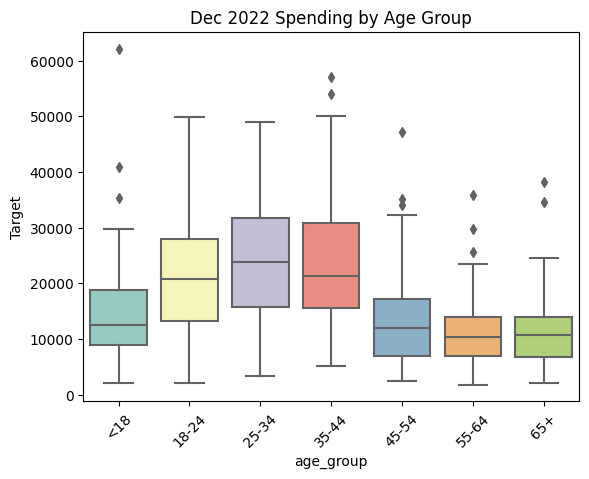

In [307]:
sns.boxplot(x='age_group', y='Target', data=trans_df, palette='Set3')
plt.title('Dec 2022 Spending by Age Group')
plt.xticks(rotation=45)
plt.show()

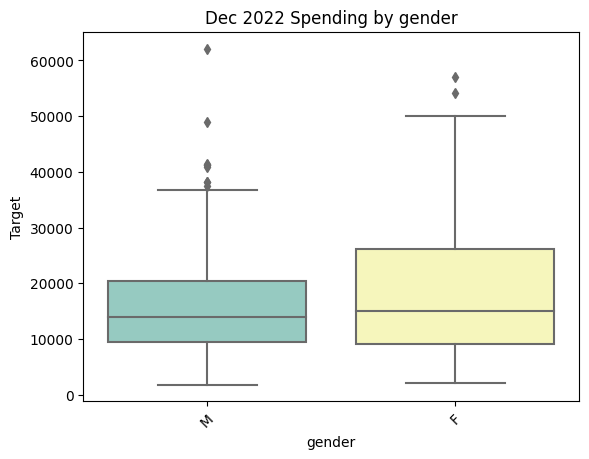

In [308]:
sns.boxplot(x='gender', y='Target', data=trans_df, palette='Set3')
plt.title('Dec 2022 Spending by gender')
plt.xticks(rotation=45)
plt.show()

In [309]:
dec2022 = total_spent_per_month[total_spent_per_month['trans_month_year'] == '2022-12']

In [310]:
dec2022.head()

,acct_num,trans_month_year,category,age,gender,job,city,state,zip,trans_count,mean_amt,max_amt,min_amt,total_amt
48,2348758451,2022-12,travel,42,M,"Surveyor, minerals",Rochester,NY,14621,285,47.048211,1562.15,1.10,13408.74
97,2468061102,2022-12,travel,60,F,"Nurse, adult",Oceanside,CA,92057,310,61.225613,1748.31,1.02,18979.94
146,3005591724,2022-12,travel,73,F,"Engineer, automotive",Lancaster,PA,17601,208,55.259808,384.94,1.05,11494.04
194,3418322859,2022-12,travel,17,F,Operational investment banker,Mountain View,CA,94040,286,56.277762,1928.42,1.01,16095.44
242,4322238535,2022-12,travel,88,M,Catering manager,Honolulu,HI,96816,120,61.369250,245.56,1.10,7364.31


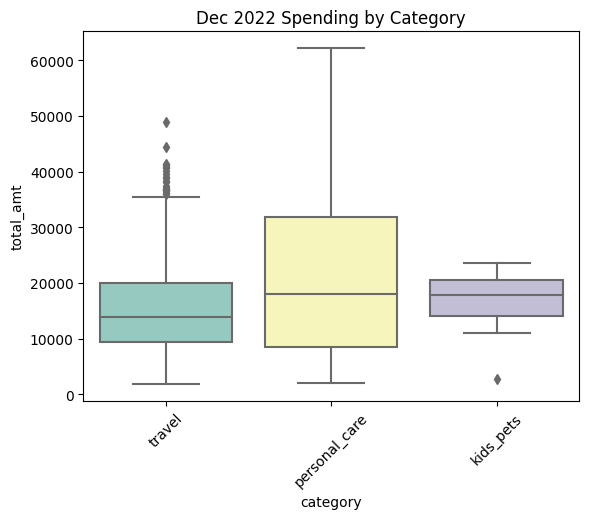

In [311]:
sns.boxplot(x='category', y='total_amt', data=dec2022, palette='Set3')
plt.title('Dec 2022 Spending by Category')
plt.xticks(rotation=45)
plt.show()

In [312]:
dec_2022 = pred_trans_df[pred_trans_df['trans_month_year'] == '2022-12']

In [313]:
pred_trans_df.head()

,ssn,cc_num,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,acct_num,trans_num,unix_time,category,amt,is_fraud,merchant,merch_lat,merch_long,trans_date_time,trans_month_year,quarter,first_trans_month_year,age,month,year
0,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,91ab12e73ef38206e1121e9648d2408d,1558719550,gas_transport,69.12,0,Phillips Group,39.491416,-75.588522,2019-05-24 17:39:10,2019-05,2019Q2,2018-12-01,59,5,2019
1,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,071553d533a6822a4431c354c434ddcb,1569425519,grocery_pos,68.11,0,Tucker Ltd,40.890319,-75.573359,2019-09-25 15:31:59,2019-09,2019Q3,2018-12-01,59,9,2019
2,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,0cfad38ef15e4749eff68dc83f62c151,1577205601,misc_net,40.35,0,Dixon PLC,39.244958,-74.475327,2019-12-24 16:40:01,2019-12,2019Q4,2018-12-01,59,12,2019
3,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,5782693d7c70f062f258cb30bfa8900f,1571428238,grocery_pos,96.22,0,Lambert-Cooper,39.656925,-75.802342,2019-10-18 19:50:38,2019-10,2019Q4,2018-12-01,59,10,2019
4,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787,35fd7db657d7e30dd608c37f7798186e,1549840400,gas_transport,71.89,0,Griffith LLC,40.313342,-74.220434,2019-02-10 23:13:20,2019-02,2019Q1,2018-12-01,59,2,2019


In [314]:
trans_df.shape

(972, 104)

### Correlation Plot

/var/folders/lk/qbgh0syd1l7_7h6ghvq233nr0000gn/T/ipykernel_92512/3535905867.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = trans_df.corr()


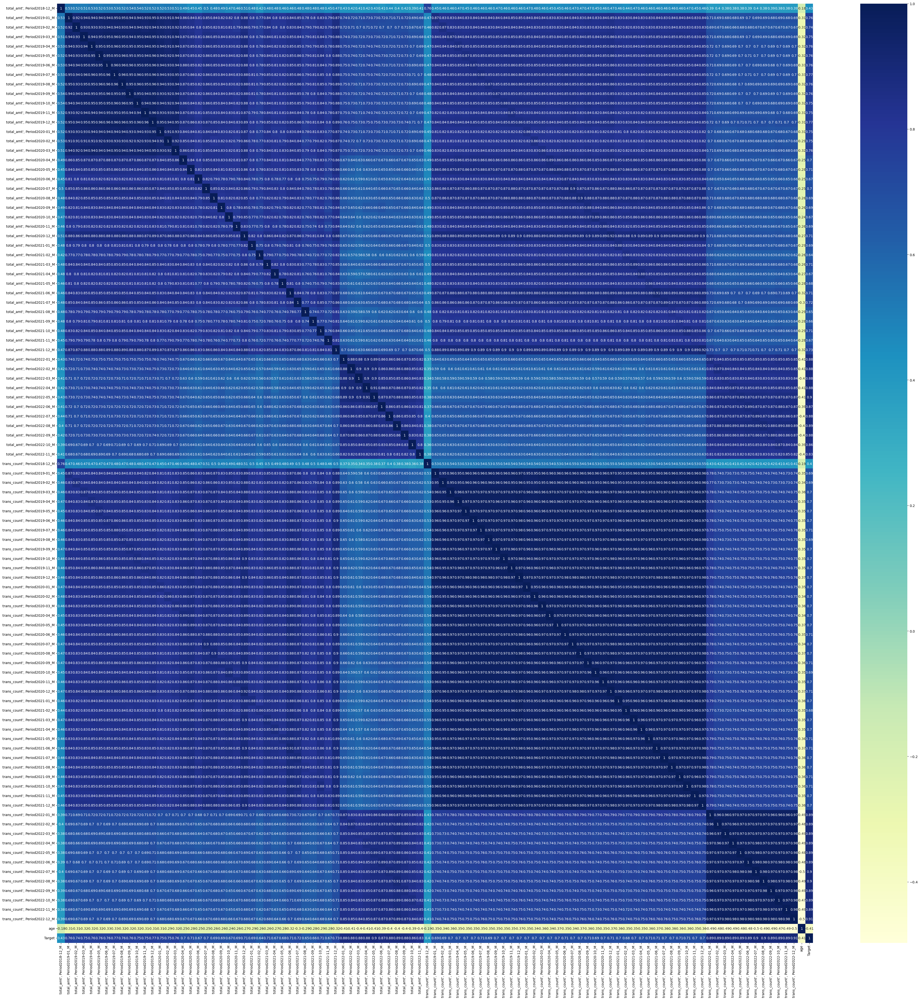

In [315]:
correlation = trans_df.corr()

plt.figure(figsize=(50, 50))
sns.heatmap(correlation, annot=True, cmap='YlGnBu')

plt.show()

In [316]:
correlation

,"total_amt', Period2018-12_M","total_amt', Period2019-01_M","total_amt', Period2019-02_M","total_amt', Period2019-03_M","total_amt', Period2019-04_M","total_amt', Period2019-05_M","total_amt', Period2019-06_M","total_amt', Period2019-07_M","total_amt', Period2019-08_M","total_amt', Period2019-09_M","total_amt', Period2019-10_M","total_amt', Period2019-11_M","total_amt', Period2019-12_M","total_amt', Period2020-01_M","total_amt', Period2020-02_M","total_amt', Period2020-03_M","total_amt', Period2020-04_M","total_amt', Period2020-05_M","total_amt', Period2020-06_M","total_amt', Period2020-07_M","total_amt', Period2020-08_M","total_amt', Period2020-09_M","total_amt', Period2020-10_M","total_amt', Period2020-11_M","total_amt', Period2020-12_M","total_amt', Period2021-01_M","total_amt', Period2021-02_M","total_amt', Period2021-03_M","total_amt', Period2021-04_M","total_amt', Period2021-05_M","total_amt', Period2021-06_M","total_amt', Period2021-07_M","total_amt', Period2021-08_M","total_amt', Period2021-09_M","total_amt', Period2021-10_M","total_amt', Period2021-11_M","total_amt', Period2021-12_M","total_amt', Period2022-01_M","total_amt', Period2022-02_M","total_amt', Period2022-03_M","total_amt', Period2022-04_M","total_amt', Period2022-05_M","total_amt', Period2022-06_M","total_amt', Period2022-07_M","total_amt', Period2022-08_M","total_amt', Period2022-09_M","total_amt', Period2022-10_M","total_amt', Period2022-11_M","trans_count', Period2018-12_M","trans_count', Period2019-01_M","trans_count', Period2019-02_M","trans_count', Period2019-03_M","trans_count', Period2019-04_M","trans_count', Period2019-05_M","trans_count', Period2019-06_M","trans_count', Period2019-07_M","trans_count', Period2019-08_M","trans_count', Period2019-09_M","trans_count', Period2019-10_M","trans_count', Period2019-11_M","trans_count', Period2019-12_M","trans_count', Period2020-01_M","trans_count', Period2020-02_M","trans_count', Period2020-03_M","trans_count', Period2020-04_M","trans_count', Period2020-05_M","trans_count', Period2020-06_M","trans_count', Period2020-07_M","trans_count', Period2020-08_M","trans_count', Period2020-09_M","trans_count', Period2020-10_M","trans_count', Period2020-11_M","trans_count', Period2020-12_M","trans_count', Period2021-01_M","trans_count', Period2021-02_M","trans_count', Period2021-03_M","trans_count', Period2021-04_M","trans_count', Period2021-05_M","trans_count', Period2021-06_M","trans_count', Period2021-07_M","trans_count', Period2021-08_M","trans_count', Period2021-09_M","trans_count', Period2021-10_M","trans_count', Period2021-11_M","trans_count', Period2021-12_M","trans_count', Period2022-01_M","trans_count', Period2022-02_M","trans_count', Period2022-03_M","trans_count', Period2022-04_M","trans_count', Period2022-05_M","trans_count', Period2022-06_M","trans_count', Period2022-07_M","trans_count', Period2022-08_M","trans_count', Period2022-09_M","trans_count', Period2022-10_M","trans_count', Period2022-11_M","trans_count', Period2022-12_M",age,Target
"total_amt', Period2018-12_M",1.000000,0.532484,0.522456,0.511195,0.530995,0.517475,0.529913,0.530591,0.521404,0.539699,0.535104,0.520855,0.523571,0.515719,0.529609,0.513539,0.485701,0.446822,0.445354,0.501977,0.477245,0.486197,0.466752,0.458473,0.505537,0.475332,0.415254,0.482738,0.477579,0.460709,0.461116,0.478910,0.475206,0.483292,0.476297,0.446306,0.471941,0.425631,0.423659,0.413413,0.420878,0.433582,0.408367,0.437908,0.399066,0.419300,0.393458,0.405663,0.758131,0.452343,0.462406,0.458912,0.468279,0.454956,0.462828,0.464256,0.456326,0.470820,0.459396,0.458764,0.461434,0.470286,0.475649,0.457420,0.453956,0.449220,0.464791,0.470284,0.468283,0.471719,0.454737,0.459383,0.472859,0.462823,0.441932,0.469830,0.460774,0.456129,0.464774,0.463455,0.463294,0.458722,0.466350,0.446187,0.463210,0.391451,0.396722,0.382438,0.384457,0.380524,0.390909,0.401394,0.383796,0.388190,0.382005,0.384506,0.386503,-0.183845,0.434274
"total_amt', Period2019-01_M",0.532484,1.000000,0.916214,0

### Splitting the Data

In [317]:
from sklearn.model_selection import train_test_split

data_df, test_df = train_test_split(trans_df, test_size=0.25, random_state=42)

train_df, val_df = train_test_split(data_df, test_size=0.25, random_state=42)

### Peform One-hot Encoding and Frequency Encoding

### One-hot Encoding

In [318]:
from sklearn.preprocessing import OneHotEncoder

#### - gender

In [319]:
train_gender = train_df['gender'].values.reshape(-1, 1)
val_gender = val_df['gender'].values.reshape(-1, 1)
test_gender = test_df['gender'].values.reshape(-1, 1)

In [320]:
encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')
encoder.fit(train_gender)

/opt/homebrew/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


OneHotEncoder(handle_unknown='ignore', sparse=False, sparse_output=False)

In [321]:
train_gender_encoded = encoder.transform(train_gender)
val_gender_encoded = encoder.transform(val_gender)
test_gender_encoded = encoder.transform(test_gender)

In [322]:
train_encoded = pd.DataFrame(train_gender_encoded, columns=encoder.get_feature_names_out(['gender']), index=train_df.index)
val_encoded = pd.DataFrame(val_gender_encoded, columns=encoder.get_feature_names_out(['gender']), index=val_df.index)
test_encoded = pd.DataFrame(test_gender_encoded, columns=encoder.get_feature_names_out(['gender']), index=test_df.index)

In [323]:
train_df = pd.concat([train_df.drop('gender', axis=1), train_encoded], axis=1)
val_df = pd.concat([val_df.drop('gender', axis=1), val_encoded], axis=1)
test_df = pd.concat([test_df.drop('gender', axis=1), test_encoded], axis=1)

In [324]:
train_df.head()

,acct_num,"total_amt', Period2018-12_M","total_amt', Period2019-01_M","total_amt', Period2019-02_M","total_amt', Period2019-03_M","total_amt', Period2019-04_M","total_amt', Period2019-05_M","total_amt', Period2019-06_M","total_amt', Period2019-07_M","total_amt', Period2019-08_M","total_amt', Period2019-09_M","total_amt', Period2019-10_M","total_amt', Period2019-11_M","total_amt', Period2019-12_M","total_amt', Period2020-01_M","total_amt', Period2020-02_M","total_amt', Period2020-03_M","total_amt', Period2020-04_M","total_amt', Period2020-05_M","total_amt', Period2020-06_M","total_amt', Period2020-07_M","total_amt', Period2020-08_M","total_amt', Period2020-09_M","total_amt', Period2020-10_M","total_amt', Period2020-11_M","total_amt', Period2020-12_M","total_amt', Period2021-01_M","total_amt', Period2021-02_M","total_amt', Period2021-03_M","total_amt', Period2021-04_M","total_amt', Period2021-05_M","total_amt', Period2021-06_M","total_amt', Period2021-07_M","total_amt', Period2021-08_M","total_amt', Period2021-09_M","total_amt', Period2021-10_M","total_amt', Period2021-11_M","total_amt', Period2021-12_M","total_amt', Period2022-01_M","total_amt', Period2022-02_M","total_amt', Period2022-03_M","total_amt', Period2022-04_M","total_amt', Period2022-05_M","total_amt', Period2022-06_M","total_amt', Period2022-07_M","total_amt', Period2022-08_M","total_amt', Period2022-09_M","total_amt', Period2022-10_M","total_amt', Period2022-11_M","trans_count', Period2018-12_M","trans_count', Period2019-01_M","trans_count', Period2019-02_M","trans_count', Period2019-03_M","trans_count', Period2019-04_M","trans_count', Period2019-05_M","trans_count', Period2019-06_M","trans_count', Period2019-07_M","trans_count', Period2019-08_M","trans_count', Period2019-09_M","trans_count', Period2019-10_M","trans_count', Period2019-11_M","trans_count', Period2019-12_M","trans_count', Period2020-01_M","trans_count', Period2020-02_M","trans_count', Period2020-03_M","trans_count', Period2020-04_M","trans_count', Period2020-05_M","trans_count', Period2020-06_M","trans_count', Period2020-07_M","trans_count', Period2020-08_M","trans_count', Period2020-09_M","trans_count', Period2020-10_M","trans_count', Period2020-11_M","trans_count', Period2020-12_M","trans_count', Period2021-01_M","trans_count', Period2021-02_M","trans_count', Period2021-03_M","trans_count', Period2021-04_M","trans_count', Period2021-05_M","trans_count', Period2021-06_M","trans_count', Period2021-07_M","trans_count', Period2021-08_M","trans_count', Period2021-09_M","trans_count', Period2021-10_M","trans_count', Period2021-11_M","trans_count', Period2021-12_M","trans_count', Period2022-01_M","trans_count', Period2022-02_M","trans_count', Period2022-03_M","trans_count', Period2022-04_M","trans_count', Period2022-05_M","trans_count', Period2022-06_M","trans_count', Period2022-07_M","trans_count', Period2022-08_M","trans_count', Period2022-09_M","trans_count', Period2022-10_M","trans_count', Period2022-11_M","trans_count', Period2022-12_M",age,job,city,age_group,Target,gender_F,gender_M
775,804015362037,0.00,3123.45,3105.97,5041.83,4733.73,5936.18,6003.54,6051.26,6367.30,4736.08,5356.48,3346.69,7675.86,6310.53,1377.63,3287.53,2139.62,3903.18,3003.03,4367.25,5236.80,6016.03,3291.25,4962.00,8367.57,2246.67,2179.63,5037.71,4771.50,4452.99,4557.49,3782.78,4488.08,6007.86,4082.10,6886.50,8889.13,3602.92,1668.74,2884.05,2848.66,2693.22,10212.05,2734.09,3644.57,2627.50,3793.83,2611.68,0,51,55,90,85,98,100,103,114,82,94,83,174,51,59,93,70,95,95,94,125,81,78,83,163,60,55,86,86,88,87,106,108,69,77,83,174,78,52,73,81,98,87,108,107,73,81,67,180,17,"Social research officer, government",Alexandria,<18,9043.66,0.0,1.0
387,393298413208,835.23,13984.16,13072.89,22517.81,18581.44,19171.91,24378.44,23321.76,23096.50,16874.02,22011.31,21538.35,36467.39,13150.15,15694.78,19229.05,14852.31,14146.26,10714.28,17610.24,13843.86,11823.63,17891.55,11184.49,28122.69,8620.69,9220.63,11166.28,12700.94,13819.21,13263.25,15326.90,1645

### Frequency Encoding

In [325]:
frequency_map = {}

- job

In [326]:
job_frequency = train_df['job'].value_counts(normalize=True)

train_df['job_frequency'] = train_df['job'].map(job_frequency)
val_df['job_frequency'] = val_df['job'].map(job_frequency)
test_df['job_frequency'] = test_df['job'].map(job_frequency)

In [327]:
val_df['job_frequency'].fillna(val_df['job_frequency'].mean(), inplace=True)
test_df['job_frequency'].fillna(val_df['job_frequency'].mean(), inplace=True)

- city

In [328]:
city_frequency = train_df['city'].value_counts(normalize=True)

train_df['city_frequency'] = train_df['city'].map(city_frequency)
val_df['city_frequency'] = val_df['city'].map(city_frequency)
test_df['city_frequency'] = test_df['city'].map(city_frequency)

In [329]:
val_df['city_frequency'].fillna(val_df['city_frequency'].mean(), inplace=True)
test_df['city_frequency'].fillna(val_df['city_frequency'].mean(), inplace=True)

- age

In [330]:
age_group_mapping = {
    '<18': 1,
    '18-24': 2,
    '25-34': 3,
    '35-44': 4,
    '45-54': 5,
    '55-64': 6,
    '65+': 7
}

In [331]:
train_df['age_group_encoded'] = train_df['age_group'].map(age_group_mapping)
val_df['age_group_encoded'] = val_df['age_group'].map(age_group_mapping)
test_df['age_group_encoded'] = test_df['age_group'].map(age_group_mapping)

In [332]:
train_df.drop(['age', 'age_group','job', 'city'], axis=1, inplace=True)
val_df.drop(['age', 'age_group', 'job', 'city'], axis=1, inplace=True)
test_df.drop(['age', 'age_group', 'job', 'city'], axis=1, inplace=True)

In [333]:
train_df.head()

,acct_num,"total_amt', Period2018-12_M","total_amt', Period2019-01_M","total_amt', Period2019-02_M","total_amt', Period2019-03_M","total_amt', Period2019-04_M","total_amt', Period2019-05_M","total_amt', Period2019-06_M","total_amt', Period2019-07_M","total_amt', Period2019-08_M","total_amt', Period2019-09_M","total_amt', Period2019-10_M","total_amt', Period2019-11_M","total_amt', Period2019-12_M","total_amt', Period2020-01_M","total_amt', Period2020-02_M","total_amt', Period2020-03_M","total_amt', Period2020-04_M","total_amt', Period2020-05_M","total_amt', Period2020-06_M","total_amt', Period2020-07_M","total_amt', Period2020-08_M","total_amt', Period2020-09_M","total_amt', Period2020-10_M","total_amt', Period2020-11_M","total_amt', Period2020-12_M","total_amt', Period2021-01_M","total_amt', Period2021-02_M","total_amt', Period2021-03_M","total_amt', Period2021-04_M","total_amt', Period2021-05_M","total_amt', Period2021-06_M","total_amt', Period2021-07_M","total_amt', Period2021-08_M","total_amt', Period2021-09_M","total_amt', Period2021-10_M","total_amt', Period2021-11_M","total_amt', Period2021-12_M","total_amt', Period2022-01_M","total_amt', Period2022-02_M","total_amt', Period2022-03_M","total_amt', Period2022-04_M","total_amt', Period2022-05_M","total_amt', Period2022-06_M","total_amt', Period2022-07_M","total_amt', Period2022-08_M","total_amt', Period2022-09_M","total_amt', Period2022-10_M","total_amt', Period2022-11_M","trans_count', Period2018-12_M","trans_count', Period2019-01_M","trans_count', Period2019-02_M","trans_count', Period2019-03_M","trans_count', Period2019-04_M","trans_count', Period2019-05_M","trans_count', Period2019-06_M","trans_count', Period2019-07_M","trans_count', Period2019-08_M","trans_count', Period2019-09_M","trans_count', Period2019-10_M","trans_count', Period2019-11_M","trans_count', Period2019-12_M","trans_count', Period2020-01_M","trans_count', Period2020-02_M","trans_count', Period2020-03_M","trans_count', Period2020-04_M","trans_count', Period2020-05_M","trans_count', Period2020-06_M","trans_count', Period2020-07_M","trans_count', Period2020-08_M","trans_count', Period2020-09_M","trans_count', Period2020-10_M","trans_count', Period2020-11_M","trans_count', Period2020-12_M","trans_count', Period2021-01_M","trans_count', Period2021-02_M","trans_count', Period2021-03_M","trans_count', Period2021-04_M","trans_count', Period2021-05_M","trans_count', Period2021-06_M","trans_count', Period2021-07_M","trans_count', Period2021-08_M","trans_count', Period2021-09_M","trans_count', Period2021-10_M","trans_count', Period2021-11_M","trans_count', Period2021-12_M","trans_count', Period2022-01_M","trans_count', Period2022-02_M","trans_count', Period2022-03_M","trans_count', Period2022-04_M","trans_count', Period2022-05_M","trans_count', Period2022-06_M","trans_count', Period2022-07_M","trans_count', Period2022-08_M","trans_count', Period2022-09_M","trans_count', Period2022-10_M","trans_count', Period2022-11_M","trans_count', Period2022-12_M",Target,gender_F,gender_M,job_frequency,city_frequency,age_group_encoded
775,804015362037,0.00,3123.45,3105.97,5041.83,4733.73,5936.18,6003.54,6051.26,6367.30,4736.08,5356.48,3346.69,7675.86,6310.53,1377.63,3287.53,2139.62,3903.18,3003.03,4367.25,5236.80,6016.03,3291.25,4962.00,8367.57,2246.67,2179.63,5037.71,4771.50,4452.99,4557.49,3782.78,4488.08,6007.86,4082.10,6886.50,8889.13,3602.92,1668.74,2884.05,2848.66,2693.22,10212.05,2734.09,3644.57,2627.50,3793.83,2611.68,0,51,55,90,85,98,100,103,114,82,94,83,174,51,59,93,70,95,95,94,125,81,78,83,163,60,55,86,86,88,87,106,108,69,77,83,174,78,52,73,81,98,87,108,107,73,81,67,180,9043.66,0.0,1.0,0.005495,0.005495,1
387,393298413208,835.23,13984.16,13072.89,22517.81,18581.44,19171.91,24378.44,23321.76,23096.50,16874.02,22011.31,21538.35,36467.39,13150.15,15694.78,19229.05,14852.31,14146.26,10714.28,17610.24,13843.86,11823.63,17891.55,11184.49,28122.69,8620.69,9220.63,11166.28,12700.94,13819.21,13263.25,15326.90,16453.47,12934.4

In [334]:
train_df.isna().sum()

acct_num                         0
total_amt', Period2018-12_M      0
total_amt', Period2019-01_M      0
total_amt', Period2019-02_M      0
total_amt', Period2019-03_M      0
total_amt', Period2019-04_M      0
total_amt', Period2019-05_M      0
total_amt', Period2019-06_M      0
total_amt', Period2019-07_M      0
total_amt', Period2019-08_M      0
total_amt', Period2019-09_M      0
total_amt', Period2019-10_M      0
total_amt', Period2019-11_M      0
total_amt', Period2019-12_M      0
total_amt', Period2020-01_M      0
total_amt', Period2020-02_M      0
total_amt', Period2020-03_M      0
total_amt', Period2020-04_M      0
total_amt', Period2020-05_M      0
total_amt', Period2020-06_M      0
total_amt', Period2020-07_M      0
total_amt', Period2020-08_M      0
total_amt', Period2020-09_M      0
total_amt', Period2020-10_M      0
total_amt', Period2020-11_M      0
total_amt', Period2020-12_M      0
total_amt', Period2021-01_M      0
total_amt', Period2021-02_M      0
total_amt', Period20

In [335]:
val_df.isna().sum()

acct_num                         0
total_amt', Period2018-12_M      0
total_amt', Period2019-01_M      0
total_amt', Period2019-02_M      0
total_amt', Period2019-03_M      0
total_amt', Period2019-04_M      0
total_amt', Period2019-05_M      0
total_amt', Period2019-06_M      0
total_amt', Period2019-07_M      0
total_amt', Period2019-08_M      0
total_amt', Period2019-09_M      0
total_amt', Period2019-10_M      0
total_amt', Period2019-11_M      0
total_amt', Period2019-12_M      0
total_amt', Period2020-01_M      0
total_amt', Period2020-02_M      0
total_amt', Period2020-03_M      0
total_amt', Period2020-04_M      0
total_amt', Period2020-05_M      0
total_amt', Period2020-06_M      0
total_amt', Period2020-07_M      0
total_amt', Period2020-08_M      0
total_amt', Period2020-09_M      0
total_amt', Period2020-10_M      0
total_amt', Period2020-11_M      0
total_amt', Period2020-12_M      0
total_amt', Period2021-01_M      0
total_amt', Period2021-02_M      0
total_amt', Period20

In [336]:
test_df.isna().sum()

acct_num                         0
total_amt', Period2018-12_M      0
total_amt', Period2019-01_M      0
total_amt', Period2019-02_M      0
total_amt', Period2019-03_M      0
total_amt', Period2019-04_M      0
total_amt', Period2019-05_M      0
total_amt', Period2019-06_M      0
total_amt', Period2019-07_M      0
total_amt', Period2019-08_M      0
total_amt', Period2019-09_M      0
total_amt', Period2019-10_M      0
total_amt', Period2019-11_M      0
total_amt', Period2019-12_M      0
total_amt', Period2020-01_M      0
total_amt', Period2020-02_M      0
total_amt', Period2020-03_M      0
total_amt', Period2020-04_M      0
total_amt', Period2020-05_M      0
total_amt', Period2020-06_M      0
total_amt', Period2020-07_M      0
total_amt', Period2020-08_M      0
total_amt', Period2020-09_M      0
total_amt', Period2020-10_M      0
total_amt', Period2020-11_M      0
total_amt', Period2020-12_M      0
total_amt', Period2021-01_M      0
total_amt', Period2021-02_M      0
total_amt', Period20

In [337]:
X_train = train_df.drop(["acct_num", "Target"], axis=1)
y_train = train_df["Target"]

X_val = val_df.drop(["acct_num", "Target"], axis=1)
y_val = val_df["Target"]

X_test = test_df.drop(["acct_num", "Target"], axis=1)
y_test = test_df["Target"]

### Data Standarization (Standard Scalling)

In [338]:
from sklearn.preprocessing import StandardScaler

In [339]:
scaler = StandardScaler()

In [340]:
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)
X_test_scaled = scaler.transform(X_test)

In [341]:
X_train = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_val = pd.DataFrame(X_val_scaled, columns=X_val.columns)
X_test = pd.DataFrame(X_test_scaled, columns=X_test.columns)

## I. Multivariate Linear Regression

In the regression analysis, we developed and evaluated seven models to predict the next month’s spending. These models include:

Baseline: This model serves as a benchmark and is generated using the mean of the predictor variable. It provides a reference point for evaluating the performance of other models.
Multivariate Regression: A linear regression model that considers multiple predictor variables.
Lasso Regression: A linear regression model that applies L1 regularization to the model coefficients, promoting sparsity and feature selection.
Ridge Regression: A linear regression model that applies L2 regularization to the model coefficients, helping to reduce overfitting.
ElasticNet Regression: A linear regression model that combines L1 and L2 regularization techniques, offering a balance between feature selection and model complexity control.
Decision Tree Regressor: A non-linear regression model that uses decision tree algorithms.
Random Forest Regressor: An ensemble learning method that combines multiple decision trees.
Gradient Boosting Regressor: Another ensemble learning method that sequentially trains weak learners (decision trees) to improve model performance.

Before splitting the data, we performed standard scaling on the features to normalize their values and ensure they were on a similar scale. This step was crucial to prevent any particular feature from dominating the model training process. Additionally, we applied one-hot encoding to the ‘gender’ variable and frequency-encoding to the ‘job’ and ‘city’ columns. The ‘age_group’ variable was mapped to an ordinal type ranging from 1 to 7.

We split the data into training, validation, and testing sets to ensure a fair evaluation of the models. The data was divided so that 20% was reserved for testing, while the remaining 80% was split into training (80%) and validation (20%) sets. The performance of each model was evaluated using metrics such as mean absolute error (MAE), mean squared error (MSE), and root mean square error (RMSE) on both the training and validation sets.

Feature selection techniques, including feature engineering, were applied to all models to identify the most relevant predictors (see more details in the appendix). For the ensemble techniques (Decision Tree Regressor, Random Forest Regressor, and Gradient Boosting Regressor), hyperparameter tuning was performed to optimize their performance.

In [342]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error

### Baseline model

#### Baseline Train dataset

In [343]:
y_mean = y_train.mean()
y_base = np.full(y_train.shape, y_mean)

mae = mean_absolute_error(y_train, y_base)
mse = mean_squared_error(y_train, y_base)
rmse = mean_squared_error(y_train, y_base, squared=False)

baseline_train = pd.DataFrame({'mae':mae,
                               'mse':mse,
                               'rmse':rmse}, index=['Baseline_Train'])

In [344]:
baseline_train

,mae,mse,rmse
Baseline_Train,8307.422361,1.105862e+08,10515.995863


#### Baseline Test dataset

In [345]:
y_mean = y_test.mean()
y_base = np.full(y_test.shape, y_mean)

mae = mean_absolute_error(y_base, y_test)
mse = mean_squared_error(y_base, y_test)
rmse = mean_squared_error(y_base, y_test, squared=False)

baseline_test = pd.DataFrame({'mae':mae,
                               'mse':mse,
                               'rmse':rmse}, index=['Baseline_Test'])

In [346]:
baseline_test

,mae,mse,rmse
Baseline_Test,7751.203825,1.000556e+08,10002.777477


### Multilinear Function

In [347]:
def multilinear(X_train, y_train, X_test, y_test, index_train, index_test):    
    reg = LinearRegression()
    reg.fit(X_train, y_train)
    y_preds_train = reg.predict(X_train)
    y_preds_test = reg.predict(X_test)

    mse = mean_squared_error(y_train, y_preds_train)
    mae = mean_absolute_error(y_train, y_preds_train)
    rmse = mean_squared_error(y_train, y_preds_train, squared=False)

    multi_train = pd.DataFrame({'mae': mae,
                           'mse': mse,
                           'rmse': rmse},
                           index=[index_train])
    
    mse = mean_squared_error(y_test, y_preds_test)
    mae = mean_absolute_error(y_test, y_preds_test)
    rmse = mean_squared_error(y_test, y_preds_test, squared=False)

    multi_test = pd.DataFrame({'mae': mae,
                           'mse': mse,
                           'rmse': rmse},
                           index=[index_test])

    multi_models = pd.concat([multi_train, multi_test])
    

    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16,6))

    # Plot the predicted vs actual target values for the training set
    axes[0].plot(y_train, y_preds_train, 'o', color='orange', label='Predictions')
    axes[0].plot(y_train, y_train, '-', color='red', label='Actual')

    axes[0].set_xlabel('Actual')
    axes[0].set_ylabel('Predicted')
    axes[0].set_title(f'{index_train}: Comparison of Actual vs. Predicted Target')

    axes[0].legend()


    axes[1].plot(y_test, y_preds_test, 'o', color='orange', label='Predictions')
    axes[1].plot(y_test, y_test, '-', color='red', label='Actual')

    axes[1].set_xlabel('Actual')
    axes[1].set_ylabel('Predicted')
    axes[1].set_title(f'{index_test}: Comparison of Actual vs. Predicted Target')

    axes[1].legend()
 
    return multi_models

### 1. Multi Linear Regression with All Feature

,mae,mse,rmse
MultiLinear_Train,2079.423872,9.298125e+06,3049.282748
MultiLinear_Val,2267.698408,1.029542e+07,3208.647385


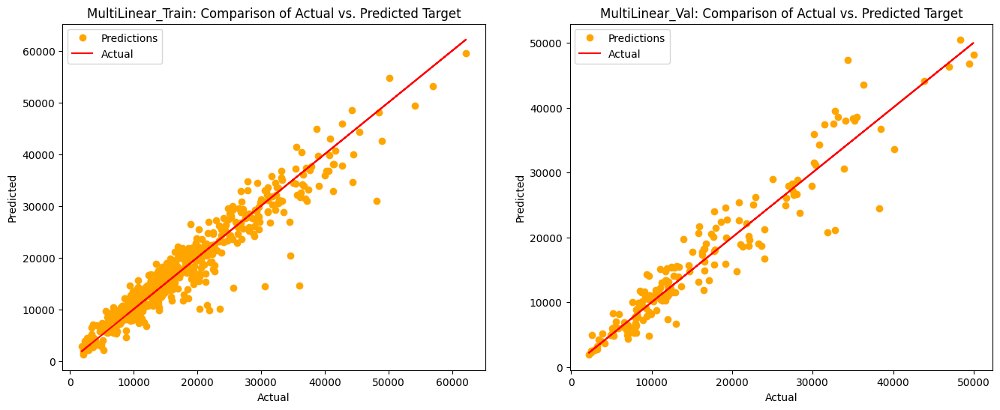

In [348]:
multi = multilinear(X_train, y_train, X_val, y_val, 'MultiLinear_Train', 'MultiLinear_Val')
multi

### 2. Feature Engineering 1 (Correlation >= 0.5)

In [349]:
correlation = {}

for column in trans_df.columns:
    if column not in ['acct_num', 'Target']:
        if trans_df[column].dtype in [np.int64, np.float64]:
            correlation[column] = np.abs(round(trans_df['Target'].corr(trans_df[column]), 2))

In [350]:
sorted_correlation = dict(sorted(correlation.items(), key=lambda x:x[1], reverse=True))

In [351]:
feature_var = []

for key in sorted_correlation.keys():
    if sorted_correlation[key] > 0.5:
        feature_var.append(key)

In [352]:
X_train_feature1 = train_df[feature_var]
X_val_feature1 = val_df[feature_var]
X_test_feature1 = test_df[feature_var]

In [353]:
X_train_feature1_scaled = scaler.fit_transform(X_train_feature1)
X_val_feature1_scaled = scaler.transform(X_val_feature1)
X_test_feature1_scaled = scaler.transform(X_test_feature1)

In [354]:
X_train_feature1 = pd.DataFrame(X_train_feature1_scaled, columns=X_train_feature1.columns)
X_val_feature1 = pd.DataFrame(X_val_feature1_scaled, columns=X_val_feature1.columns)
X_test_feature1 = pd.DataFrame(X_test_feature1_scaled, columns=X_test_feature1.columns)

,mae,mse,rmse
MultiLinear_Feature1_Train,2070.482628,9.344101e+06,3056.812263
MultiLinear_Feature1_Val,2230.827601,1.010146e+07,3178.280116


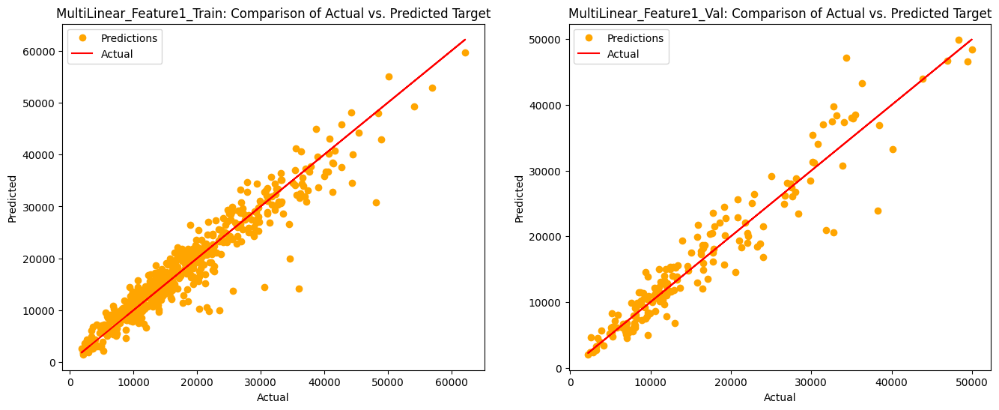

In [355]:
multi_feature1 = multilinear(X_train_feature1, y_train, X_val_feature1, y_val, 'MultiLinear_Feature1_Train', 'MultiLinear_Feature1_Val')
multi_feature1

### 3. Feature Engineering 2 (Correlation >= 0.7)

In [356]:
feature_var = []

for key in sorted_correlation.keys():
    if sorted_correlation[key] > 0.7:
        feature_var.append(key)

In [357]:
X_train_feature2 = train_df[feature_var]
X_val_feature2 = val_df[feature_var]
X_test_feature2 = test_df[feature_var]

In [358]:
X_train_feature2_scaled = scaler.fit_transform(X_train_feature2)
X_val_feature2_scaled = scaler.transform(X_val_feature2)
X_test_feature2_scaled = scaler.transform(X_test_feature2)

In [359]:
X_train_feature2 = pd.DataFrame(X_train_feature2_scaled, columns=X_train_feature2.columns)
X_val_feature2 = pd.DataFrame(X_val_feature2_scaled, columns=X_val_feature2.columns)
X_test_feature2 = pd.DataFrame(X_test_feature2_scaled, columns=X_test_feature2.columns)

,mae,mse,rmse
MultiLinear_Feature2_Train,2093.693198,1.030223e+07,3209.708360
MultiLinear_Feature2_Val,2123.415974,9.319224e+06,3052.740411


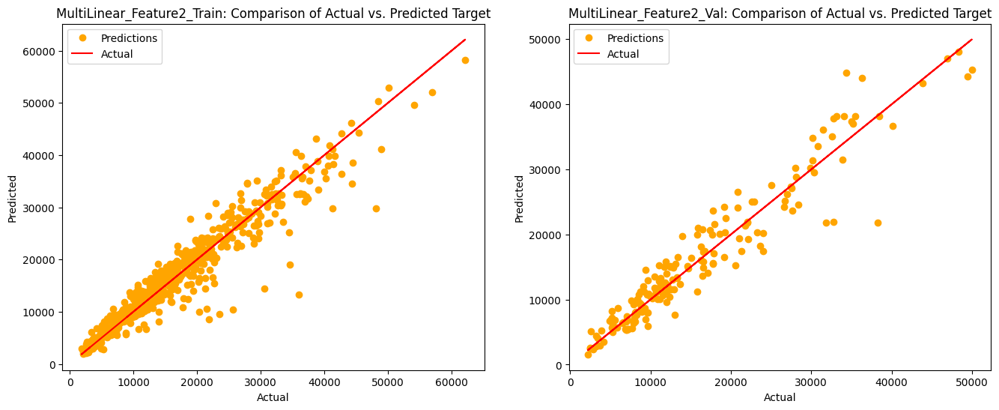

In [360]:
multi_feature2 = multilinear(X_train_feature2, y_train, X_val_feature2, y_val, 'MultiLinear_Feature2_Train', 'MultiLinear_Feature2_Val')
multi_feature2

### 4. Feature Engineering 3 (Correlation >= 0.8)

In [361]:
feature_var = []

for key in sorted_correlation.keys():
    if sorted_correlation[key] > 0.8:
        feature_var.append(key)

In [362]:
X_train_feature3 = train_df[feature_var]
X_val_feature3 = val_df[feature_var]
X_test_feature3 = test_df[feature_var]

In [363]:
X_train_feature3_scaled = scaler.fit_transform(X_train_feature3)
X_val_feature3_scaled = scaler.transform(X_val_feature3)
X_test_feature3_scaled = scaler.transform(X_test_feature3)

In [364]:
X_train_feature1 = pd.DataFrame(X_train_feature3_scaled, columns=X_train_feature3.columns)
X_val_feature1 = pd.DataFrame(X_val_feature3_scaled, columns=X_val_feature3.columns)
X_test_feature1 = pd.DataFrame(X_test_feature3_scaled, columns=X_test_feature3.columns)

,mae,mse,rmse
MultiLinear_Feature3_Train,2278.747762,1.223434e+07,3497.762131
MultiLinear_Feature3_Val,2124.895843,9.739218e+06,3120.772055


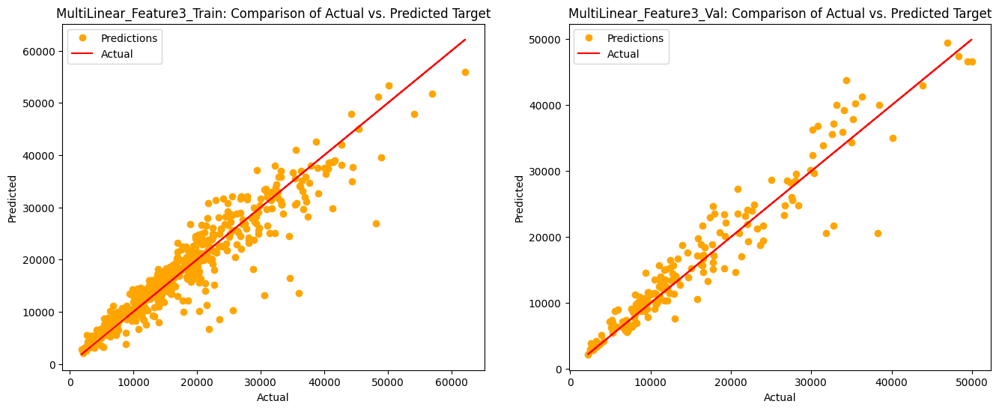

In [365]:
multi_feature3 = multilinear(X_train_feature3, y_train, X_val_feature3, y_val, 'MultiLinear_Feature3_Train', 'MultiLinear_Feature3_Val')
multi_feature3

In [366]:
multi_model = pd.concat([baseline_train, baseline_test, multi, multi_feature1, multi_feature2, multi_feature3])
multi_model

,mae,mse,rmse
Baseline_Train,8307.422361,1.105862e+08,10515.995863
Baseline_Test,7751.203825,1.000556e+08,10002.777477
MultiLinear_Train,2079.423872,9.298125e+06,3049.282748
MultiLinear_Val,2267.698408,1.029542e+07,3208.647385
MultiLinear_Feature1_Train,2070.482628,9.344101e+06,3056.812263
MultiLinear_Feature1_Val,2230.827601,1.010146e+07,3178.280116
MultiLinear_Feature2_Train,2093.693198,1.030223e+07,3209.708360
MultiLinear_Feature2_Val,2123.415974,9.319224e+06,3052.740411
MultiLinear_Feature3_Train,2278.747762,1.223434e+07,3497.762131
MultiLinear_Feature3_Val,2124.895843,9.739218e+06,3120.772055


## II. Lasso Model

In [367]:
from sklearn.linear_model import Lasso

#### Lasso Function

In [368]:
def lassomodel(X_train, y_train, X_test, y_test, index_train, index_test):
    lasso_reg = Lasso()
    lasso_reg.fit(X_train, y_train)
    y_preds_train = lasso_reg.predict(X_train)
    y_preds_test = lasso_reg.predict(X_test)

    mse = mean_squared_error(y_train, y_preds_train)
    mae = mean_absolute_error(y_train, y_preds_train)
    rmse = mean_squared_error(y_train, y_preds_train, squared=False)

    lasso_train = pd.DataFrame({'mae': mae,
                                'mse': mse,
                                'rmse': rmse},
                               index=[index_train])

    mse = mean_squared_error(y_test, y_preds_test)
    mae = mean_absolute_error(y_test, y_preds_test)
    rmse = mean_squared_error(y_test, y_preds_test, squared=False)

    lasso_test = pd.DataFrame({'mae': mae,
                               'mse': mse,
                               'rmse': rmse},
                              index=[index_test])

    lasso_models = pd.concat([lasso_train, lasso_test])

    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))

    # Plot the predicted vs actual target values for the training set
    axes[0].plot(y_train, y_preds_train, 'o',
                 color='orange', label='Predictions')
    axes[0].plot(y_train, y_train, '-', color='red', label='Actual')

    axes[0].set_xlabel('Actual')
    axes[0].set_ylabel('Predicted')
    axes[0].set_title(
        f'{index_train}: Comparison of Actual vs. Predicted Target')

    axes[0].legend()

    axes[1].plot(y_test, y_preds_test, 'o',
                 color='orange', label='Predictions')
    axes[1].plot(y_test, y_test, '-', color='red', label='Actual')

    axes[1].set_xlabel('Actual')
    axes[1].set_ylabel('Predicted')
    axes[1].set_title(
        f'{index_test}: Comparison of Actual vs. Predicted Target')

    axes[1].legend()

    plt.show()

    return lasso_models


### 1. Lasso Regression with All Features

/opt/homebrew/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.229e+09, tolerance: 6.038e+06
  model = cd_fast.enet_coordinate_descent(


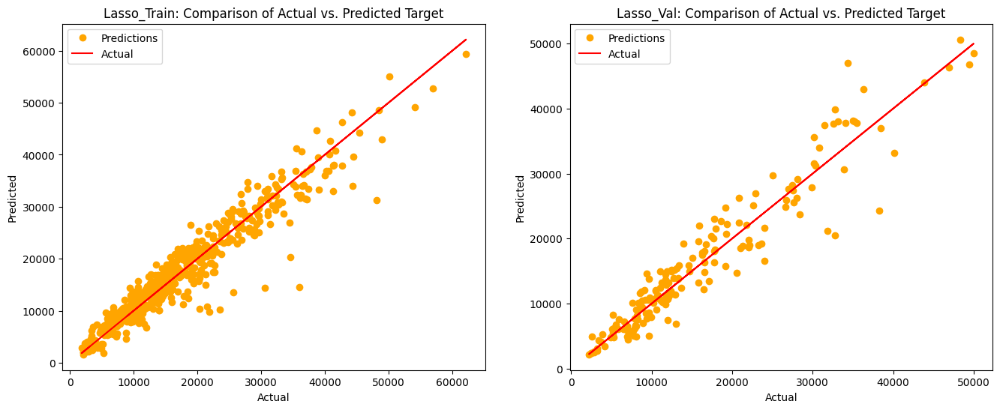

,mae,mse,rmse
Lasso_Train,2093.725380,9.353681e+06,3058.378796
Lasso_Val,2279.843057,1.024395e+07,3200.616371


In [369]:
lasso = lassomodel(X_train, y_train, X_val, y_val, 'Lasso_Train', 'Lasso_Val')
lasso

### 2. Lasso Regression Feature Engineering 1 (Correlation >= 0.5)

/opt/homebrew/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.766e+09, tolerance: 6.038e+06
  model = cd_fast.enet_coordinate_descent(


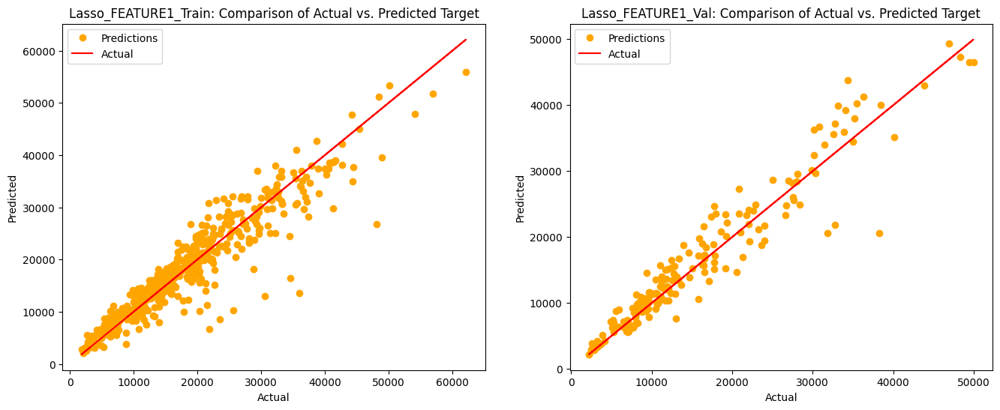

,mae,mse,rmse
Lasso_FEATURE1_Train,2278.114357,1.223520e+07,3497.885577
Lasso_FEATURE1_Val,2123.981346,9.719629e+06,3117.631893


In [370]:
lasso_feature1 = lassomodel(X_train_feature1, y_train, X_val_feature1, y_val, 'Lasso_FEATURE1_Train', 'Lasso_FEATURE1_Val')
lasso_feature1

### 3. Lasso Regression Feature Engineering 2 (Correlation >= 0.7)

/opt/homebrew/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.137e+09, tolerance: 6.038e+06
  model = cd_fast.enet_coordinate_descent(


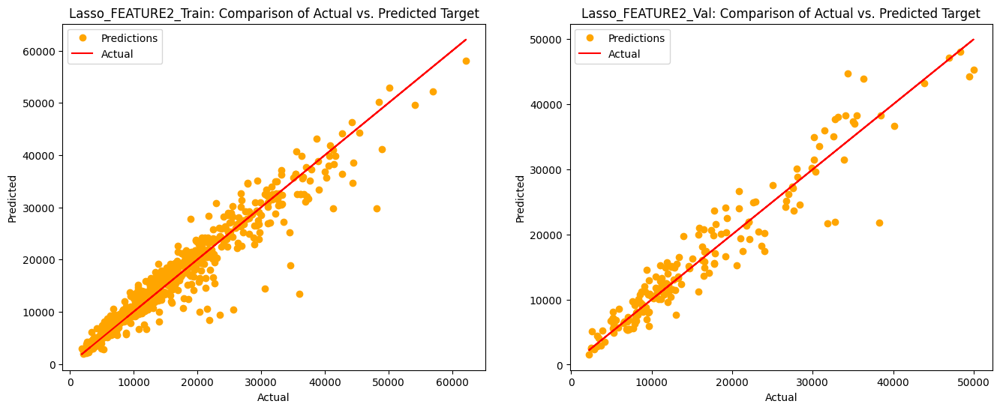

,mae,mse,rmse
Lasso_FEATURE2_Train,2092.325287,1.030345e+07,3209.898411
Lasso_FEATURE2_Val,2117.264295,9.286441e+06,3047.366207


In [371]:
lasso_feature2 = lassomodel(X_train_feature2, y_train, X_val_feature2, y_val, 'Lasso_FEATURE2_Train', 'Lasso_FEATURE2_Val')
lasso_feature2

### 4. Lasso Regression Feature Engineering 3 (Correlation >= 0.8)

/opt/homebrew/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.340e+09, tolerance: 6.038e+06
  model = cd_fast.enet_coordinate_descent(


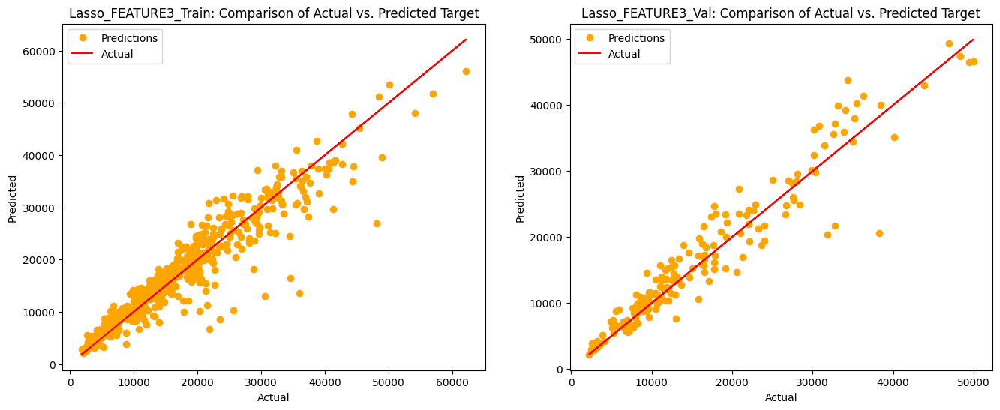

,mae,mse,rmse
Lasso_FEATURE3_Train,2279.940306,1.223561e+07,3497.943503
Lasso_FEATURE3_Val,2127.655356,9.759305e+06,3123.988600


In [372]:
lasso_feature3 = lassomodel(X_train_feature3, y_train, X_val_feature3, y_val, 'Lasso_FEATURE3_Train', 'Lasso_FEATURE3_Val')
lasso_feature3

In [373]:
lasso_model = pd.concat([lasso, lasso_feature1, lasso_feature2, lasso_feature3])
lasso_model

,mae,mse,rmse
Lasso_Train,2093.725380,9.353681e+06,3058.378796
Lasso_Val,2279.843057,1.024395e+07,3200.616371
Lasso_FEATURE1_Train,2278.114357,1.223520e+07,3497.885577
Lasso_FEATURE1_Val,2123.981346,9.719629e+06,3117.631893
Lasso_FEATURE2_Train,2092.325287,1.030345e+07,3209.898411
Lasso_FEATURE2_Val,2117.264295,9.286441e+06,3047.366207
Lasso_FEATURE3_Train,2279.940306,1.223561e+07,3497.943503
Lasso_FEATURE3_Val,2127.655356,9.759305e+06,3123.988600


## III. Ridge Model

In [374]:
from sklearn.linear_model import Ridge

### Ridge Function

In [375]:
def ridgemodel(X_train, y_train, X_test, y_test, index_train, index_test):
    ridge_reg = Ridge()
    ridge_reg.fit(X_train, y_train)
    y_preds_train = ridge_reg.predict(X_train)
    y_preds_test = ridge_reg.predict(X_test)

    mse = mean_squared_error(y_train, y_preds_train)
    mae = mean_absolute_error(y_train, y_preds_train)
    rmse = mean_squared_error(y_train, y_preds_train, squared=False)

    ridge_train = pd.DataFrame({'mae': mae,
                                'mse': mse,
                                'rmse': rmse},
                               index=[index_train])

    mse = mean_squared_error(y_test, y_preds_test)
    mae = mean_absolute_error(y_test, y_preds_test)
    rmse = mean_squared_error(y_test, y_preds_test, squared=False)

    ridge_test = pd.DataFrame({'mae': mae,
                               'mse': mse,
                               'rmse': rmse},
                              index=[index_test])

    ridge_models = pd.concat([ridge_train, ridge_test])

    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))

    # Plot the predicted vs actual target values for the training set
    axes[0].plot(y_train, y_preds_train, 'o',
                 color='orange', label='Predictions')
    axes[0].plot(y_train, y_train, '-', color='red', label='Actual')

    axes[0].set_xlabel('Actual')
    axes[0].set_ylabel('Predicted')
    axes[0].set_title(
        f'{index_train}: Comparison of Actual vs. Predicted Target')

    axes[0].legend()

    axes[1].plot(y_test, y_preds_test, 'o',
                 color='orange', label='Predictions')
    axes[1].plot(y_test, y_test, '-', color='red', label='Actual')

    axes[1].set_xlabel('Actual')
    axes[1].set_ylabel('Predicted')
    axes[1].set_title(
        f'{index_test}: Comparison of Actual vs. Predicted Target')

    axes[1].legend()

    plt.show()

    return ridge_models


### 1. Ridge Regression with All Features

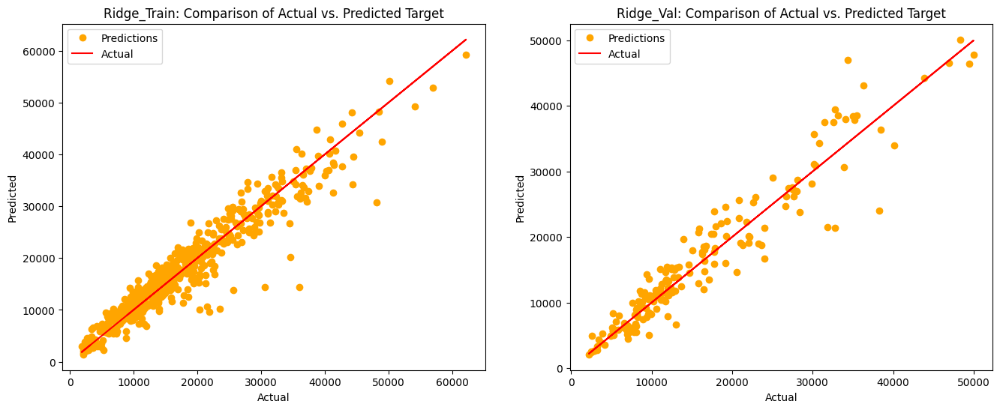

,mae,mse,rmse
Ridge_Train,2061.966576,9.326546e+06,3053.939442
Ridge_Val,2211.667197,9.930921e+06,3151.336341


In [376]:
ridge = ridgemodel(X_train, y_train, X_val, y_val, 'Ridge_Train', 'Ridge_Val')
ridge

### 2. Ridge Regression Feature Engineering 1 (Correlation >= 0.5)

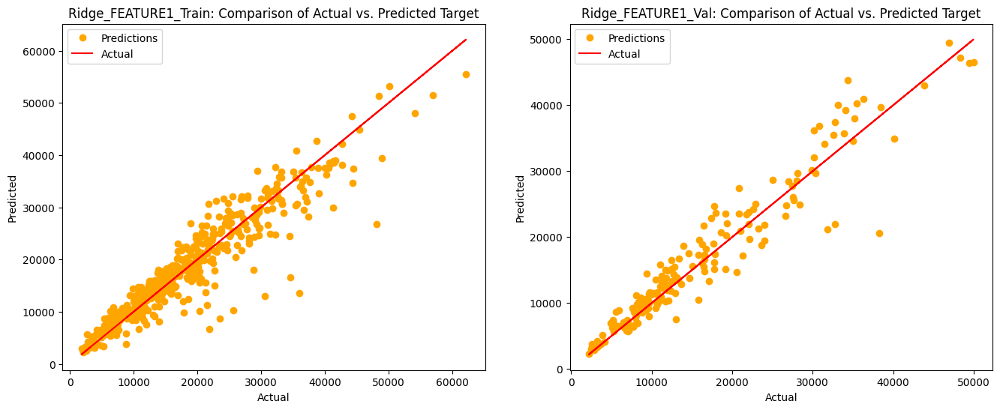

,mae,mse,rmse
Ridge_FEATURE1_Train,2274.841596,1.225304e+07,3500.433978
Ridge_FEATURE1_Val,2108.951082,9.600463e+06,3098.461357


In [377]:
ridge_feature1 = ridgemodel(X_train_feature1, y_train, X_val_feature1, y_val, 'Ridge_FEATURE1_Train', 'Ridge_FEATURE1_Val')
ridge_feature1

### 3. Ridge Regression Feature Engineering 2 (Correlation >= 0.7)

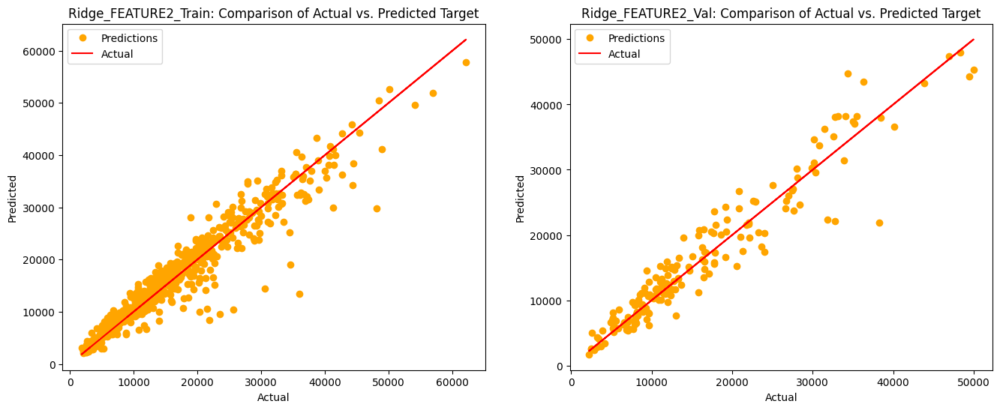

,mae,mse,rmse
Ridge_FEATURE2_Train,2084.101832,1.031979e+07,3212.443623
Ridge_FEATURE2_Val,2102.691899,9.118768e+06,3019.729731


In [378]:
ridge_feature2 = ridgemodel(X_train_feature2, y_train, X_val_feature2, y_val, 'Ridge_FEATURE2_Train', 'Ridge_FEATURE2_Val')
ridge_feature2

### 4. Ridge Regression Feature Engineering 3 (Correlation >= 0.8)

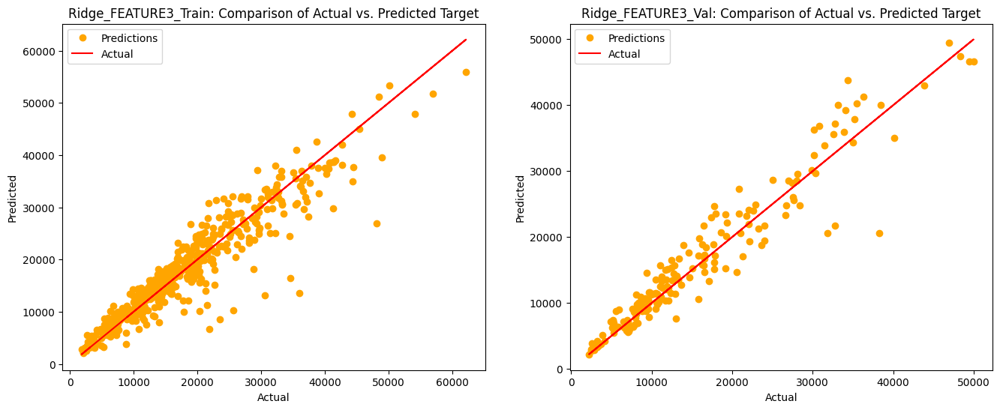

,mae,mse,rmse
Ridge_FEATURE3_Train,2278.747159,1.223434e+07,3497.762131
Ridge_FEATURE3_Val,2124.893956,9.739202e+06,3120.769408


In [379]:
ridge_feature3 = ridgemodel(X_train_feature3, y_train, X_val_feature3, y_val, 'Ridge_FEATURE3_Train', 'Ridge_FEATURE3_Val')
ridge_feature3

In [380]:
ridge_model = pd.concat([ridge, ridge_feature1, ridge_feature2, ridge_feature3])
ridge_model

,mae,mse,rmse
Ridge_Train,2061.966576,9.326546e+06,3053.939442
Ridge_Val,2211.667197,9.930921e+06,3151.336341
Ridge_FEATURE1_Train,2274.841596,1.225304e+07,3500.433978
Ridge_FEATURE1_Val,2108.951082,9.600463e+06,3098.461357
Ridge_FEATURE2_Train,2084.101832,1.031979e+07,3212.443623
Ridge_FEATURE2_Val,2102.691899,9.118768e+06,3019.729731
Ridge_FEATURE3_Train,2278.747159,1.223434e+07,3497.762131
Ridge_FEATURE3_Val,2124.893956,9.739202e+06,3120.769408


## IV. ElasticNet

In [381]:
from sklearn.linear_model import ElasticNet

### ElasticNet Function

In [382]:
def elasticnet(X_train, y_train, X_test, y_test, index_train, index_test):
    elastic_reg = ElasticNet()
    elastic_reg.fit(X_train, y_train)
    y_preds_train = elastic_reg.predict(X_train)
    y_preds_test = elastic_reg.predict(X_test)

    mse = mean_squared_error(y_train, y_preds_train)
    mae = mean_absolute_error(y_train, y_preds_train)
    rmse = mean_squared_error(y_train, y_preds_train, squared=False)

    elastic_train = pd.DataFrame({'mae': mae,
                                  'mse': mse,
                                  'rmse': rmse},
                                 index=[index_train])

    mse = mean_squared_error(y_test, y_preds_test)
    mae = mean_absolute_error(y_test, y_preds_test)
    rmse = mean_squared_error(y_test, y_preds_test, squared=False)

    elastic_test = pd.DataFrame({'mae': mae,
                                 'mse': mse,
                                 'rmse': rmse},
                                index=[index_test])

    elastic_models = pd.concat([elastic_train, elastic_test])

    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))

    axes[0].plot(y_train, y_preds_train, 'o',
                 color='orange', label='Predictions')
    axes[0].plot(y_train, y_train, '-', color='red', label='Actual')

    axes[0].set_xlabel('Actual')
    axes[0].set_ylabel('Predicted')
    axes[0].set_title(
        f'{index_train}: Comparison of Actual vs. Predicted Target')

    axes[0].legend()

    axes[1].plot(y_test, y_preds_test, 'o',
                 color='orange', label='Predictions')
    axes[1].plot(y_test, y_test, '-', color='red', label='Actual')

    axes[1].set_xlabel('Actual')
    axes[1].set_ylabel('Predicted')
    axes[1].set_title(
        f'{index_test}: Comparison of Actual vs. Predicted Target')

    axes[1].legend()

    return elastic_models

### 1. ElasticNet with All Features

/opt/homebrew/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.184e+09, tolerance: 6.038e+06
  model = cd_fast.enet_coordinate_descent(


,mae,mse,rmse
Elastic_Train,2284.880425,1.238910e+07,3519.815887
Elastic_Val,2073.707562,8.579011e+06,2928.994854


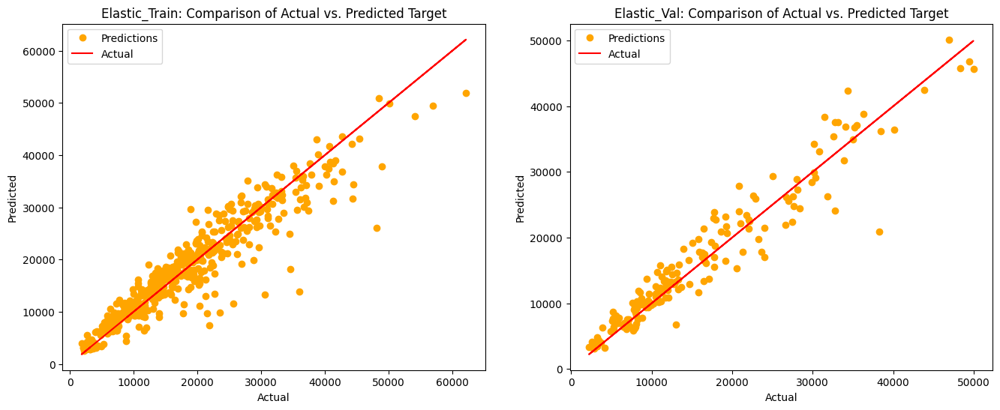

In [383]:
elastic = elasticnet(X_train, y_train, X_val, y_val, 'Elastic_Train', 'Elastic_Val')
elastic

### 2. ElasticNet Feature Engineering 1 (Correlation >= 0.5)

,mae,mse,rmse
Elastic_FEATURE1_Train,2469.341627,1.406453e+07,3750.270443
Elastic_FEATURE1_Val,2185.184604,9.342266e+06,3056.512135


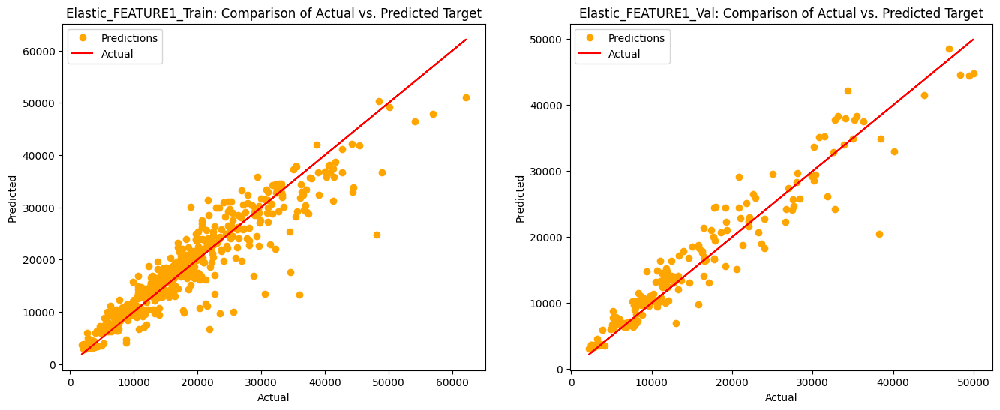

In [384]:
elastic_feature1 = elasticnet(X_train_feature1, y_train, X_val_feature1, y_val, 'Elastic_FEATURE1_Train', 'Elastic_FEATURE1_Val')
elastic_feature1

### 3. ElasticNet Feature Engineering 1 (Correlation >= 0.7)

,mae,mse,rmse
Elastic_FEATURE2_Train,2321.397873,1.289433e+07,3590.867219
Elastic_FEATURE2_Val,2109.088513,8.697749e+06,2949.194714


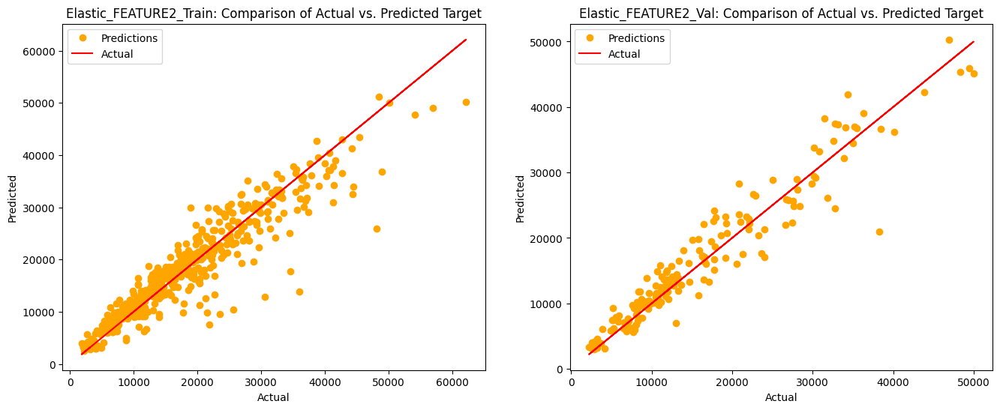

In [385]:
elastic_feature2 = elasticnet(X_train_feature2, y_train, X_val_feature2, y_val, 'Elastic_FEATURE2_Train', 'Elastic_FEATURE2_Val')
elastic_feature2

### 4. ElasticNet Feature Engineering 1 (Correlation >= 0.8)

/opt/homebrew/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.341e+09, tolerance: 6.038e+06
  model = cd_fast.enet_coordinate_descent(


,mae,mse,rmse
Elastic_FEATURE3_Train,2279.672369,1.223548e+07,3497.925509
Elastic_FEATURE3_Val,2126.979548,9.753365e+06,3123.037799


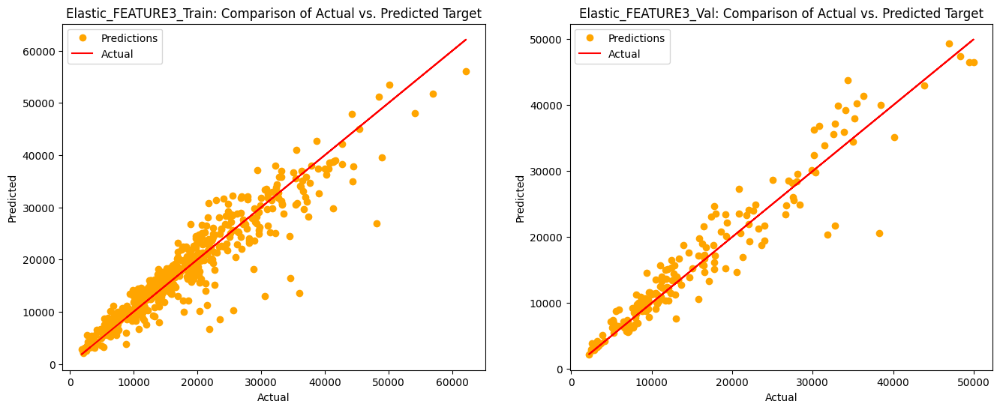

In [386]:
elastic_feature3 = elasticnet(X_train_feature3, y_train, X_val_feature3, y_val, 'Elastic_FEATURE3_Train', 'Elastic_FEATURE3_Val')
elastic_feature3

In [387]:
elastic_model = pd.concat([elastic, elastic_feature1, elastic_feature2, elastic_feature3])
elastic_model

,mae,mse,rmse
Elastic_Train,2284.880425,1.238910e+07,3519.815887
Elastic_Val,2073.707562,8.579011e+06,2928.994854
Elastic_FEATURE1_Train,2469.341627,1.406453e+07,3750.270443
Elastic_FEATURE1_Val,2185.184604,9.342266e+06,3056.512135
Elastic_FEATURE2_Train,2321.397873,1.289433e+07,3590.867219
Elastic_FEATURE2_Val,2109.088513,8.697749e+06,2949.194714
Elastic_FEATURE3_Train,2279.672369,1.223548e+07,3497.925509
Elastic_FEATURE3_Val,2126.979548,9.753365e+06,3123.037799


## V. Decision Tree Regression

In [388]:
from sklearn.tree import DecisionTreeRegressor, plot_tree

### Decision Tree Function (Default Hyperparameter)

In [389]:
def decision_tree_regression(X_train, y_train, X_test, y_test, index_train, index_test):
    regressor = DecisionTreeRegressor(random_state=42).fit(X_train, y_train)
    
    y_preds_train = regressor.predict(X_train)
    y_preds_test = regressor.predict(X_test)

    mse = mean_squared_error(y_train, y_preds_train)
    mae = mean_absolute_error(y_train, y_preds_train)
    rmse = mean_squared_error(y_train, y_preds_train, squared=False)

    dt_train = pd.DataFrame({'mae': mae,
                                  'mse': mse,
                                  'rmse': rmse},
                                 index=[index_train])

    mse = mean_squared_error(y_test, y_preds_test)
    mae = mean_absolute_error(y_test, y_preds_test)
    rmse = mean_squared_error(y_test, y_preds_test, squared=False)

    dt_test = pd.DataFrame({'mae': mae,
                                 'mse': mse,
                                 'rmse': rmse},
                                index=[index_test])
    
    dt_models = pd.concat([dt_train, dt_test])

    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(24, 6))
    axes[0].set_title(f'Decision Tree: {index_train}')
    plot_tree(regressor, ax=axes[0], filled=True)

    axes[1].set_title(f'Decision  Tree: {index_test}')
    plot_tree(regressor, ax=axes[1], filled=True)
    
    plt.tight_layout()
    plt.show()

    feature_importances = regressor.feature_importances_
    sorted_indices = np.argsort(feature_importances)[::-1]
    
    feature_names = X_train.columns.values
    
    sorted_feature_importances = feature_importances[sorted_indices]
    sorted_feature_names = feature_names[sorted_indices]
    
    plt.figure(figsize=(6, 20))
    plt.barh(range(len(sorted_feature_importances)), sorted_feature_importances[::-1], align='center')
    plt.yticks(range(len(sorted_feature_importances)), sorted_feature_names[::-1])
    plt.xlabel("Feature Importance")
    plt.ylabel("Features")
    plt.title("Decision Tree Regressor - Feature Importance")
    plt.show()

    return dt_models

### 1. Decision Tree Regression with All Features

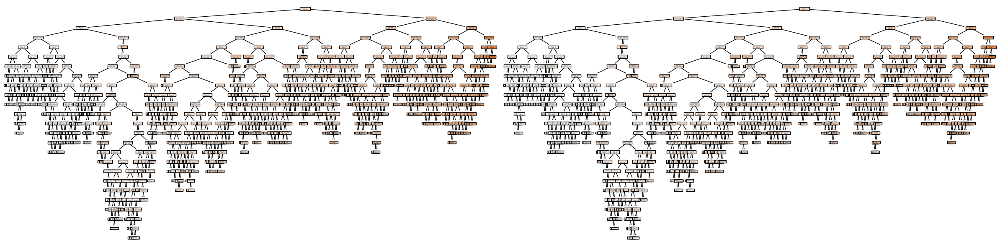

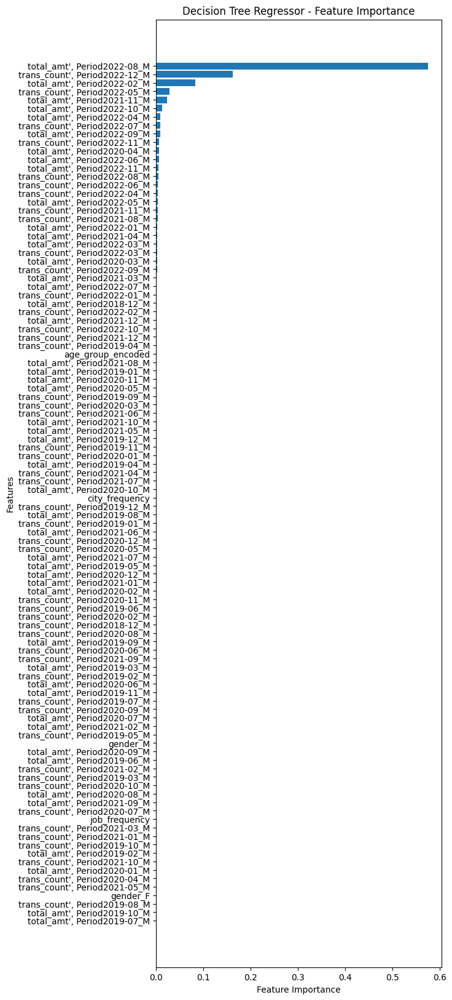

,mae,mse,rmse
Dtregressor_Train,0.000000,0.000000e+00,0.000000
Dtregressor_Val,3022.997923,1.981871e+07,4451.821535


In [390]:
dt = decision_tree_regression(X_train, y_train, X_val, y_val, 'Dtregressor_Train', 'Dtregressor_Val')
dt

### 2. Decision Tree Regression Feature Engineering 1 (Correlation >= 0.5)

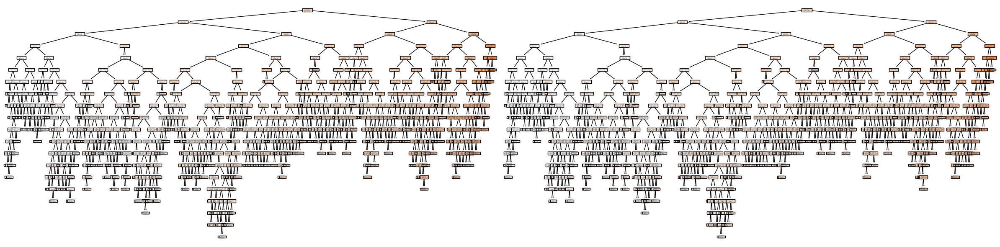

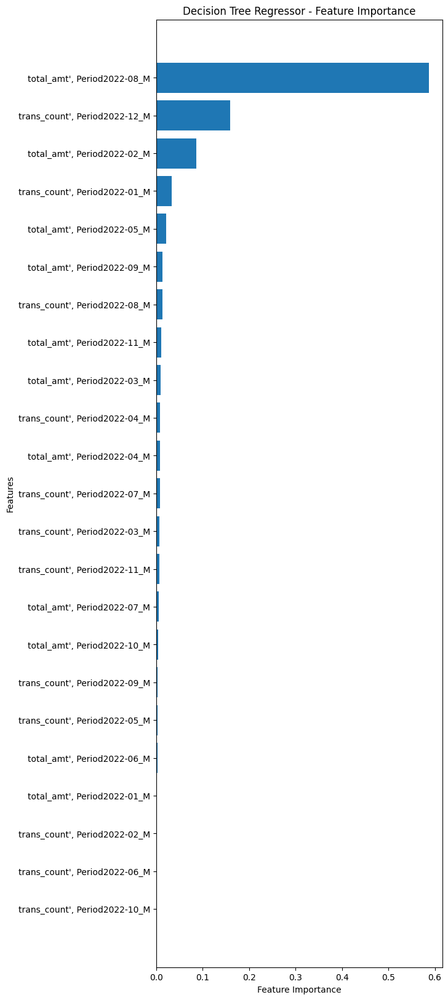

,mae,mse,rmse
Dtregressor_FEATURE1_Train,0.000000,0.000000e+00,0.000000
Dtregressor_FEATURE1_Val,3142.906175,2.105998e+07,4589.114999


In [391]:
dt_feature1 = decision_tree_regression(X_train_feature1, y_train, X_val_feature1, y_val, 'Dtregressor_FEATURE1_Train', 'Dtregressor_FEATURE1_Val')
dt_feature1

### 3. Decision Tree Regression Feature Engineering 2 (Correlation >= 0.7)

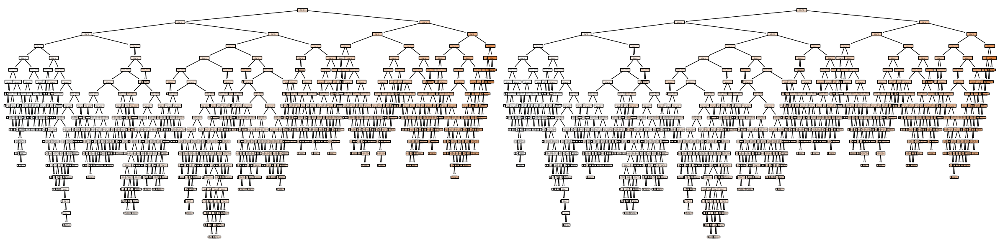

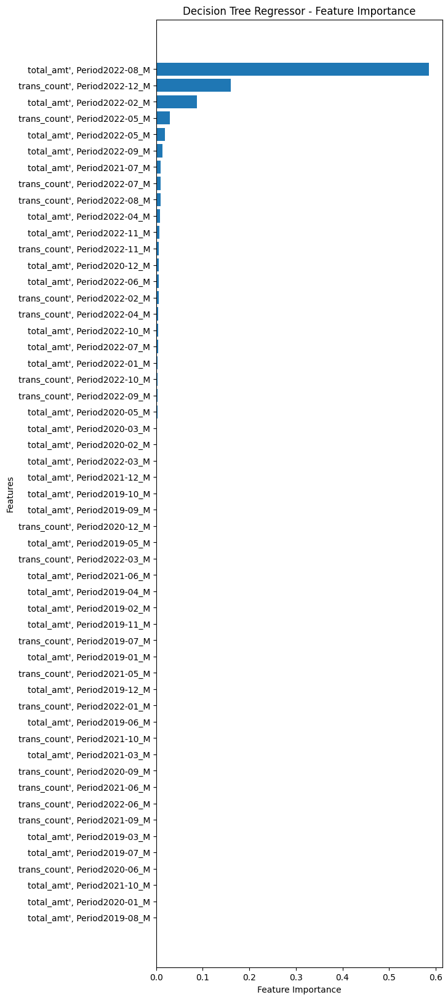

,mae,mse,rmse
Dtregressor_FEATURE2_Train,0.00000,0.000000e+00,0.000000
Dtregressor_FEATURE2_Val,3379.59929,2.756409e+07,5250.151896


In [392]:
dt_feature2 = decision_tree_regression(X_train_feature2, y_train, X_val_feature2, y_val, 'Dtregressor_FEATURE2_Train', 'Dtregressor_FEATURE2_Val')
dt_feature2

### 4. Decision Tree Regression Feature Engineering 3 (Correlation >= 0.8)

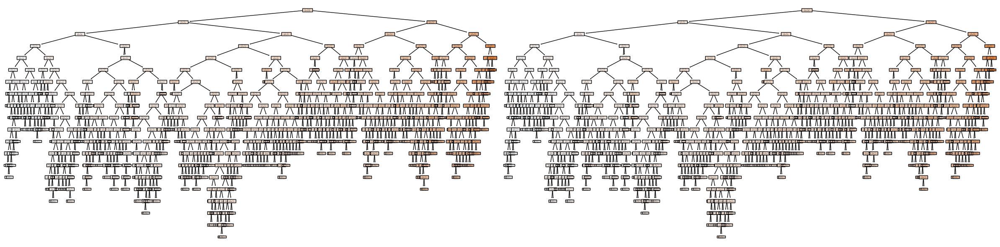

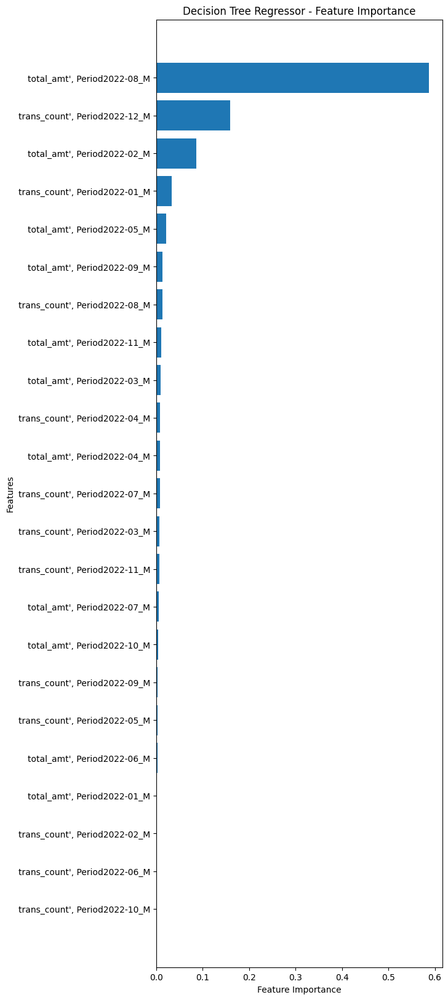

,mae,mse,rmse
Dtregressor_FEATURE3_Train,0.000000,0.000000e+00,0.0000
Dtregressor_FEATURE3_Val,3090.758525,2.071248e+07,4551.0961


In [393]:
dt_feature3 = decision_tree_regression(X_train_feature3, y_train, X_val_feature3, y_val, 'Dtregressor_FEATURE3_Train', 'Dtregressor_FEATURE3_Val')
dt_feature3

## Hyperparameter Tuning

## Reduce Overfitting with max_depth (default = None)

In [394]:
max_depth = [2, 5, 10, 20, 50, 100, 150, 200, None]

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in max_depth:
    regressor = DecisionTreeRegressor(random_state=42, max_depth=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_max_depth = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=max_depth)
result_max_depth

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
2.0,3815.480925,3614.774442,2.645389e+07,2.241880e+07,5143.334947,4734.849732
5.0,2017.879079,2632.876525,8.616914e+06,1.638042e+07,2935.458046,4047.273239
10.0,432.658774,3125.795647,6.059501e+05,2.398058e+07,778.427956,4896.996807
20.0,5.152083,3292.034456,1.172666e+03,2.500349e+07,34.244207,5000.348965
50.0,0.000000,3022.997923,0.000000e+00,1.981871e+07,0.000000,4451.821535
100.0,0.000000,3022.997923,0.000000e+00,1.981871e+07,0.000000,4451.821535
150.0,0.000000,3022.997923,0.000000e+00,1.981871e+07,0.000000,4451.821535
200.0,0.000000,3022.997923,0.000000e+00,1.981871e+07,0.000000,4451.821535
NaN,0.000000,3022.997923,0.000000e+00,1.981871e+07,0.000000,4451.821535


In [395]:
def plot_performance(parameter, xlabel):

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 5))

    ax1.plot(parameter, train_mae, label='Mean Absolute Errors: Train')
    ax1.plot(parameter, val_mae, label='Mean Absolute Errors: Validation')
    ax1.legend()
    ax1.set_xlabel(xlabel)
    ax1.set_ylabel('MAE')
    ax1.set_title('Mean Absolute Error')

    ax2.plot(parameter, train_mse, label='Mean Squared Errors: Train')
    ax2.plot(parameter, val_mse, label='Mean Squared Errors: Validation')
    ax2.legend()
    ax2.set_xlabel(xlabel)
    ax2.set_ylabel('MSE')
    ax2.set_title('Mean Squared Error')

    ax3.plot(parameter, train_rmse, label='Root Mean Squared Errors: Train')
    ax3.plot(parameter, val_rmse, label='Root Mean Squared Errors: Validation')
    ax3.legend()
    ax3.set_xlabel(xlabel)
    ax3.set_ylabel('RMSE')
    ax3.set_title('Root Mean Squared Errors')
    
    plt.subplots_adjust(wspace=0.4)
    plt.show()

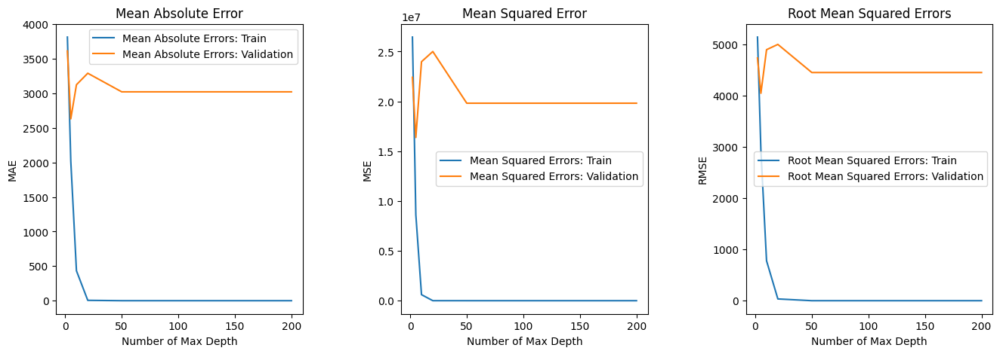

In [396]:
plot_performance(max_depth, 'Number of Max Depth')

#### max_depth = 5 appears to be the best choice

### Reduce Overfitting with min_samples_split (max_depth=10)

In [397]:
min_sample_split = [2, 5, 10, 20, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in min_sample_split:
    regressor = DecisionTreeRegressor(random_state=42, max_depth=5, min_samples_split=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_min_split = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=min_sample_split)
result_min_split

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
2,2017.879079,2632.876525,8.616914e+06,1.638042e+07,2935.458046,4047.273239
5,2039.619128,2668.817737,8.705258e+06,1.668670e+07,2950.467421,4084.935487
10,2113.086587,2616.476637,9.294261e+06,1.696806e+07,3048.649072,4119.230275
20,2145.584653,2647.062769,9.529820e+06,1.720362e+07,3087.040677,4147.724514
50,2405.394644,2453.609358,1.205364e+07,1.397932e+07,3471.835964,3738.892500
100,3005.717701,2827.152308,1.960527e+07,1.591273e+07,4427.783672,3989.076370
150,3263.783929,3107.642604,2.216672e+07,1.741710e+07,4708.154557,4173.379489
200,4062.315694,3818.220233,3.372255e+07,3.003290e+07,5807.111693,5480.227973
250,4303.294377,4110.614686,3.558026e+07,3.377878e+07,5964.918713,5811.951725
300,4303.294377,4110.614686,3.558026e+07,3.377878e+07,5964.918713,5811.951725


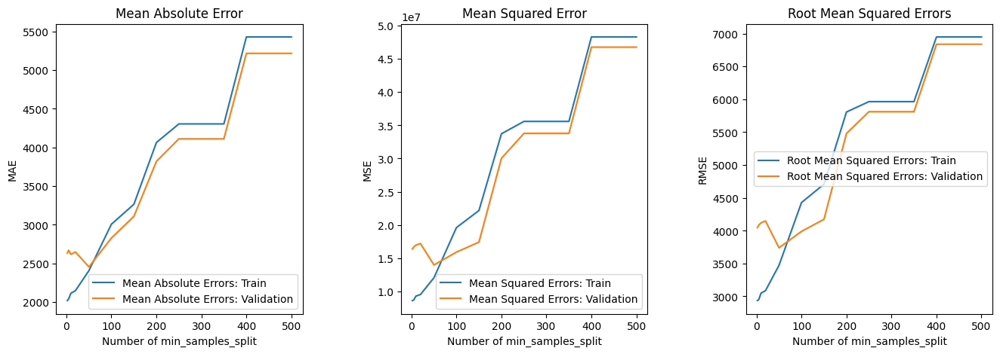

In [398]:
plot_performance(min_sample_split, 'Number of min_samples_split')

min_samples_split = 50 appears to be the best choice

## Reduce Overfitting with min_samples_leaf (max_depth=10, min_samples_split=10)

In [399]:
min_samples_leaf = [2, 5, 10, 20, 50, 100, 150, 200]

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in min_samples_leaf:
    regressor = DecisionTreeRegressor(random_state=42, max_depth=5, min_samples_split=50, min_samples_leaf=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_min_leaf = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=min_samples_leaf)
result_min_leaf

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
2,2434.628170,2495.077908,1.234958e+07,1.434912e+07,3514.197533,3788.023115
5,2400.117670,2497.152084,1.252384e+07,1.462245e+07,3538.903512,3823.930808
10,2529.828746,2693.498737,1.408535e+07,1.772781e+07,3753.045990,4210.440371
20,2542.741510,2787.395009,1.481632e+07,1.640833e+07,3849.197790,4050.719254
50,3023.045614,2977.038460,1.974248e+07,1.712419e+07,4443.251073,4138.138037
100,4096.456639,3858.048355,3.413148e+07,3.090315e+07,5842.215653,5559.060013
150,4303.294377,4110.614686,3.558026e+07,3.377878e+07,5964.918713,5811.951725
200,5393.094725,4675.050604,4.920576e+07,3.827844e+07,7014.681598,6186.957172


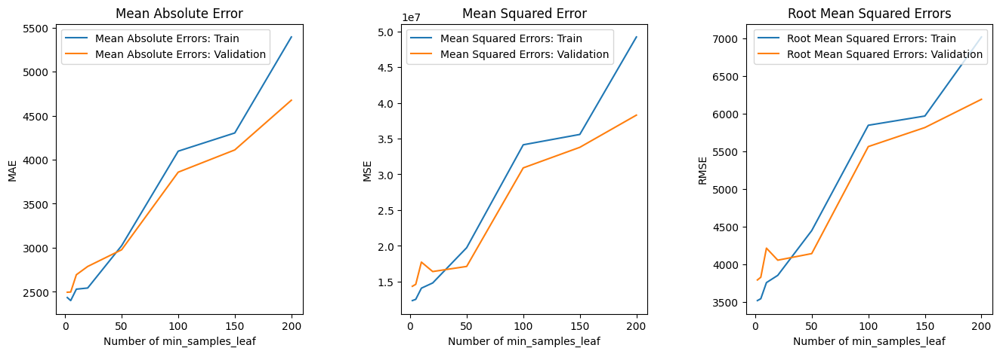

In [400]:
plot_performance(min_samples_leaf, 'Number of min_samples_leaf')

#### min_samples_leaf = 2 appears to be the best choice

## Reduce Overfitting with max_features (max_depth=10, min_samples_split=10, min_samples_leaf=20)

In [401]:
max_features = list(range(1, 40))

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in max_features:
    regressor = DecisionTreeRegressor(random_state=42, max_depth=5, min_samples_split=50, min_samples_leaf=2, max_features=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_max_features = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=max_features)
result_max_features

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
1,4264.657260,4616.025908,3.212019e+07,3.590294e+07,5667.467929,5991.906389
2,3881.229772,4051.035539,2.541137e+07,3.018227e+07,5040.968720,5493.839657
3,3426.687014,3721.874845,2.364337e+07,2.306265e+07,4862.445246,4802.358837
4,3097.223558,3580.844608,1.866593e+07,2.397298e+07,4320.408298,4896.220703
5,3202.852552,3238.518236,2.015210e+07,2.089132e+07,4489.109075,4570.702049
6,3106.749747,3474.954972,1.910198e+07,2.435943e+07,4370.580762,4935.527600
7,2728.941066,2887.399486,1.673508e+07,1.758785e+07,4090.853564,4193.786896
8,2666.172170,3081.998005,1.515382e+07,1.999276e+07,3892.790373,4471.326484
9,2664.665506,3068.606964,1.523465e+07,1.875990e+07,3903.159341,4331.269661
10,2415.864738,2343.437093,1.281677e+07,1.175229e+07,3580.051743,3428.161970


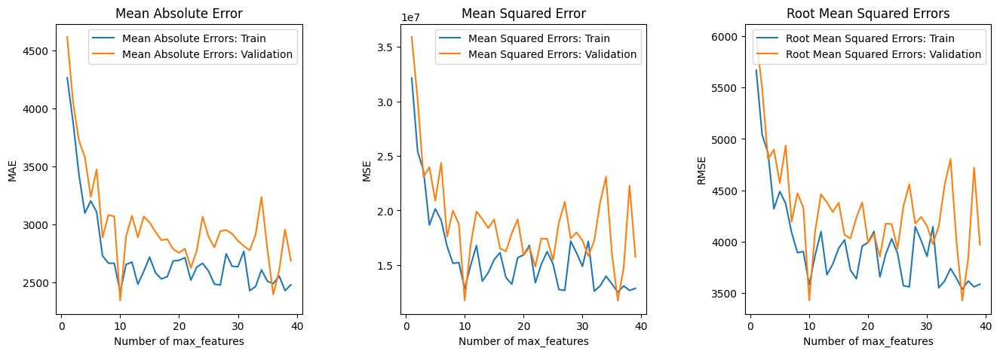

In [402]:
plot_performance(max_features, 'Number of max_features')

#### max_features = 10 appears to be the best choice

## Reduce Overfitting with criterion (max_depth=10, min_samples_split=10, min_samples_leaf=20, max_features=10)

In [403]:
criterion = ['absolute_error', 'squared_error', 'friedman_mse', 'poisson']

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in criterion:
    regressor = DecisionTreeRegressor(random_state=42, max_depth=5, min_samples_split=50, min_samples_leaf=5, max_features=10, criterion=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_criterion = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=criterion)
result_criterion

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
absolute_error,2538.360879,2528.292131,1.766422e+07,1.374484e+07,4202.881995,3707.403884
squared_error,2428.632887,2377.058551,1.302080e+07,1.166857e+07,3608.435026,3415.929063
friedman_mse,2428.632887,2377.058551,1.302080e+07,1.166857e+07,3608.435026,3415.929063
poisson,2696.912025,2604.426164,1.551771e+07,1.462207e+07,3939.252978,3823.881632


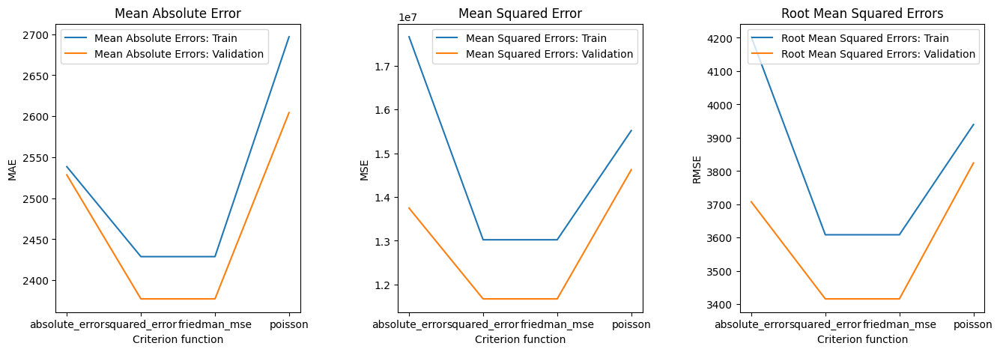

In [404]:
plot_performance(criterion, 'Criterion function')

## After Hyperparameter tuning

Decision Tree Regressor (After tuning)

In [405]:
import altair as alt

def decision_tree_regression_tuning(X_train, y_train, X_test, y_test, index_train, index_test):
    regressor = DecisionTreeRegressor(random_state=42, max_depth=5, min_samples_split=50, min_samples_leaf=5, max_features=10, criterion='squared_error').fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_test = regressor.predict(X_test)

    mse = mean_squared_error(y_train, y_preds_train)
    mae = mean_absolute_error(y_train, y_preds_train)
    rmse = mean_squared_error(y_train, y_preds_train, squared=False)

    dt_train = pd.DataFrame({'mae': mae,
                             'mse': mse,
                             'rmse': rmse},
                            index=[index_train])

    mse = mean_squared_error(y_test, y_preds_test)
    mae = mean_absolute_error(y_test, y_preds_test)
    rmse = mean_squared_error(y_test, y_preds_test, squared=False)

    dt_test = pd.DataFrame({'mae': mae,
                            'mse': mse,
                            'rmse': rmse},
                           index=[index_test])

    dt_models = pd.concat([dt_train, dt_test])

    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(24, 6))
    axes[0].set_title(f'Decision Tree: {index_train}')
    plot_tree(regressor, ax=axes[0], filled=True)

    axes[1].set_title(f'Decision  Tree: {index_test}')
    plot_tree(regressor, ax=axes[1], filled=True)

    plt.tight_layout()
    plt.show()

    feature_importances = regressor.feature_importances_
    sorted_indices = np.argsort(feature_importances)[::-1]
    
    feature_names = X_train.columns.values
    
    sorted_feature_importances = feature_importances[sorted_indices]
    sorted_feature_names = feature_names[sorted_indices]
    
    plt.figure(figsize=(6, 20))
    plt.barh(range(len(sorted_feature_importances)), sorted_feature_importances[::-1], align='center')
    plt.yticks(range(len(sorted_feature_importances)), sorted_feature_names[::-1])
    plt.xlabel("Feature Importance")
    plt.ylabel("Features")
    plt.title("Decision Tree Regressor - Feature Importance")
    plt.show()

    return dt_models


### 1. Decision Tree Regression with All Features

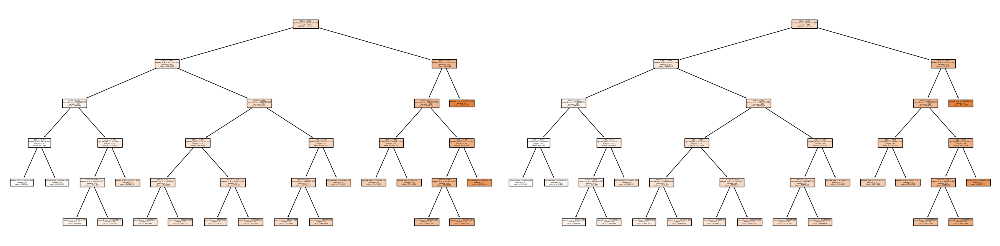

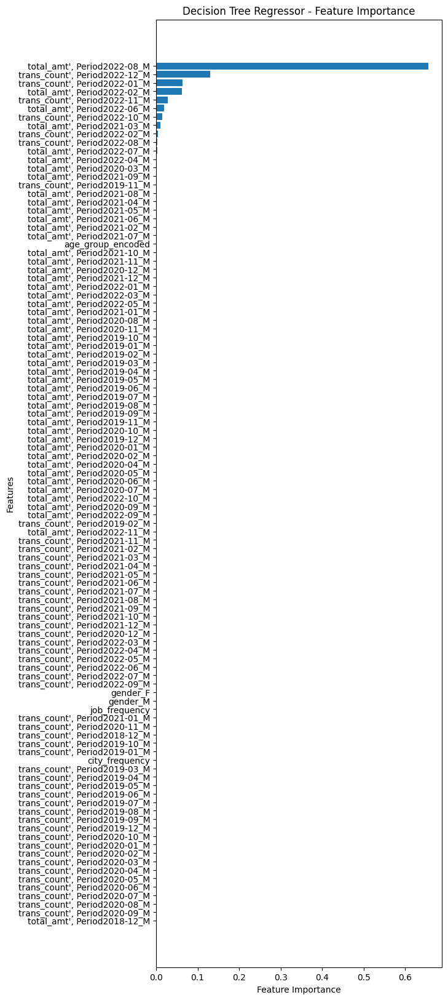

,mae,mse,rmse
DT_Tune_Train,2428.632887,1.302080e+07,3608.435026
DT_Tune_Val,2377.058551,1.166857e+07,3415.929063


In [406]:
dt_tuning = decision_tree_regression_tuning(X_train, y_train, X_val, y_val, 'DT_Tune_Train', 'DT_Tune_Val')
dt_tuning

### 2. Decision Tree Regression with Feature Enginerring 1 (Correlation > 0.5)

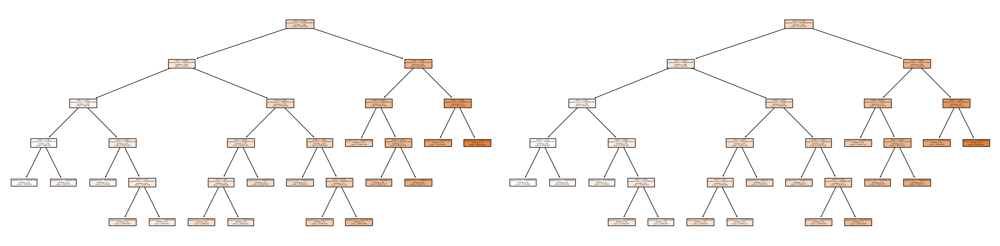

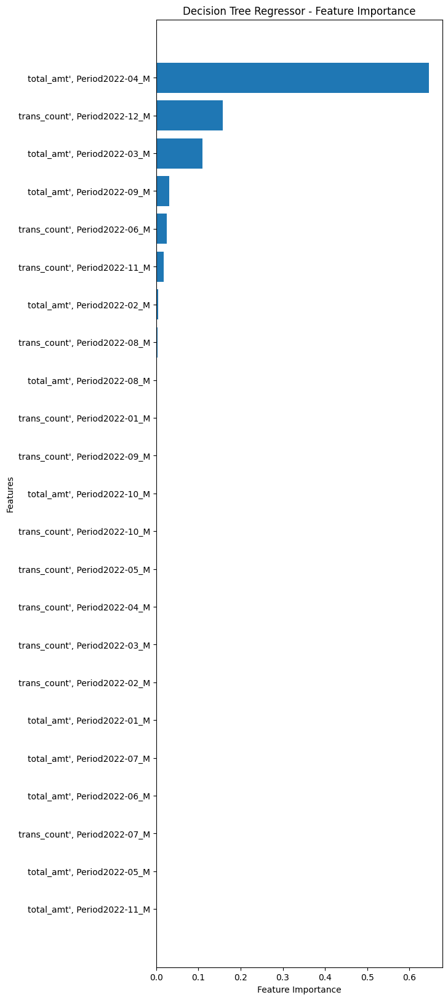

,mae,mse,rmse
DT_Tune_FEATURE1_Train,2634.547381,1.511255e+07,3887.486135
DT_Tune_FEATURE1_Val,2843.669581,1.846317e+07,4296.879298


In [407]:
dt_feature1_tuning = decision_tree_regression_tuning(X_train_feature1, y_train, X_val_feature1, y_val, 'DT_Tune_FEATURE1_Train', 'DT_Tune_FEATURE1_Val')
dt_feature1_tuning

### 3. Decision Tree Regression with Feature Enginerring 1 (Correlation > 0.7)

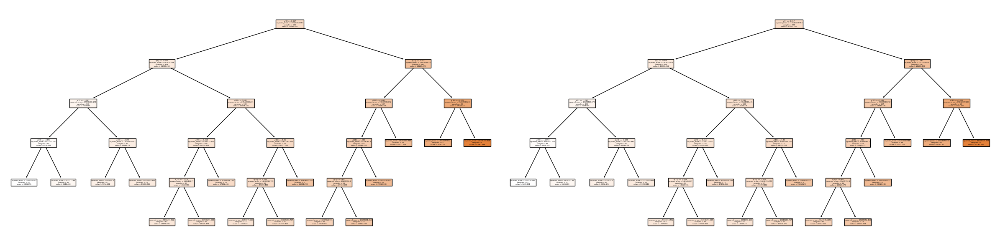

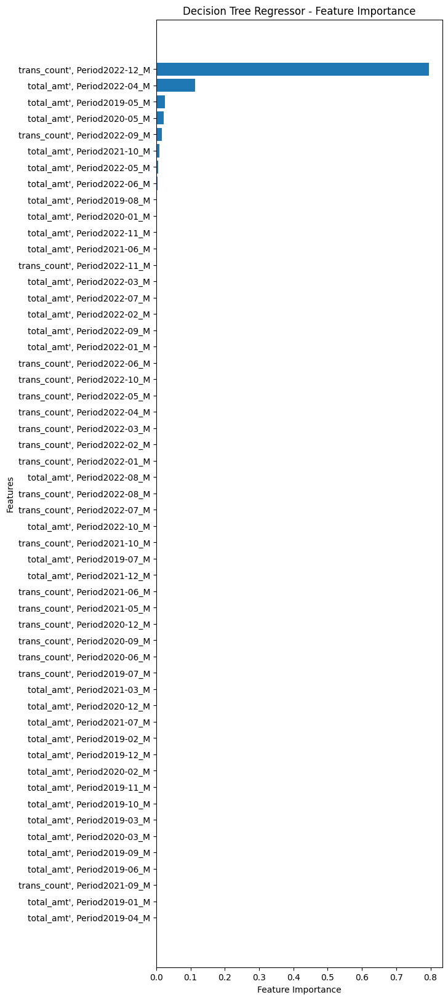

,mae,mse,rmse
DT_Tune_FEATURE2_Train,2640.609970,1.566922e+07,3958.435982
DT_Tune_FEATURE2_Val,2532.673206,1.454901e+07,3814.316998


In [408]:
dt_feature2_tuning = decision_tree_regression_tuning(X_train_feature2, y_train, X_val_feature2, y_val, 'DT_Tune_FEATURE2_Train', 'DT_Tune_FEATURE2_Val')
dt_feature2_tuning

### 4. Decision Tree Regression with Feature Enginerring 1 (Correlation > 0.8)

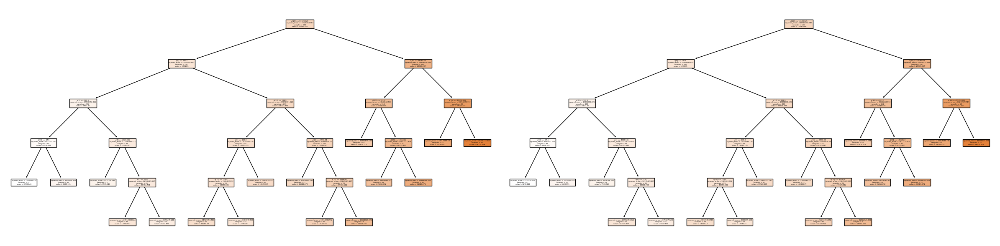

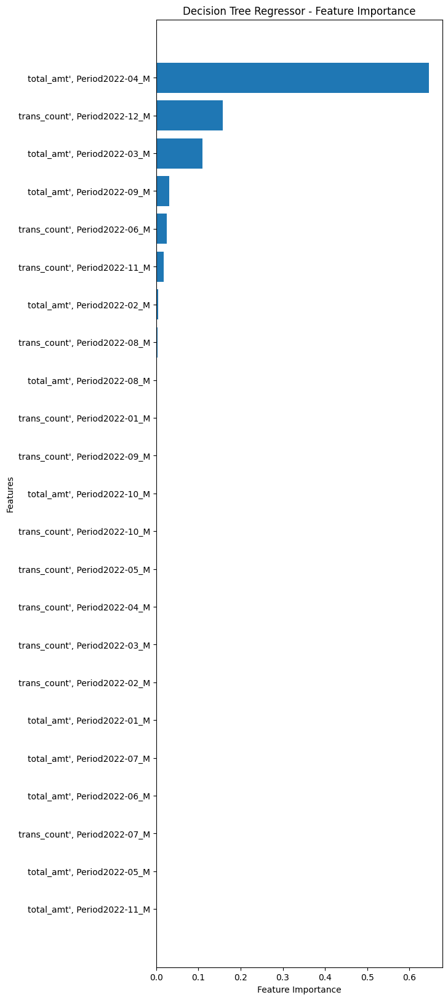

,mae,mse,rmse
DT_Tune_FEATURE3_Train,2634.547381,1.511255e+07,3887.486135
DT_Tune_FEATURE3_Val,2855.303550,1.849346e+07,4300.402255


In [409]:
dt_feature3_tuning = decision_tree_regression_tuning(X_train_feature3, y_train, X_val_feature3, y_val, 'DT_Tune_FEATURE3_Train', 'DT_Tune_FEATURE3_Val')
dt_feature3_tuning

In [410]:
dt_model = pd.concat([dt, dt_feature1, dt_feature2, dt_feature3, dt_tuning, dt_feature1_tuning, dt_feature2_tuning, dt_feature3_tuning])
dt_model

,mae,mse,rmse
Dtregressor_Train,0.000000,0.000000e+00,0.000000
Dtregressor_Val,3022.997923,1.981871e+07,4451.821535
Dtregressor_FEATURE1_Train,0.000000,0.000000e+00,0.000000
Dtregressor_FEATURE1_Val,3142.906175,2.105998e+07,4589.114999
Dtregressor_FEATURE2_Train,0.000000,0.000000e+00,0.000000
Dtregressor_FEATURE2_Val,3379.599290,2.756409e+07,5250.151896
Dtregressor_FEATURE3_Train,0.000000,0.000000e+00,0.000000
Dtregressor_FEATURE3_Val,3090.758525,2.071248e+07,4551.096100
DT_Tune_Train,2428.632887,1.302080e+07,3608.435026
DT_Tune_Val,2377.058551,1.166857e+07,3415.929063


Based on feature importance:  

Top 5 Features  
- **total_amt', Period2022-08_M:** Total amount spending in 2022-08
- **total_count', Period2022-12_M:** Total Transaction in 2022-12
- **total_amt', Period2022-02_M:** Total amount spending in 2022-02
- **total_count', Period2022-01_M:** Total transaction in 2022-01
- **total_amt', Period2022-05_M:** Total amount spending in 2022-05

## VI. Random Forest Regression

In [411]:
from sklearn.ensemble import RandomForestRegressor

### Random Forest Function (Default Hyperparameter)

In [412]:
def random_forest_regressor(X_train, y_train, X_test, y_test, index_train, index_test):
    regressor = RandomForestRegressor(random_state=42).fit(X_train, y_train)
    
    y_preds_train = regressor.predict(X_train)
    y_preds_test = regressor.predict(X_test)

    mse = mean_squared_error(y_train, y_preds_train)
    mae = mean_absolute_error(y_train, y_preds_train)
    rmse = mean_squared_error(y_train, y_preds_train, squared=False)

    rf_train = pd.DataFrame({'mae': mae,
                             'mse': mse,
                             'rmse': rmse},
                            index=[index_train])

    mse = mean_squared_error(y_test, y_preds_test)
    mae = mean_absolute_error(y_test, y_preds_test)
    rmse = mean_squared_error(y_test, y_preds_test, squared=False)

    rf_test = pd.DataFrame({'mae': mae,
                            'mse': mse,
                            'rmse': rmse},
                           index=[index_test])
    
    dt_models = pd.concat([rf_train, rf_test])
    
    feature_importances = regressor.feature_importances_
    sorted_indices = np.argsort(feature_importances)[::-1]
    
    feature_names = X_train.columns.values
    
    sorted_feature_importances = feature_importances[sorted_indices]
    sorted_feature_names = feature_names[sorted_indices]
    
    plt.figure(figsize=(6, 20))
    plt.barh(range(len(sorted_feature_importances)), sorted_feature_importances[::-1], align='center')
    plt.yticks(range(len(sorted_feature_importances)), sorted_feature_names[::-1])
    plt.xlabel("Feature Importance")
    plt.ylabel("Features")
    plt.title("Random Forest Regressor - Feature Importance")
    plt.show()
    
    return dt_models


### 1. Random Forest Regressor with All Features

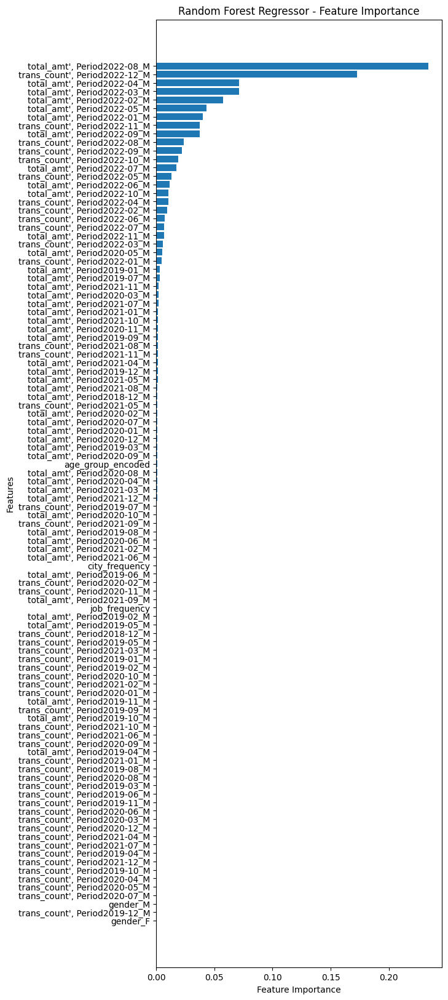

,mae,mse,rmse
RFregressor_Train,952.337505,2.045942e+06,1430.364188
RFregressor_Val,2203.343703,9.785882e+06,3128.239434


In [413]:
rf = random_forest_regressor(X_train, y_train, X_val, y_val, 'RFregressor_Train', 'RFregressor_Val')
rf

### 2. Random Forest Regressor with Feature Enginerring 1 (Correlation > 0.5)

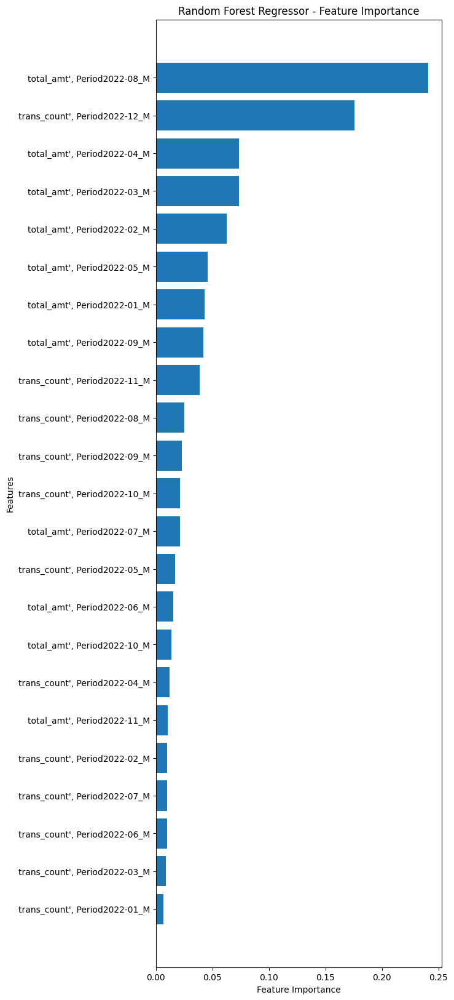

,mae,mse,rmse
RFregressor_FEATURE1_Train,969.471965,2.116189e+06,1454.712785
RFregressor_FEATURE1_Val,2187.242154,9.871982e+06,3141.970979


In [414]:
rf_feature1 = random_forest_regressor(X_train_feature1, y_train, X_val_feature1, y_val, 'RFregressor_FEATURE1_Train', 'RFregressor_FEATURE1_Val')
rf_feature1

### 3. Random Forest Regressor with Feature Enginerring 2 (Correlation > 0.7)

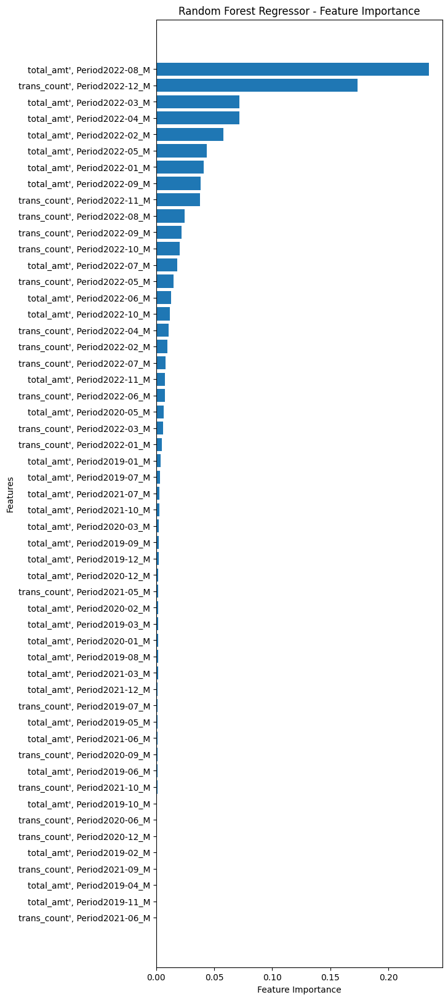

,mae,mse,rmse
RFregressor_FEATURE2_Train,954.917457,2.064596e+06,1436.870097
RFregressor_FEATURE2_Val,2206.446608,9.923375e+06,3150.138845


In [415]:
rf_feature2 = random_forest_regressor(X_train_feature2, y_train, X_val_feature2, y_val, 'RFregressor_FEATURE2_Train', 'RFregressor_FEATURE2_Val')
rf_feature2

### 4. Random Forest Regressor with Feature Enginerring 3 (Correlation > 0.8)

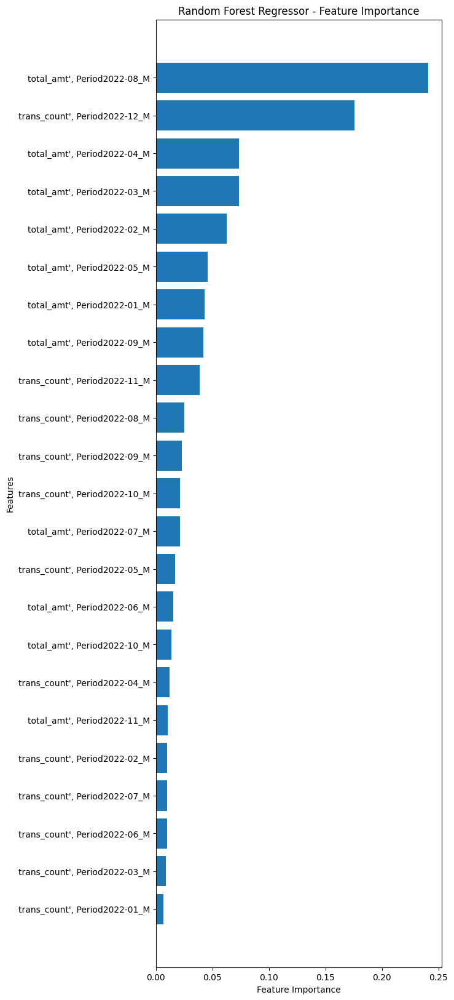

,mae,mse,rmse
RFregressor_FEATURE3_Train,969.307015,2.117008e+06,1454.994201
RFregressor_FEATURE3_Val,2190.343906,9.880833e+06,3143.379168


In [416]:
rf_feature3= random_forest_regressor(X_train_feature3, y_train, X_val_feature3, y_val, 'RFregressor_FEATURE3_Train', 'RFregressor_FEATURE3_Val')
rf_feature3

## Hyperparameter Tuning

## Reduce Overfitting with n_estimators

In [417]:
n_estimators = [2, 5, 10, 20, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in n_estimators:
    regressor = RandomForestRegressor(random_state=42, n_estimators=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_n_estimators = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=n_estimators)
result_n_estimators

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
2,1242.610916,2987.065738,6.745545e+06,1.691260e+07,2597.218708,4112.493373
5,1126.597799,2532.092481,3.257686e+06,1.255253e+07,1804.906078,3542.955581
10,1011.604971,2413.340169,2.431891e+06,1.166108e+07,1559.452098,3414.832983
20,992.655842,2264.938874,2.275209e+06,1.027619e+07,1508.379544,3205.649030
50,982.490668,2226.859317,2.143529e+06,9.939897e+06,1464.079453,3152.760198
100,952.337505,2203.343703,2.045942e+06,9.785882e+06,1430.364188,3128.239434
150,949.291605,2213.789471,2.042899e+06,9.824783e+06,1429.300119,3134.451066
200,944.937466,2229.819886,1.999551e+06,9.881873e+06,1414.054829,3143.544727
250,951.241607,2211.912820,2.018628e+06,9.801909e+06,1420.784127,3130.800055
300,954.003582,2232.031193,2.038388e+06,9.906177e+06,1427.721104,3147.407939


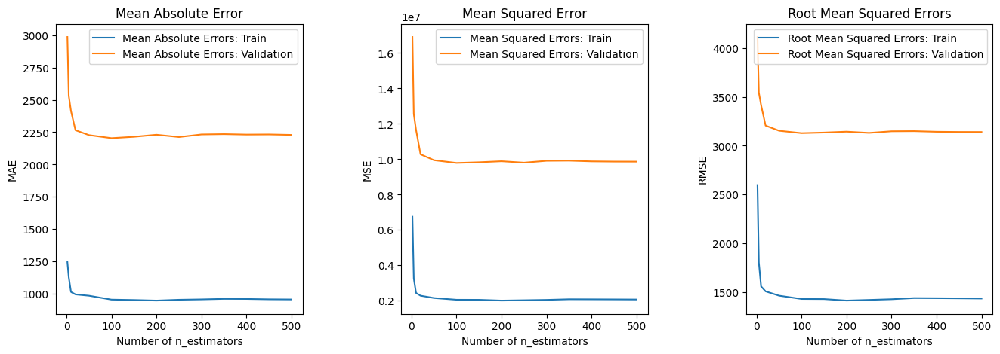

In [418]:
plot_performance(n_estimators, 'Number of n_estimators')

The best n_estimators seems to be 100

## Reduce Overfitting with max_depth

In [419]:
max_depth = [2, 5, 10, 20, 50, 100, 150, 200, None]

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in max_depth:
    regressor = RandomForestRegressor(random_state=42, n_estimators=100, max_depth=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_max_depth = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=max_depth)
result_max_depth

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
2.0,2853.453438,2754.565884,1.660048e+07,1.400695e+07,4074.368843,3742.585952
5.0,1690.756481,2245.768725,5.765749e+06,9.835034e+06,2401.197430,3136.085835
10.0,1005.398492,2173.776943,2.175859e+06,9.752327e+06,1475.079361,3122.871615
20.0,952.083485,2201.015083,2.039902e+06,9.757870e+06,1428.251283,3123.758967
50.0,952.337505,2203.343703,2.045942e+06,9.785882e+06,1430.364188,3128.239434
100.0,952.337505,2203.343703,2.045942e+06,9.785882e+06,1430.364188,3128.239434
150.0,952.337505,2203.343703,2.045942e+06,9.785882e+06,1430.364188,3128.239434
200.0,952.337505,2203.343703,2.045942e+06,9.785882e+06,1430.364188,3128.239434
NaN,952.337505,2203.343703,2.045942e+06,9.785882e+06,1430.364188,3128.239434


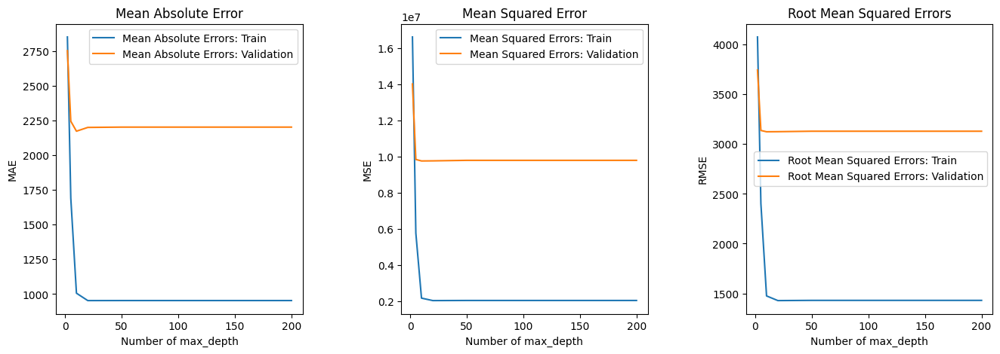

In [420]:
plot_performance(max_depth, 'Number of max_depth')

The best max_depth is 10

## Reduce Overfitting with min_samples_split

In [421]:
min_sample_split = [2, 5, 10, 20, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in min_sample_split:
    regressor = RandomForestRegressor(random_state=42, n_estimators=100, max_depth=10, min_samples_split=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_min_split = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=min_sample_split)
result_min_split

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
2,1005.398492,2173.776943,2.175859e+06,9.752327e+06,1475.079361,3122.871615
5,1082.368610,2210.049998,2.674528e+06,9.757091e+06,1635.398376,3123.634214
10,1259.059300,2199.634626,3.666149e+06,9.799558e+06,1914.719060,3130.424535
20,1551.093075,2218.976044,5.563476e+06,1.016624e+07,2358.702243,3188.454215
50,2127.672054,2385.840523,1.062035e+07,1.120086e+07,3258.888244,3346.769003
100,2764.945928,2620.879736,1.731910e+07,1.446973e+07,4161.621958,3803.910447
150,3403.335781,3160.560872,2.565301e+07,2.200975e+07,5064.880152,4691.454519
200,3421.191917,3190.272747,2.573637e+07,2.232729e+07,5073.102927,4725.176182
250,3682.532220,3524.576999,2.841669e+07,2.477537e+07,5330.730588,4977.486548
300,4345.721384,4182.219041,3.478046e+07,3.153400e+07,5897.495915,5615.514061


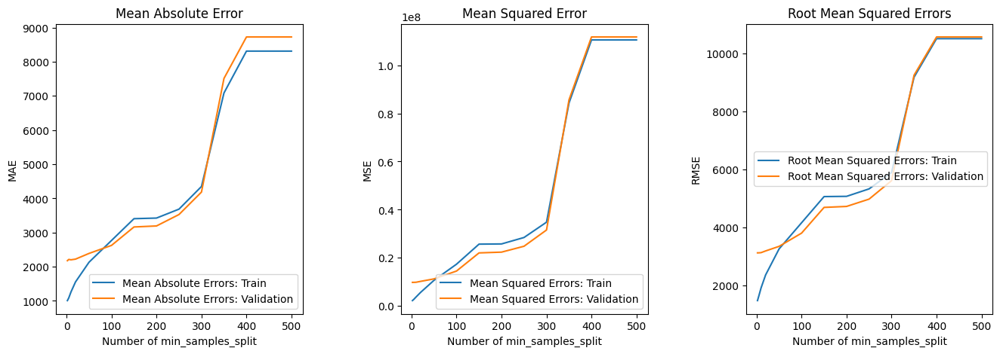

In [422]:
plot_performance(min_sample_split, 'Number of min_samples_split')

The best min_samples_split = 50

## Reduce Overfitting with min_samples_leaf

In [423]:
min_samples_leaf = [2, 5, 10, 20, 50, 100, 150, 200]

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in min_samples_leaf:
    regressor = RandomForestRegressor(random_state=42, n_estimators=100, max_depth=10, min_samples_split=50, min_samples_leaf=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_min_leaf = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=min_samples_leaf)
result_min_leaf

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
2,2141.827379,2404.326973,1.089825e+07,1.124311e+07,3301.249606,3353.075266
5,2163.526677,2390.473206,1.124620e+07,1.119163e+07,3353.536053,3345.389088
10,2204.406785,2410.624136,1.170962e+07,1.135133e+07,3421.932374,3369.173041
20,2287.403270,2442.456604,1.288107e+07,1.176767e+07,3589.020227,3430.404233
50,2831.516772,2692.189520,1.881492e+07,1.592891e+07,4337.617113,3991.104111
100,3654.767197,3382.997994,2.830094e+07,2.419499e+07,5319.863147,4918.840419
150,4771.574255,4476.755346,4.276172e+07,3.719275e+07,6539.244253,6098.585612
200,8309.393546,8723.341999,1.105863e+08,1.118168e+08,10516.003668,10574.347796


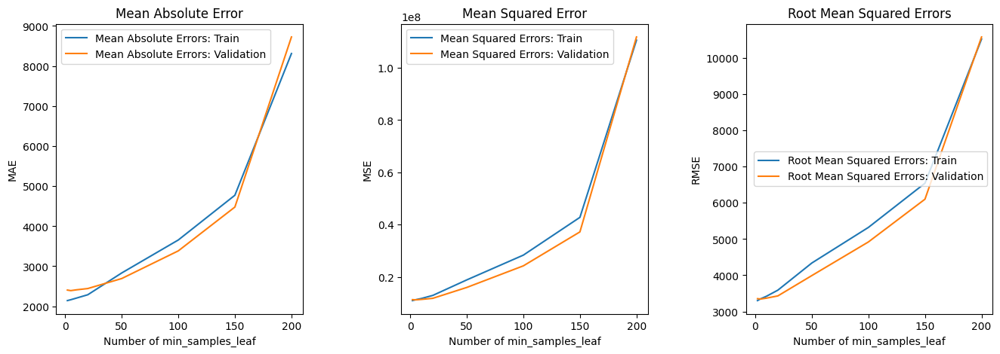

In [424]:
plot_performance(min_samples_leaf, 'Number of min_samples_leaf')

The best min_samples_leaf = 5

## Reduce Overfitting with max_features

In [425]:
max_features = list(range(1, 100))

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in max_features:
    regressor = RandomForestRegressor(random_state=42, n_estimators=100, max_depth=10, min_samples_split=50, min_samples_leaf=5, max_features=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_max_features = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=max_features)
result_max_features

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
1,3477.675432,3591.978705,2.279570e+07,2.285192e+07,4774.484725,4780.368513
2,2996.785590,3130.866184,1.822634e+07,1.775541e+07,4269.231262,4213.717345
3,2697.977342,2804.672885,1.565209e+07,1.409895e+07,3956.271881,3754.857489
4,2563.007738,2634.722391,1.469556e+07,1.278529e+07,3833.478616,3575.652727
5,2455.740146,2482.778473,1.371981e+07,1.141160e+07,3704.025706,3378.106174
6,2395.197031,2415.635187,1.363482e+07,1.134146e+07,3692.535814,3367.708762
7,2365.982644,2405.957880,1.286377e+07,1.087528e+07,3586.610014,3297.768640
8,2357.595785,2358.718720,1.292670e+07,1.091105e+07,3595.372040,3303.187279
9,2339.322455,2363.001359,1.303042e+07,1.093239e+07,3609.767030,3306.416751
10,2288.021607,2313.586664,1.237356e+07,1.044550e+07,3517.606962,3231.950528


In [426]:
result_max_features

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
1,3477.675432,3591.978705,2.279570e+07,2.285192e+07,4774.484725,4780.368513
2,2996.785590,3130.866184,1.822634e+07,1.775541e+07,4269.231262,4213.717345
3,2697.977342,2804.672885,1.565209e+07,1.409895e+07,3956.271881,3754.857489
4,2563.007738,2634.722391,1.469556e+07,1.278529e+07,3833.478616,3575.652727
5,2455.740146,2482.778473,1.371981e+07,1.141160e+07,3704.025706,3378.106174
6,2395.197031,2415.635187,1.363482e+07,1.134146e+07,3692.535814,3367.708762
7,2365.982644,2405.957880,1.286377e+07,1.087528e+07,3586.610014,3297.768640
8,2357.595785,2358.718720,1.292670e+07,1.091105e+07,3595.372040,3303.187279
9,2339.322455,2363.001359,1.303042e+07,1.093239e+07,3609.767030,3306.416751
10,2288.021607,2313.586664,1.237356e+07,1.044550e+07,3517.606962,3231.950528


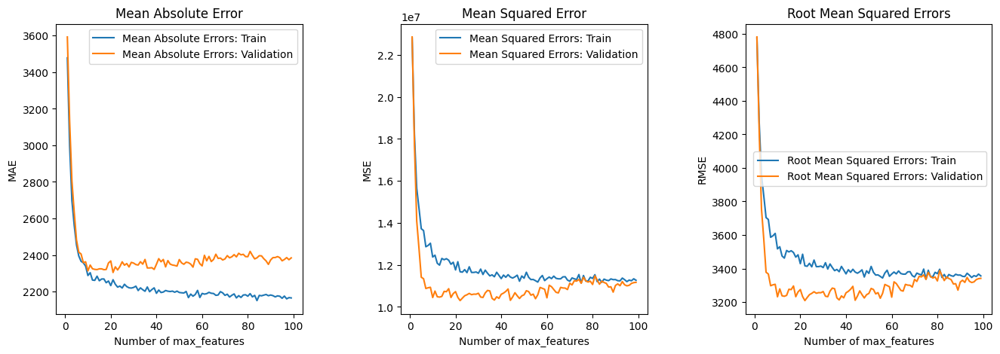

In [427]:
plot_performance(max_features, 'Number of max_features')

The best max_features = 95

## After Hyperparameter Tuning

In [428]:
def random_forest_regressor_tuning(X_train, y_train, X_test, y_test, index_train, index_test):
    regressor = RandomForestRegressor(random_state=42, n_estimators=100, max_depth=10, min_samples_split=50, min_samples_leaf=5, max_features=95).fit(X_train, y_train)
    
    y_preds_train = regressor.predict(X_train)
    y_preds_test = regressor.predict(X_test)

    mse = mean_squared_error(y_train, y_preds_train)
    mae = mean_absolute_error(y_train, y_preds_train)
    rmse = mean_squared_error(y_train, y_preds_train, squared=False)

    rf_train = pd.DataFrame({'mae': mae,
                             'mse': mse,
                             'rmse': rmse},
                            index=[index_train])

    mse = mean_squared_error(y_test, y_preds_test)
    mae = mean_absolute_error(y_test, y_preds_test)
    rmse = mean_squared_error(y_test, y_preds_test, squared=False)

    rf_test = pd.DataFrame({'mae': mae,
                            'mse': mse,
                            'rmse': rmse},
                           index=[index_test])
    
    dt_models = pd.concat([rf_train, rf_test])
    
    feature_importances = regressor.feature_importances_
    sorted_indices = np.argsort(feature_importances)[::-1]
    
    feature_names = X_train.columns.values
    
    sorted_feature_importances = feature_importances[sorted_indices]
    sorted_feature_names = feature_names[sorted_indices]
    
    plt.figure(figsize=(6, 20))
    plt.barh(range(len(sorted_feature_importances)), sorted_feature_importances[::-1], align='center')
    plt.yticks(range(len(sorted_feature_importances)), sorted_feature_names[::-1])
    plt.xlabel("Feature Importance")
    plt.ylabel("Features")
    plt.title("Random Forest Regressor - Feature Importance")
    plt.show()
    
    return dt_models


### 1. Random Forest Regressor with All Features

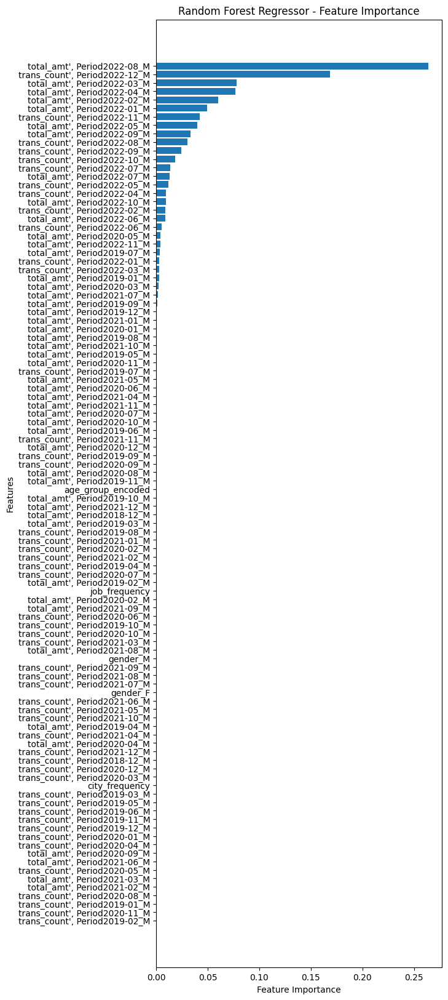

,mae,mse,rmse
RF_Tune_Train,2163.637111,1.120318e+07,3347.114556
RF_Tune_Val,2368.454600,1.100253e+07,3317.006576


In [429]:
rf_tuning = random_forest_regressor_tuning(X_train, y_train, X_val, y_val, 'RF_Tune_Train', 'RF_Tune_Val')
rf_tuning

### 2. Random Forest Regressor with Feature Engineering 1 (Correlation > 0.5)

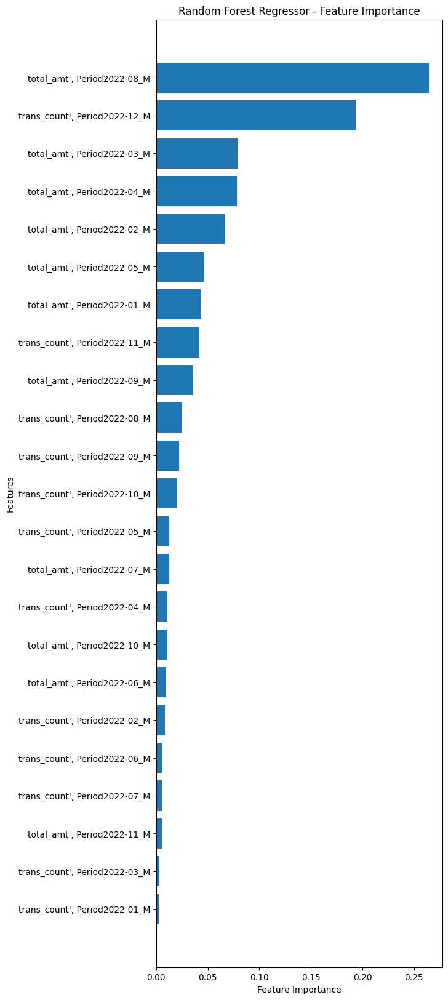

,mae,mse,rmse
RF_Tune_FEATURE1_Train,2217.155423,1.176883e+07,3430.572444
RF_Tune_FEATURE1_Val,2406.069268,1.134822e+07,3368.712046


In [430]:
rf_feature1_tuning = random_forest_regressor_tuning(X_train_feature1, y_train, X_val_feature1, y_val, 'RF_Tune_FEATURE1_Train', 'RF_Tune_FEATURE1_Val')
rf_feature1_tuning

### 3. Random Forest Regressor with Feature Engineering 2 (Correlation > 0.7)

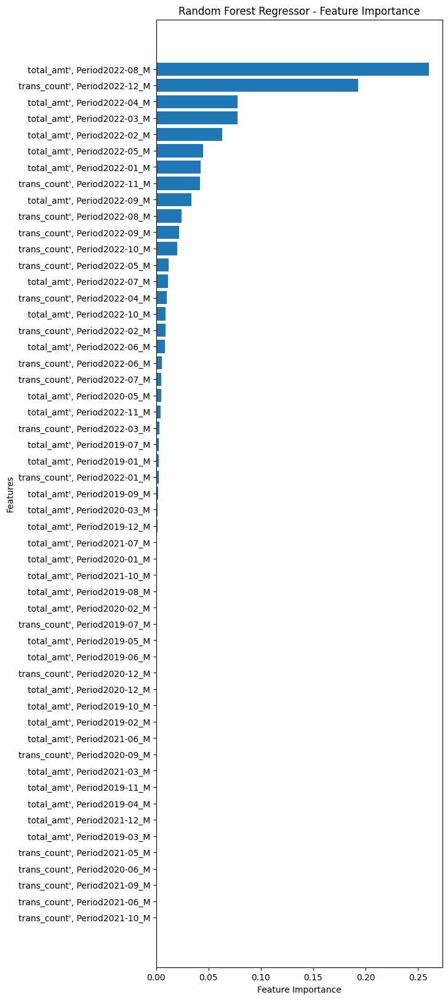

,mae,mse,rmse
RF_Tune_FEATURE2_Train,2162.109950,1.127638e+07,3358.032533
RF_Tune_FEATURE2_Val,2389.063839,1.112963e+07,3336.109354


In [431]:
rf_feature2_tuning = random_forest_regressor_tuning(X_train_feature2, y_train, X_val_feature2, y_val, 'RF_Tune_FEATURE2_Train', 'RF_Tune_FEATURE2_Val')
rf_feature2_tuning

### 4. Random Forest Regressor with Feature Engineering 3 (Correlation > 0.8)

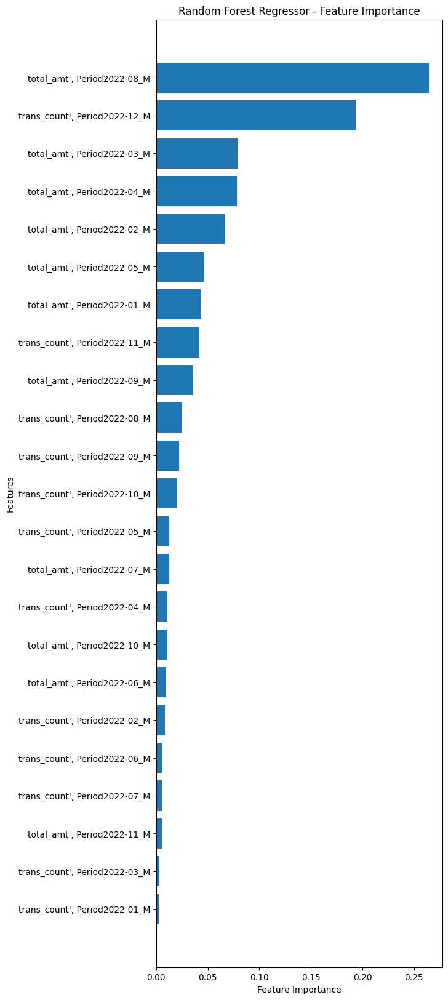

,mae,mse,rmse
RF_Tune_FEATURE3_Train,2216.333066,1.176684e+07,3430.283430
RF_Tune_FEATURE3_Val,2403.261234,1.134797e+07,3368.674639


In [432]:
rf_feature3_tuning = random_forest_regressor_tuning(X_train_feature3, y_train, X_val_feature3, y_val, 'RF_Tune_FEATURE3_Train', 'RF_Tune_FEATURE3_Val')
rf_feature3_tuning

In [433]:
rf_model = pd.concat([rf, rf_feature1, rf_feature2, rf_feature3, rf_tuning, rf_feature1_tuning, rf_feature2_tuning, rf_feature3_tuning])
rf_model

,mae,mse,rmse
RFregressor_Train,952.337505,2.045942e+06,1430.364188
RFregressor_Val,2203.343703,9.785882e+06,3128.239434
RFregressor_FEATURE1_Train,969.471965,2.116189e+06,1454.712785
RFregressor_FEATURE1_Val,2187.242154,9.871982e+06,3141.970979
RFregressor_FEATURE2_Train,954.917457,2.064596e+06,1436.870097
RFregressor_FEATURE2_Val,2206.446608,9.923375e+06,3150.138845
RFregressor_FEATURE3_Train,969.307015,2.117008e+06,1454.994201
RFregressor_FEATURE3_Val,2190.343906,9.880833e+06,3143.379168
RF_Tune_Train,2163.637111,1.120318e+07,3347.114556
RF_Tune_Val,2368.454600,1.100253e+07,3317.006576


## VII. XGBoost

In [434]:
from sklearn.ensemble import GradientBoostingRegressor

### XGBoost Function

In [435]:
def xgboost(X_train, y_train, X_test, y_test, index_train, index_test):
    xgboost_reg = GradientBoostingRegressor().fit(X_train, y_train)
    
    y_preds_train = xgboost_reg.predict(X_train)
    y_preds_test = xgboost_reg.predict(X_test)

    mse = mean_squared_error(y_preds_train, y_train)
    mae = mean_absolute_error(y_preds_train, y_train)
    rmse = mean_squared_error(y_preds_train, y_train, squared=False)

    xgboost_train = pd.DataFrame({'mae': mae,
                                  'mse': mse,
                                  'rmse': rmse},
                                 index=[index_train])

    mse = mean_squared_error(y_preds_test, y_test)
    mae = mean_absolute_error(y_preds_test, y_test)
    rmse = mean_squared_error(y_preds_test, y_test, squared=False)

    xgboost_test = pd.DataFrame({'mae': mae,
                                 'mse': mse,
                                 'rmse': rmse},
                                index=[index_test])

    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))

    # Plot the predicted vs actual target values for the training set
    axes[0].plot(y_train, y_preds_train, 'o',
                 color='orange', label='Predictions')
    axes[0].plot(y_train, y_train, '-', color='red', label='Actual')

    axes[0].set_xlabel('Actual')
    axes[0].set_ylabel('Predicted')
    axes[0].set_title(
        f'{index_train}: Comparison of Actual vs. Predicted Target')

    axes[0].legend()

    axes[1].plot(y_test, y_preds_test, 'o',
                 color='orange', label='Predictions')
    axes[1].plot(y_test, y_test, '-', color='red', label='Actual')

    axes[1].set_xlabel('Actual')
    axes[1].set_ylabel('Predicted')
    axes[1].set_title(
        f'{index_test}: Comparison of Actual vs. Predicted Target')

    axes[1].legend()

    plt.show()

    xgboost_models = pd.concat([xgboost_train, xgboost_test])

    return xgboost_models


### 1. XGBoost with All Features

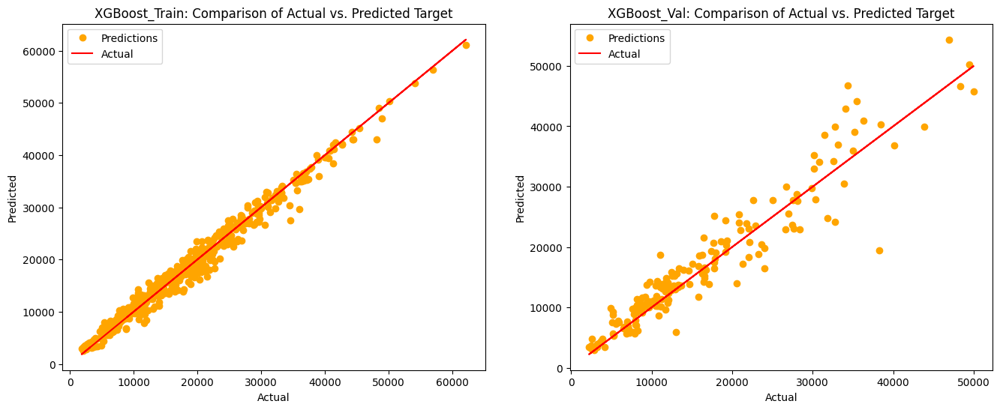

,mae,mse,rmse
XGBoost_Train,1062.784899,2.039445e+06,1428.091324
XGBoost_Val,2370.002169,1.150793e+07,3392.334072


In [436]:
xg = xgboost(X_train, y_train, X_val, y_val, 'XGBoost_Train', 'XGBoost_Val')
xg

### 2. XGBoost Feature Engineering 1 (Correlation >= 0.5)

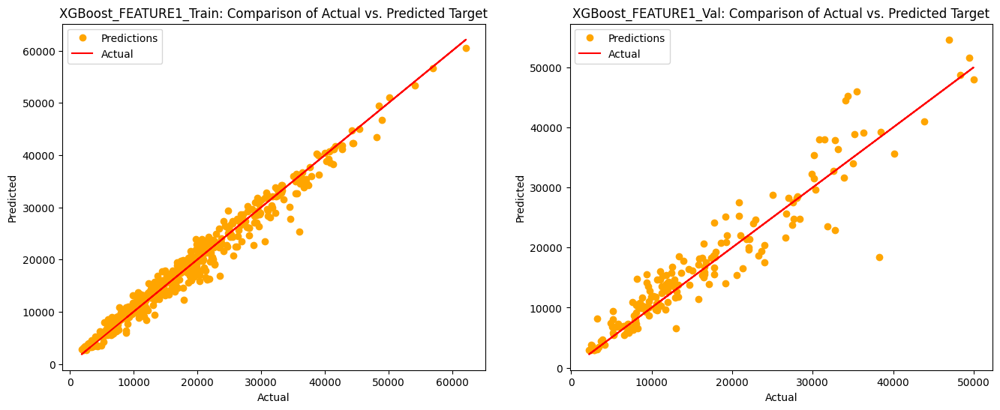

,mae,mse,rmse
XGBoost_FEATURE1_Train,1251.945221,2.949687e+06,1717.465394
XGBoost_FEATURE1_Val,2381.406002,1.206589e+07,3473.598919


In [437]:
xg_feature1 = xgboost(X_train_feature1, y_train, X_val_feature1, y_val, 'XGBoost_FEATURE1_Train', 'XGBoost_FEATURE1_Val')
xg_feature1

### 3. XGBoost Feature Engineering 2 (Correlation >= 0.7)

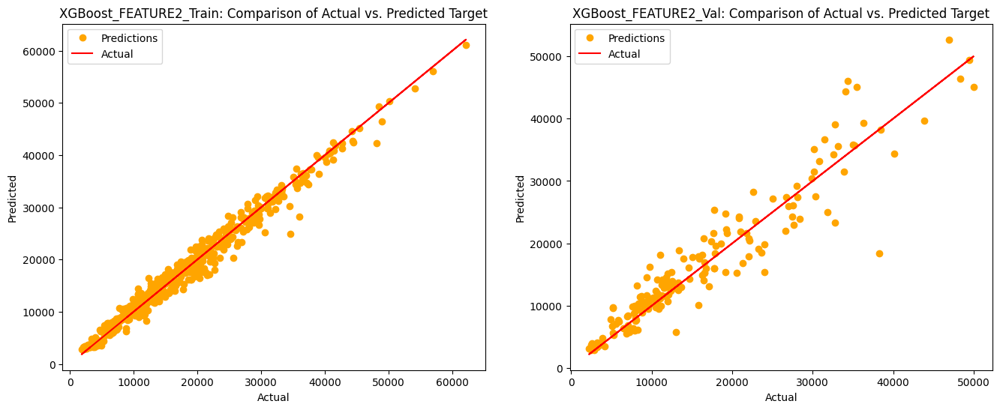

,mae,mse,rmse
XGBoost_FEATURE2_Train,1114.508146,2.326707e+06,1525.354768
XGBoost_FEATURE2_Val,2330.471706,1.189117e+07,3448.357665


In [438]:
xg_feature2 = xgboost(X_train_feature2, y_train, X_val_feature2, y_val, 'XGBoost_FEATURE2_Train', 'XGBoost_FEATURE2_Val')
xg_feature2

### 4. XGBoost Feature Engineering 3 (Correlation >= 0.8)

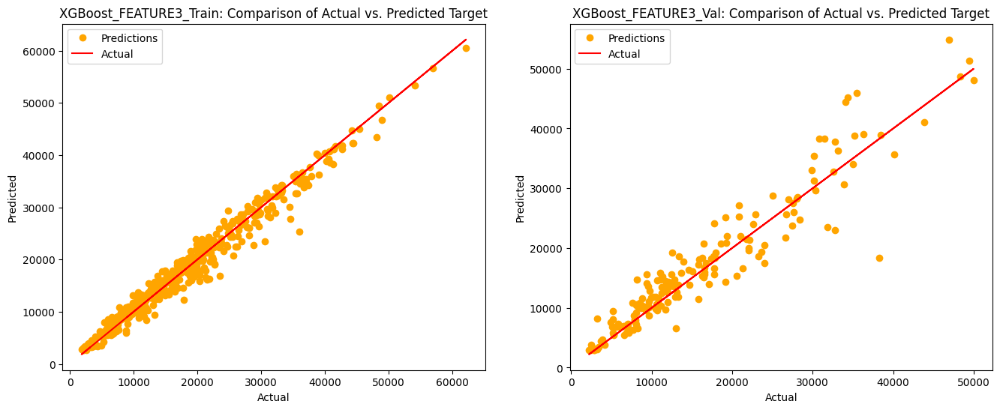

,mae,mse,rmse
XGBoost_FEATURE3_Train,1251.945221,2.949687e+06,1717.465394
XGBoost_FEATURE3_Val,2390.399367,1.221464e+07,3494.944348


In [439]:
xg_feature3 = xgboost(X_train_feature3, y_train, X_val_feature3, y_val, 'XGBoost_FEATURE3_Train', 'XGBoost_FEATURE3_Val')
xg_feature3

## Reduce Overfitting with Learning Rate(eta)

In [440]:
learning_rate = [0.001, 0.01, 0.1, 0.15, 0.2, 0.3, 0.4, 0.5, 1]

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in learning_rate:
    regressor = GradientBoostingRegressor(random_state=42, learning_rate=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_learning_rate = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=learning_rate)
result_learning_rate

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
0.001,7637.367424,7955.366567,9.355801e+07,9.258699e+07,9672.538934,9622.213450
0.010,3905.271359,3931.880791,2.514555e+07,2.310171e+07,5014.533708,4806.423923
0.100,1062.784899,2370.547474,2.039445e+06,1.118598e+07,1428.091324,3344.544623
0.150,774.505422,2394.947704,1.058870e+06,1.093955e+07,1029.014099,3307.499695
0.200,577.790777,2377.679801,5.425335e+05,1.116542e+07,736.568745,3341.469584
0.300,313.369595,2315.334644,1.605535e+05,1.056805e+07,400.691277,3250.854066
0.400,207.376570,2513.281874,7.047907e+04,1.281325e+07,265.478941,3579.559796
0.500,109.283164,2778.266649,2.058349e+04,1.437993e+07,143.469464,3792.087221
1.000,14.395943,3540.087158,3.462054e+02,2.565066e+07,18.606595,5064.647788


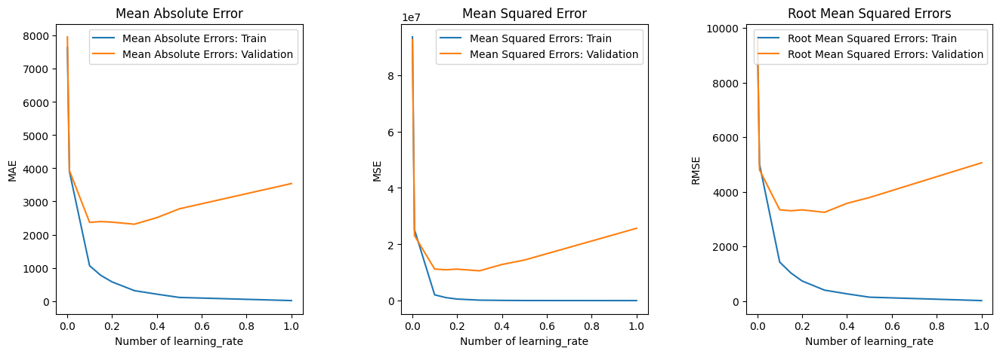

In [441]:
plot_performance(learning_rate, 'Number of learning_rate')

The best learning_rate = 0.3

## Reduce Overfitting with n_estimators

In [442]:
n_estimators = [2, 5, 10, 20, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in n_estimators:
    regressor = GradientBoostingRegressor(random_state=42, learning_rate=0.3, n_estimators=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_n_estimators = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=n_estimators)
result_n_estimators

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
2,4809.319733,4902.595605,3.754147e+07,3.491928e+07,6127.109831,5909.253875
5,2722.114794,2678.412655,1.323165e+07,1.176303e+07,3637.533961,3429.727588
10,1897.562236,2159.119324,7.202624e+06,9.456199e+06,2683.770470,3075.093266
20,1477.064331,2203.857035,4.099596e+06,9.593891e+06,2024.745920,3097.400617
50,792.346707,2321.985863,9.871235e+05,1.065937e+07,993.540893,3264.868751
100,313.369595,2315.334644,1.605535e+05,1.056805e+07,400.691277,3250.854066
150,144.448363,2310.388526,3.341922e+04,1.052438e+07,182.809255,3244.130283
200,65.244271,2314.904790,6.547823e+03,1.055840e+07,80.918621,3249.369306
250,28.543625,2317.728432,1.360793e+03,1.056667e+07,36.888930,3250.641373
300,13.864842,2318.692472,3.140040e+02,1.057643e+07,17.720157,3252.141681


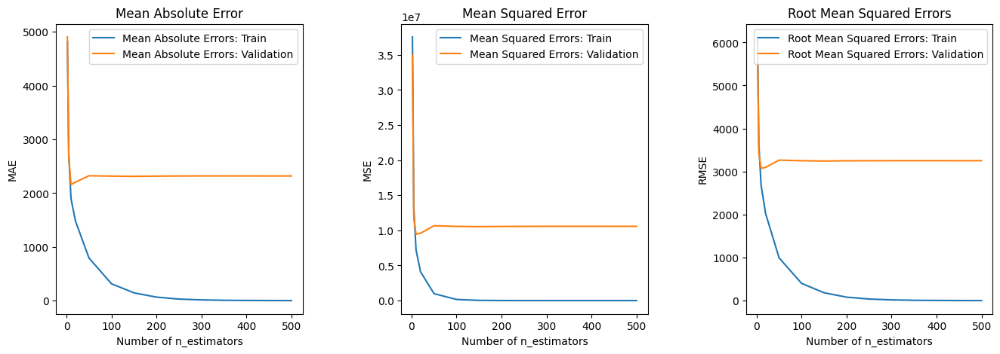

In [443]:
plot_performance(n_estimators, 'Number of n_estimators')

The best n_estimators = 10

## Reduce Overfitting with max_depth

In [444]:
max_depth = list(range(1, 20))

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in max_depth:
    regressor = GradientBoostingRegressor(random_state=42, learning_rate=0.3, n_estimators=10, max_depth=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_max_depth = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=max_depth)
result_max_depth

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
1,3033.378689,3030.005878,1.813618e+07,1.607499e+07,4258.659469,4009.362335
2,2245.290935,2456.658308,1.015635e+07,1.192099e+07,3186.902536,3452.678622
3,1897.562236,2159.119324,7.202624e+06,9.456199e+06,2683.770470,3075.093266
4,1419.249862,2416.253854,3.876618e+06,1.078335e+07,1968.912975,3283.801910
5,999.995619,2472.558868,1.678759e+06,1.165968e+07,1295.669407,3414.628081
6,640.556450,2481.935044,6.283118e+05,1.286504e+07,792.661203,3586.787037
7,470.013470,2493.233621,3.410014e+05,1.262973e+07,583.953221,3553.832539
8,335.950780,2656.258139,1.634064e+05,1.408870e+07,404.235563,3753.492209
9,295.677782,2662.952255,1.278064e+05,1.531712e+07,357.500253,3913.709262
10,248.782725,2598.521394,9.675634e+04,1.453755e+07,311.056815,3812.814487


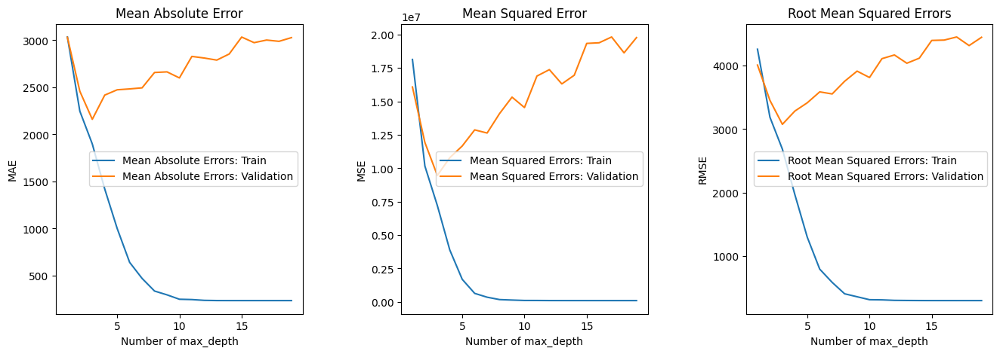

In [445]:
plot_performance(max_depth, 'Number of max_depth')

max_depth = 3

## Reduce Overfitting with min_samples_split

In [446]:
min_sample_split = [2, 5, 10, 20, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in min_sample_split:
    regressor = GradientBoostingRegressor(random_state=42, learning_rate=0.3, n_estimators=10, max_depth=3, min_samples_split=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_min_split = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=min_sample_split)
result_min_split

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
2,1897.562236,2159.119324,7.202624e+06,9.456199e+06,2683.770470,3075.093266
5,1898.441015,2159.119324,7.276317e+06,9.456199e+06,2697.464861,3075.093266
10,1883.888592,2223.960670,7.101234e+06,1.012880e+07,2664.814129,3182.577178
20,1889.719239,2221.183396,7.194737e+06,1.012559e+07,2682.300669,3182.073600
50,1948.157575,2225.500680,7.593369e+06,1.022215e+07,2755.606806,3197.209912
100,2096.057554,2384.481232,9.258531e+06,1.087457e+07,3042.783404,3297.660784
150,2146.909054,2377.424572,9.811386e+06,1.117483e+07,3132.313169,3342.877288
200,2216.788479,2464.222510,1.054611e+07,1.134667e+07,3247.477312,3368.481882
250,2265.416683,2447.021771,1.106094e+07,1.088560e+07,3325.799465,3299.333507
300,2314.863814,2506.663830,1.128385e+07,1.183549e+07,3359.143898,3440.274393


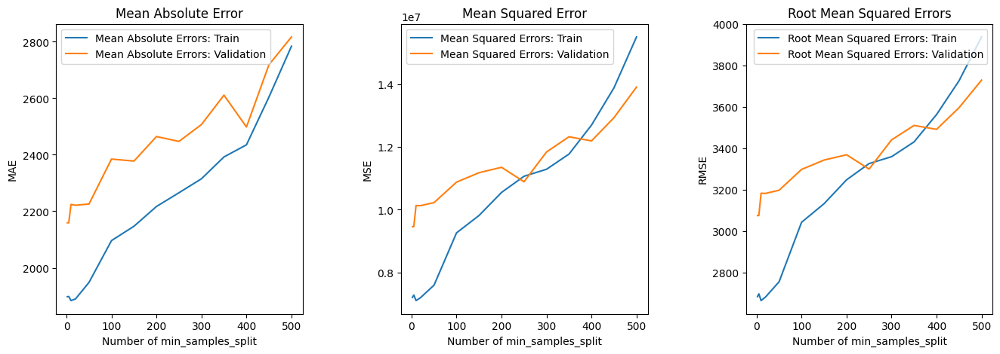

In [447]:
plot_performance(min_sample_split, 'Number of min_samples_split')

The best min_samples_split = 5

## Reduce Overfitting with min_samples_leaf 

In [448]:
min_samples_leaf = [1, 2, 5, 10, 20, 50, 100, 150, 200]

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in min_samples_leaf:
    regressor = GradientBoostingRegressor(random_state=42, learning_rate=0.3, n_estimators=10, max_depth=3, min_samples_split=5, min_samples_leaf=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_min_leaf = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=min_samples_leaf)
result_min_leaf

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
1,1898.441015,2159.119324,7.276317e+06,9.456199e+06,2697.464861,3075.093266
2,1874.827835,2189.431910,7.268464e+06,9.714303e+06,2696.008869,3116.777656
5,1901.049412,2228.578556,7.681601e+06,1.003300e+07,2771.570045,3167.491331
10,1892.191028,2315.660004,7.659879e+06,1.107284e+07,2767.648591,3327.588306
20,2045.176632,2403.469490,8.953731e+06,1.128570e+07,2992.278621,3359.420099
50,2209.278612,2502.178592,1.136276e+07,1.180240e+07,3370.869384,3435.462618
100,2555.035352,2634.764948,1.544620e+07,1.431501e+07,3930.165889,3783.517729
150,3086.782447,3017.239913,2.107417e+07,1.943793e+07,4590.661456,4408.846623
200,3768.490867,3503.482440,2.872838e+07,2.346540e+07,5359.886515,4844.109647


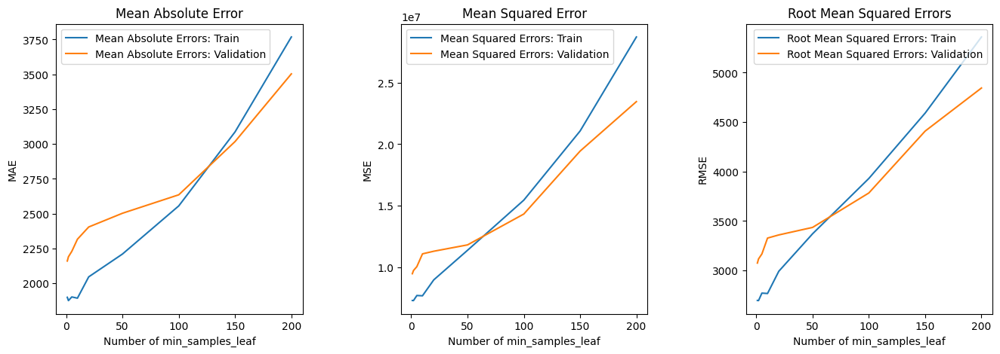

In [449]:
plot_performance(min_samples_leaf, 'Number of min_samples_leaf')

The best min_sampls_leaf = 1

## Reduce Overfitting with max_features

In [450]:
max_features = list(range(1, 70))

train_mae = []
val_mae = []
train_mse = []
val_mse = []
train_rmse = []
val_rmse = []

for k in max_features:
    regressor = GradientBoostingRegressor(random_state=42, learning_rate=0.3, n_estimators=10, max_depth=3, min_samples_split=5, min_samples_leaf=1, max_features=k).fit(X_train, y_train)

    y_preds_train = regressor.predict(X_train)
    y_preds_val = regressor.predict(X_val)

    train_mae.append(mean_absolute_error(y_train, y_preds_train))
    val_mae.append(mean_absolute_error(y_val, y_preds_val))

    train_mse.append(mean_squared_error(y_train, y_preds_train))
    val_mse.append(mean_squared_error(y_val, y_preds_val))

    train_rmse.append(mean_squared_error(y_train, y_preds_train, squared=False))
    val_rmse.append(mean_squared_error(y_val, y_preds_val, squared=False))

result_max_features = pd.DataFrame({'train_mae': train_mae,
                                 'test_mae': val_mae,
                                 'train_mse': train_mse,
                                 'test_mse': val_mse,
                                 'train_rmse': train_rmse,
                                 'test_rmse': val_rmse}, index=max_features)
result_max_features

,train_mae,test_mae,train_mse,test_mse,train_rmse,test_rmse
1,2992.389833,3547.188460,1.554257e+07,2.249611e+07,3942.406301,4743.005916
2,2574.093971,3019.681125,1.261069e+07,1.712248e+07,3551.153268,4137.931304
3,2275.514408,2477.041671,1.013244e+07,1.175872e+07,3183.149577,3429.098479
4,2298.232125,2802.968884,1.082636e+07,1.403492e+07,3290.343262,3746.321089
5,2237.959004,2657.553610,9.969061e+06,1.269945e+07,3157.382059,3563.629201
6,2106.562001,2458.637054,9.242476e+06,1.124718e+07,3040.144036,3353.681524
7,2037.578828,2583.834179,8.646991e+06,1.248260e+07,2940.576657,3533.072451
8,2011.943922,2393.731295,8.419335e+06,1.138662e+07,2901.608961,3374.407129
9,2038.764307,2407.997667,8.009854e+06,1.124592e+07,2830.168597,3353.494102
10,1998.737805,2206.331138,8.201365e+06,8.736292e+06,2863.802593,2955.721868


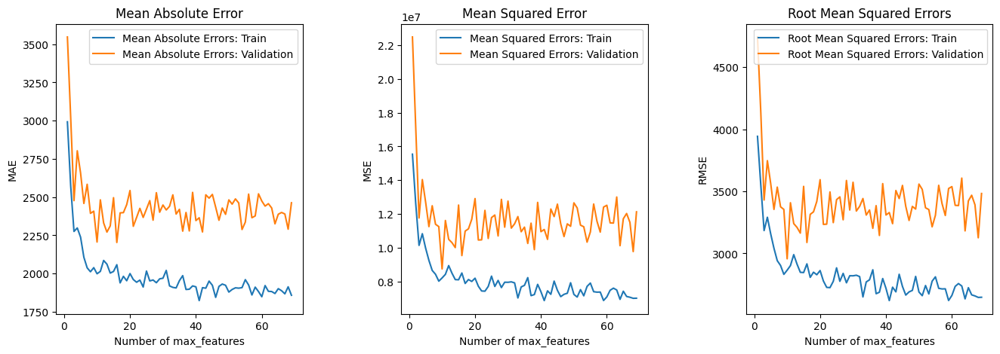

In [451]:
plot_performance(max_features, 'Number of max_features')

The best max_features = 10

## After Hyperparameter Tuning

GradientBoosting Regressor function

In [452]:
def xgboost_tuning(X_train, y_train, X_test, y_test, index_train, index_test):
    xgboost_reg = GradientBoostingRegressor(random_state=42, learning_rate=0.3, n_estimators=10, max_depth=3, min_samples_split=5, min_samples_leaf=1, max_features=10).fit(X_train, y_train)
    
    y_preds_train = xgboost_reg.predict(X_train)
    y_preds_test = xgboost_reg.predict(X_test)

    mse = mean_squared_error(y_preds_train, y_train)
    mae = mean_absolute_error(y_preds_train, y_train)
    rmse = mean_squared_error(y_preds_train, y_train, squared=False)

    xgboost_train = pd.DataFrame({'mae': mae,
                                  'mse': mse,
                                  'rmse': rmse},
                                 index=[index_train])

    mse = mean_squared_error(y_preds_test, y_test)
    mae = mean_absolute_error(y_preds_test, y_test)
    rmse = mean_squared_error(y_preds_test, y_test, squared=False)

    xgboost_test = pd.DataFrame({'mae': mae,
                                 'mse': mse,
                                 'rmse': rmse},
                                index=[index_test])

    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))

    axes[0].plot(y_train, y_preds_train, 'o',
                 color='orange', label='Predictions')
    axes[0].plot(y_train, y_train, '-', color='red', label='Actual')

    axes[0].set_xlabel('Actual')
    axes[0].set_ylabel('Predicted')
    axes[0].set_title(
        f'{index_train}: Comparison of Actual vs. Predicted Target')

    axes[0].legend()

    axes[1].plot(y_test, y_preds_test, 'o',
                 color='orange', label='Predictions')
    axes[1].plot(y_test, y_test, '-', color='red', label='Actual')

    axes[1].set_xlabel('Actual')
    axes[1].set_ylabel('Predicted')
    axes[1].set_title(
        f'{index_test}: Comparison of Actual vs. Predicted Target')

    axes[1].legend()

    plt.show()

    xgboost_models = pd.concat([xgboost_train, xgboost_test])

    return xgboost_models


### 1. XGBoost with All Features

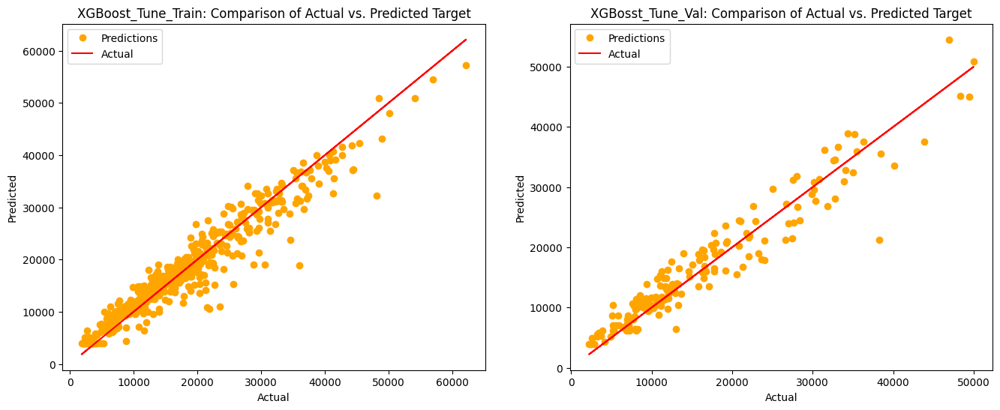

,mae,mse,rmse
XGBoost_Tune_Train,1998.737805,8.201365e+06,2863.802593
XGBosst_Tune_Val,2206.331138,8.736292e+06,2955.721868


In [453]:
xg_tuning = xgboost_tuning(X_train, y_train, X_val, y_val, 'XGBoost_Tune_Train', 'XGBosst_Tune_Val')
xg_tuning

### 2. XGBoost Feature Engineering 1 (Correlation >= 0.5)

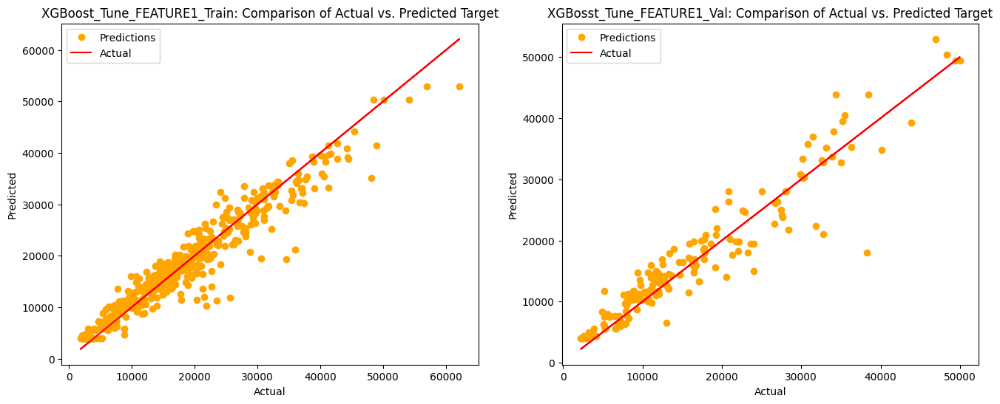

,mae,mse,rmse
XGBoost_Tune_FEATURE1_Train,1987.072765,8.215540e+06,2866.276384
XGBosst_Tune_FEATURE1_Val,2301.942297,1.115216e+07,3339.484760


In [454]:
xg_feature1_tuning = xgboost_tuning(X_train_feature1, y_train, X_val_feature1, y_val, 'XGBoost_Tune_FEATURE1_Train', 'XGBosst_Tune_FEATURE1_Val')
xg_feature1_tuning

### 3. XGBoost Feature Engineering 2 (Correlation >= 0.7)

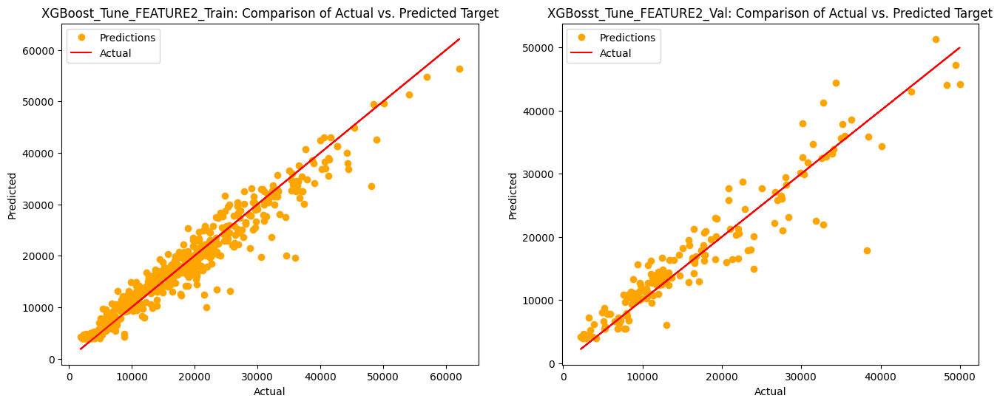

,mae,mse,rmse
XGBoost_Tune_FEATURE2_Train,1940.521103,7.589272e+06,2754.863299
XGBosst_Tune_FEATURE2_Val,2276.243249,1.131108e+07,3363.195538


In [455]:
xg_feature2_tuning = xgboost_tuning(X_train_feature2, y_train, X_val_feature2, y_val, 'XGBoost_Tune_FEATURE2_Train', 'XGBosst_Tune_FEATURE2_Val')
xg_feature2_tuning

### 4. XGBoost Feature Engineering 3 (Correlation >= 0.8)

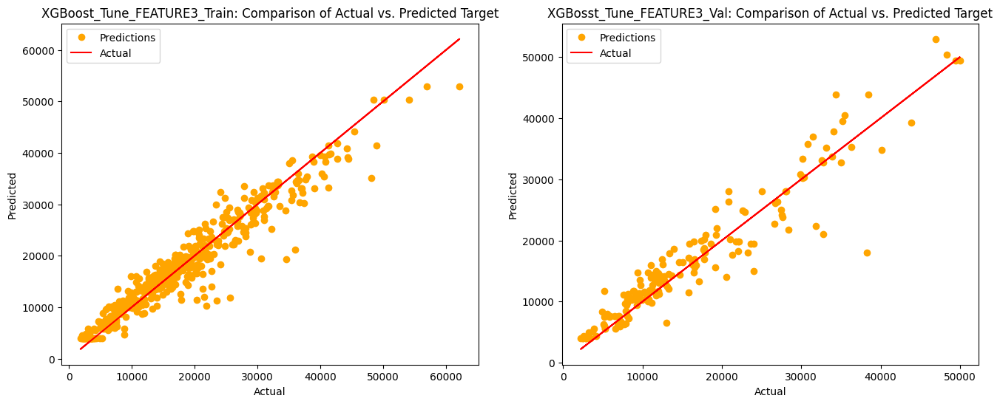

,mae,mse,rmse
XGBoost_Tune_FEATURE3_Train,1987.072765,8.215540e+06,2866.276384
XGBosst_Tune_FEATURE3_Val,2306.776818,1.116378e+07,3341.225026


In [456]:
xg_feature3_tuning = xgboost_tuning(X_train_feature3, y_train, X_val_feature3, y_val, 'XGBoost_Tune_FEATURE3_Train', 'XGBosst_Tune_FEATURE3_Val')
xg_feature3_tuning

## Randmoized Search

In [457]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import uniform, randint

In [458]:
param_grid = {
    'learning_rate': uniform(0.001, 0.3),
    'n_estimators': randint(2, 100),
    'max_depth': randint(1, 5),
    'min_samples_split': [2, 5, 10, 20, 50, 100],
    'min_samples_leaf': [1, 2, 5, 10, 20, 50, 100],
    'max_features': randint(1, 10)
}

In [459]:
gb_regressor = GradientBoostingRegressor()

In [460]:
random_search = RandomizedSearchCV(
    estimator=gb_regressor,
    param_distributions=param_grid,
    n_iter=10,
    scoring='neg_mean_squared_error',
    cv=5,
    random_state=42
)

In [461]:
random_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5, estimator=GradientBoostingRegressor(),
                   param_distributions={'learning_rate': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x386016980>,
                                        'max_depth': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x46ef06230>,
                                        'max_features': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x46ef074f0>,
                                        'min_samples_leaf': [1, 2, 5, 10, 20,
                                                             50, 100],
                                        'min_samples_split': [2, 5, 10, 20, 50,
                                                              100],
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x41bed3550>},
                   random_state=42, scoring='neg_mean_squared_error')

In [462]:
best_params = random_search.best_params_
best_estimator = random_search.best_score_

In [463]:
best_params

{'learning_rate': 0.12095829151457664,
 'max_depth': 4,
 'max_features': 3,
 'min_samples_leaf': 10,
 'min_samples_split': 20,
 'n_estimators': 65}

In [464]:
best_estimator

-15708693.11887255

In [465]:
xg_random = GradientBoostingRegressor(**best_params).fit(X_train, y_train)

In [466]:
y_preds_train = xg_random.predict(X_train)
y_preds_val = xg_random.predict(X_val)

mse = mean_squared_error(y_preds_train, y_train)
mae = mean_absolute_error(y_preds_train, y_train)
rmse = mean_squared_error(y_preds_train, y_train, squared=False)

xgboost_random_train = pd.DataFrame({'mae': mae,
                              'mse': mse,
                              'rmse': rmse},
                             index=['XGBoost_Random_Training'])

mse = mean_squared_error(y_preds_val, y_val)
mae = mean_absolute_error(y_preds_val, y_val)
rmse = mean_squared_error(y_preds_val, y_val, squared=False)

xgboost_random_val = pd.DataFrame({'mae': mae,
                             'mse': mse,
                             'rmse': rmse},
                            index=['XGBoost_Random_Validating'])

xgboost_random = pd.concat([xgboost_random_train, xgboost_random_val])
xgboost_random

,mae,mse,rmse
XGBoost_Random_Training,1407.143534,4.645281e+06,2155.291443
XGBoost_Random_Validating,2326.201974,1.088273e+07,3298.897608


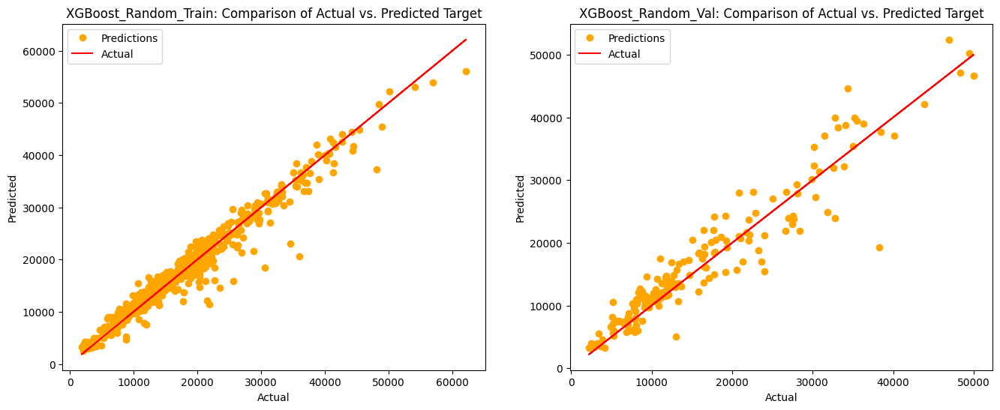

In [467]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))


axes[0].plot(y_train, y_preds_train, 'o',
             color='orange', label='Predictions')
axes[0].plot(y_train, y_train, '-', color='red', label='Actual')

axes[0].set_xlabel('Actual')
axes[0].set_ylabel('Predicted')
axes[0].set_title('XGBoost_Random_Train: Comparison of Actual vs. Predicted Target')

axes[0].legend()

axes[1].plot(y_val, y_preds_val, 'o',
             color='orange', label='Predictions')
axes[1].plot(y_val, y_val, '-', color='red', label='Actual')

axes[1].set_xlabel('Actual')
axes[1].set_ylabel('Predicted')
axes[1].set_title('XGBoost_Random_Val: Comparison of Actual vs. Predicted Target')

axes[1].legend()

In [468]:
xg_model = pd.concat([xg, xg_feature1, xg_feature2, xg_feature3, xg_tuning, xg_feature1_tuning, xg_feature2_tuning, xg_feature3_tuning, xgboost_random])
xg_model

,mae,mse,rmse
XGBoost_Train,1062.784899,2.039445e+06,1428.091324
XGBoost_Val,2370.002169,1.150793e+07,3392.334072
XGBoost_FEATURE1_Train,1251.945221,2.949687e+06,1717.465394
XGBoost_FEATURE1_Val,2381.406002,1.206589e+07,3473.598919
XGBoost_FEATURE2_Train,1114.508146,2.326707e+06,1525.354768
XGBoost_FEATURE2_Val,2330.471706,1.189117e+07,3448.357665
XGBoost_FEATURE3_Train,1251.945221,2.949687e+06,1717.465394
XGBoost_FEATURE3_Val,2390.399367,1.221464e+07,3494.944348
XGBoost_Tune_Train,1998.737805,8.201365e+06,2863.802593
XGBosst_Tune_Val,2206.331138,8.736292e+06,2955.721868


## Compare All models

## 1. Multilinear Regression

In [469]:
multi_model

,mae,mse,rmse
Baseline_Train,8307.422361,1.105862e+08,10515.995863
Baseline_Test,7751.203825,1.000556e+08,10002.777477
MultiLinear_Train,2079.423872,9.298125e+06,3049.282748
MultiLinear_Val,2267.698408,1.029542e+07,3208.647385
MultiLinear_Feature1_Train,2070.482628,9.344101e+06,3056.812263
MultiLinear_Feature1_Val,2230.827601,1.010146e+07,3178.280116
MultiLinear_Feature2_Train,2093.693198,1.030223e+07,3209.708360
MultiLinear_Feature2_Val,2123.415974,9.319224e+06,3052.740411
MultiLinear_Feature3_Train,2278.747762,1.223434e+07,3497.762131
MultiLinear_Feature3_Val,2124.895843,9.739218e+06,3120.772055


## 2. Lasso Regression

In [470]:
lasso_model

,mae,mse,rmse
Lasso_Train,2093.725380,9.353681e+06,3058.378796
Lasso_Val,2279.843057,1.024395e+07,3200.616371
Lasso_FEATURE1_Train,2278.114357,1.223520e+07,3497.885577
Lasso_FEATURE1_Val,2123.981346,9.719629e+06,3117.631893
Lasso_FEATURE2_Train,2092.325287,1.030345e+07,3209.898411
Lasso_FEATURE2_Val,2117.264295,9.286441e+06,3047.366207
Lasso_FEATURE3_Train,2279.940306,1.223561e+07,3497.943503
Lasso_FEATURE3_Val,2127.655356,9.759305e+06,3123.988600


## 3. Ridge Regression

In [471]:
ridge_model

,mae,mse,rmse
Ridge_Train,2061.966576,9.326546e+06,3053.939442
Ridge_Val,2211.667197,9.930921e+06,3151.336341
Ridge_FEATURE1_Train,2274.841596,1.225304e+07,3500.433978
Ridge_FEATURE1_Val,2108.951082,9.600463e+06,3098.461357
Ridge_FEATURE2_Train,2084.101832,1.031979e+07,3212.443623
Ridge_FEATURE2_Val,2102.691899,9.118768e+06,3019.729731
Ridge_FEATURE3_Train,2278.747159,1.223434e+07,3497.762131
Ridge_FEATURE3_Val,2124.893956,9.739202e+06,3120.769408


## 4. ElasticNet Regression

In [472]:
elastic_model

,mae,mse,rmse
Elastic_Train,2284.880425,1.238910e+07,3519.815887
Elastic_Val,2073.707562,8.579011e+06,2928.994854
Elastic_FEATURE1_Train,2469.341627,1.406453e+07,3750.270443
Elastic_FEATURE1_Val,2185.184604,9.342266e+06,3056.512135
Elastic_FEATURE2_Train,2321.397873,1.289433e+07,3590.867219
Elastic_FEATURE2_Val,2109.088513,8.697749e+06,2949.194714
Elastic_FEATURE3_Train,2279.672369,1.223548e+07,3497.925509
Elastic_FEATURE3_Val,2126.979548,9.753365e+06,3123.037799


## 5. Decision Tree Regressor

In [473]:
dt_model

,mae,mse,rmse
Dtregressor_Train,0.000000,0.000000e+00,0.000000
Dtregressor_Val,3022.997923,1.981871e+07,4451.821535
Dtregressor_FEATURE1_Train,0.000000,0.000000e+00,0.000000
Dtregressor_FEATURE1_Val,3142.906175,2.105998e+07,4589.114999
Dtregressor_FEATURE2_Train,0.000000,0.000000e+00,0.000000
Dtregressor_FEATURE2_Val,3379.599290,2.756409e+07,5250.151896
Dtregressor_FEATURE3_Train,0.000000,0.000000e+00,0.000000
Dtregressor_FEATURE3_Val,3090.758525,2.071248e+07,4551.096100
DT_Tune_Train,2428.632887,1.302080e+07,3608.435026
DT_Tune_Val,2377.058551,1.166857e+07,3415.929063


## 6. Random Forest Regressor

In [474]:
rf_model

,mae,mse,rmse
RFregressor_Train,952.337505,2.045942e+06,1430.364188
RFregressor_Val,2203.343703,9.785882e+06,3128.239434
RFregressor_FEATURE1_Train,969.471965,2.116189e+06,1454.712785
RFregressor_FEATURE1_Val,2187.242154,9.871982e+06,3141.970979
RFregressor_FEATURE2_Train,954.917457,2.064596e+06,1436.870097
RFregressor_FEATURE2_Val,2206.446608,9.923375e+06,3150.138845
RFregressor_FEATURE3_Train,969.307015,2.117008e+06,1454.994201
RFregressor_FEATURE3_Val,2190.343906,9.880833e+06,3143.379168
RF_Tune_Train,2163.637111,1.120318e+07,3347.114556
RF_Tune_Val,2368.454600,1.100253e+07,3317.006576


## 7. Gradient Boosting Regressor 

In [475]:
xg_model

,mae,mse,rmse
XGBoost_Train,1062.784899,2.039445e+06,1428.091324
XGBoost_Val,2370.002169,1.150793e+07,3392.334072
XGBoost_FEATURE1_Train,1251.945221,2.949687e+06,1717.465394
XGBoost_FEATURE1_Val,2381.406002,1.206589e+07,3473.598919
XGBoost_FEATURE2_Train,1114.508146,2.326707e+06,1525.354768
XGBoost_FEATURE2_Val,2330.471706,1.189117e+07,3448.357665
XGBoost_FEATURE3_Train,1251.945221,2.949687e+06,1717.465394
XGBoost_FEATURE3_Val,2390.399367,1.221464e+07,3494.944348
XGBoost_Tune_Train,1998.737805,8.201365e+06,2863.802593
XGBosst_Tune_Val,2206.331138,8.736292e+06,2955.721868


The best model is XGboost_Tune:

In [476]:
xg_tuning

,mae,mse,rmse
XGBoost_Tune_Train,1998.737805,8.201365e+06,2863.802593
XGBosst_Tune_Val,2206.331138,8.736292e+06,2955.721868


## Evaluation

### The best performance model of all is Gradient Bossting (with hyper parameter tuning)

In [477]:
xg_regressor = GradientBoostingRegressor(random_state=42, learning_rate=0.3, n_estimators=10, max_depth=3, min_samples_split=5, min_samples_leaf=1, max_features=10).fit(X_train, y_train)

In [478]:
y_preds_train = xg_regressor.predict(X_train)
y_preds_val = xg_regressor.predict(X_val)
y_preds_test = xg_regressor.predict(X_test)

mse = mean_squared_error(y_preds_train, y_train)
mae = mean_absolute_error(y_preds_train, y_train)
rmse = mean_squared_error(y_preds_train, y_train, squared=False)

xgboost_train = pd.DataFrame({'mae': mae,
                              'mse': mse,
                              'rmse': rmse},
                             index=['XGBoost_Training'])

mse = mean_squared_error(y_preds_val, y_val)
mae = mean_absolute_error(y_preds_val, y_val)
rmse = mean_squared_error(y_preds_val, y_val, squared=False)

xgboost_val = pd.DataFrame({'mae': mae,
                             'mse': mse,
                             'rmse': rmse},
                            index=['XGBoost_Validating'])

mse = mean_squared_error(y_preds_test, y_test)
mae = mean_absolute_error(y_preds_test, y_test)
rmse = mean_squared_error(y_preds_test, y_test, squared=False)

xgboost_test = pd.DataFrame({'mae': mae,
                             'mse': mse,
                             'rmse': rmse},
                             index=['XGBoost_Testing'])

xgboost_models = pd.concat([xgboost_train, xgboost_val, xgboost_test])
xgboost_models

,mae,mse,rmse
XGBoost_Training,1998.737805,8.201365e+06,2863.802593
XGBoost_Validating,2206.331138,8.736292e+06,2955.721868
XGBoost_Testing,2589.837132,1.261266e+07,3551.430541


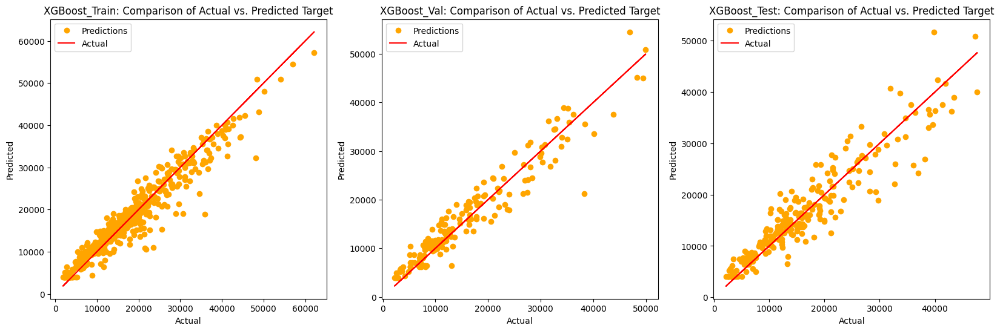

In [479]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 6))


axes[0].plot(y_train, y_preds_train, 'o',
             color='orange', label='Predictions')
axes[0].plot(y_train, y_train, '-', color='red', label='Actual')

axes[0].set_xlabel('Actual')
axes[0].set_ylabel('Predicted')
axes[0].set_title('XGBoost_Train: Comparison of Actual vs. Predicted Target')

axes[0].legend()

axes[1].plot(y_val, y_preds_val, 'o',
             color='orange', label='Predictions')
axes[1].plot(y_val, y_val, '-', color='red', label='Actual')

axes[1].set_xlabel('Actual')
axes[1].set_ylabel('Predicted')
axes[1].set_title('XGBoost_Val: Comparison of Actual vs. Predicted Target')

axes[1].legend()

axes[2].plot(y_test, y_preds_test, 'o',
             color='orange', label='Predictions')
axes[2].plot(y_test, y_test, '-', color='red', label='Actual')

axes[2].set_xlabel('Actual')
axes[2].set_ylabel('Predicted')
axes[2].set_title('XGBoost_Test: Comparison of Actual vs. Predicted Target')

axes[2].legend()

plt.show()


The evaluation was performed using the test sets to assess the models' performance of how well the models generalised to unseen data.

Among the models evaluated, the Gradient Boosting Regressor demonstrated the best performance after hyperparameter tuning. It achieved an MAE of 1998.74, 2206.3, and 2589.84 and an RMSE of 2863.8, 2955.72, and 3551.43 on the training, validation, and testing sets, respectively.

Overall, the evaluation confirmed that the Gradient Boosting Regressor effectively predicted the next month's spending, with low MAE and RMSE values and a strong alignment between predicted and actual values in the scatter plot.